# **A).  CONTEXTO DEL PROYECTO**



### **Visión General de la Planta**
---

La planta se dedica al ensamblaje de dispositivos electrónicos y electromecánicos de alta precisión, cuya calidad es esencial para sectores críticos como el médico y el de telecomunicaciones. En esta instalación, la precisión en el montaje y la fiabilidad de cada componente son vitales, ya que pequeños errores pueden comprometer el funcionamiento de equipos delicados y costosos.



### **La Máquina Crítica y Su Rol**
---

En el corazón de la línea de producción se encuentra una máquina de ensamblaje altamente sofisticada, responsable de manipular y montar componentes clave con tolerancias extremadamente estrictas. Este equipo realiza movimientos precisos y repetitivos, integrando múltiples sistemas (eléctrico, mecánico, hidráulico y estructural) que deben funcionar en perfecta armonía. Debido a la importancia crítica de esta máquina en la cadena productiva, se han llevado a cabo numerosos **experimentos run-to-failure** *(registrados en archivos C7, C8, C9, C11, C13, C14, C15 y C16)* **para capturar la evolución completa del sistema, desde condiciones óptimas hasta el fallo final**.

### **Sistema de Monitorización Integral**
---

Para anticipar y prevenir fallos, la máquina está equipada con un sistema avanzado de sensores que monitoriza 25 señales agrupadas en 8 componentes fundamentales. Cada grupo de sensores aporta información específica y complementaria sobre el funcionamiento general del sistema:

| Componente                                        | Sensores / Parámetros                                                                                                                                                                | Descripción breve                                                             |
|---------------------------------------------------|-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|-------------------------------------------------------------------------------|
| Motor Paso a Paso                                 | L1 (Corriente en Amp), L2 (Velocidad en RPM)                                                                                                                                         | Evalúa la salud del motor y detecta ineficiencias en la transmisión.           |
| Sistema de Torque y Vibración                     | L3 (Par transmitido en Nw), L6 (Vibración en Hz)                                                                                                                                     | Detecta desgaste, desalineaciones y cambios en la estabilidad vibratoria.      |
| Gestión Térmica                                   | L4 (Temperatura interna en ºC), L5 (Gradiente térmico en ºC/min)                                                                                                                       | Señala problemas térmicos que pueden afectar el funcionamiento del sistema.    |
| Monitoreo de la Electrónica de Control            | L7 (Voltaje de alimentación en V), L8 (Estabilidad de la corriente)                                                                                                                  | Garantiza que los circuitos operen en rangos seguros para proteger el sistema.   |
| Sistema de Lubricación y Desgaste Mecánico        | L9 (Flujo del lubricante en l/min), L10 (Condición del lubricante – viscosidad)                                                                                                        | Permite detectar deficiencias en la lubricación que podrían acelerar el desgaste.|
| Sistema Hidráulico / Actuador de Fluido           | A1 (Presión en psi), A2 (Caudal en L/seg), A3 (Temperatura), A4 (Viscosidad), A5 (Calidad del fluido)                                                                                 | Evalúa la dinámica del sistema hidráulico y la integridad del fluido.          |
| Integridad Estructural                            | B1 (Vibración/Aceleración – Eje X), B2 (Eje Y), B3 (Eje Z), B4 (Desplazamiento/deformación), B5 (Frecuencia predominante)                                                               | Detecta vibraciones y posibles deformaciones en la estructura.                 |
| Condiciones Ambientales y Calidad del Fluido      | C1 (Temperatura ambiental), C2 (Humedad relativa), C3 (Presión atmosférica), C4 (Calidad del aire), C5 (pH / Potencial de corrosividad)                                               | Proporciona una visión completa del ambiente, fundamental para ajustes operativos.|



### **Aplicación de la Monitorización y Objetivos del Proyecto**
---


El propósito de esta extensa red de sensores es desarrollar modelos predictivos y de detección de anomalías mediante técnicas de machine learning, especialmente aprendizaje no supervisado. Al analizar los patrones generados por estos 25 parámetros en los experimentos run-to-failure, se puede:

- **Predecir fallos inminentes:**
- **Minimizar paradas y reducción de costes:**
- **Asegurar que la máquina opere en condiciones óptimas**





#**B). SINTESIS DE LAS TÉCNICAS EMPLEADAS Y RESULTADOS OBTENIDOS**

>## ***A continuación se muestra, como introducción a lo que se va a ver en este TFM, la evolución completa de las técnicas empleadas y resultados obtenidos, hasta alcanzar la combinación más óptima.***

---

### Tabla de Evolución

| Etapa | Técnica / Método                                                                                                      | Silhouette Score (Directo)  | Calinski-Harabasz Score | Davies-Bouldin Score | Silhouette (CV Promedio) | Desempeño Predictivo (Accuracy) |
|:-----:|------------------------------------------------------------------------------------------------------------------------|-----------------------------|-------------------------|----------------------|--------------------------|---------------------------------|
| 1     | StandardScaler + K-Means (k = 3)                                                                                       | 0.451                       | 59855                   | 0.825                | 0.460                    | –                               |
| 2     | K-Means++ (diferentes configuraciones de n_init)                                                                       | 0.451                       | –                       | –                    | 0.483                    | –                               |
| 3     | Pruebas iniciales de OPTICS (sin variar preprocesamiento )                                                             | -0.26                       | –                       | –                    | –                        | –                               |
| 4     | Ensemble Clustering (K-Means++ + OPTICS + GMM) sobre dataset reducido                                                  | 0.434                       | 10573                   | 1.144                | 0.529                    | –                               |
| 5     | Ensemble Clustering con Estandarización Agrupada (aplicación de robust scaling; sin imputación de datos faltantes)         | 0.71775                     | 31815.07                | 1.02433              | 0.74069                  | –                               |
| 6     | Modelo Predictivo Auxiliar (RandomForest, validación cruzada agrupada)                                                 | –                           | –                       | –                    | –                        | 97.85%                          |
| 7     | **Código depurado y limpio (Pipeline final para producción)**<br>(SimplyImputer + robust scaling + K-Means++; OPTICS afinado: min_samples = 8, xi = 0.06; GMM; Ensemble Clustering) | 0.9073196255261963          | 119054.94616432405      | 0.28862029322699106   | 0.914974779997927        | 99.87%                         |




### **Explicación de Cada Etapa**
---

**Etapa 1: Preprocesamiento Básico y K-Means (k = 3)**  
Se emplea StandardScaler y K-Means con 3 clusters. Los resultados iniciales muestran un Silhouette Score de 0.451, un Calinski-Harabasz Score de 59,855 y un Davies-Bouldin Score de 0.825. La validación cruzada agrupada arroja en promedio un Silhouette de 0.460. Este es el punto de partida con un preprocesamiento y modelo simples.

**Etapa 2: Mejora con K-Means++**  
Se utiliza la inicialización K-Means++ en distintas configuraciones de n_init. Aunque la métrica directa se mantiene en 0.451, la validación cruzada agrupada mejora levemente hasta 0.483, demostrando mayor estabilidad en la segmentación.

**Etapa 3: Pruebas Iniciales de OPTICS**  
Al aplicar OPTICS sin mejoras adicionales en la limpieza y preprocesamiento, se observa un Silhouette Score negativo (-0.26), lo que evidencia una alta fragmentación y baja cohesión en los clusters locales, reflejando la complejidad inicial de los datos.

**Etapa 4: Primer Ensamble Clustering**  
Se combina K-Means++, OPTICS y GMM sobre un subconjunto reducido del dataset. Los resultados muestran un Silhouette Score directo de 0.434, un Calinski-Harabasz Score de 10,573 y un Davies-Bouldin Score de 1.144; la validación cruzada agrupada arroja un promedio de 0.529. Esto indica que, aunque se explora la diversidad de particiones, aún existe margen de mejora.

**Etapa 5: Ensemble Clustering con Estandarización Agrupada**  
Se mejora el preprocesamiento aplicando un escalado robusto (que mitiga la influencia de outliers) sin incluir la imputación de datos faltantes. Con esta técnica se obtiene un Silhouette Score directo de 0.71775, un Calinski-Harabasz Score de 31815.07 y un Davies-Bouldin Score de 1.02433, mientras que la validación cruzada agrupada mejora a 0.74069. Las mejoras aquí evidencian una mayor cohesión y separación en los clusters.

**Etapa 6: Modelo Predictivo Auxiliar**  
Se entrena un modelo auxiliar (RandomForestClassifier) evaluado mediante validación cruzada agrupada (GroupKFold). El modelo alcanza un rendimiento muy alto, con una precisión promedio de 97.85%, respaldando la calidad de la segmentación conseguida hasta este punto.

**Etapa 7: Código Depurado y Limpio para Producción**  
En la etapa final se depuró el código para incorporar únicamente las técnicas que ofrecieron mejores resultados. Se añade la aplicación temprana de SimplyImputer para reemplazar los valores faltantes, junto con el escalado robusto. En la técnica de clustering se mantienen:
- K-Means++ que sugiere 3 clusters,
- OPTICS afinado con parámetros óptimos (min_samples = 8 y xi = 0.06) que obtuvo un Silhouette Score local de 0.14179 y detectó 199 clusters (excluyendo ruido),
- GMM que confirma la solución de 3 clusters.
Mediante una matriz de coasociación se consolida la solución en 3 clusters. Las métricas finales del ensemble son sobresalientes:
- Silhouette Score directo: 0.90732  
- Calinski-Harabasz Score: 119054.95  
- Davies-Bouldin Score: 0.28862  
Además, la validación cruzada aplicada al ensemble arroja un promedio de Silhouette Score de 0.91497.  
Por último, el modelo predictivo auxiliar entrenado con este pipeline final alcanza una precisión promedio de 99.87% en validación cruzada agrupada. Estos resultados reflejan una mejora sustancial y la implementación de este pipeline en producción garantiza una segmentación y una capacidad predictiva de primer nivel.

---

Esta secuencia ilustra cómo cada mejora en el preprocesamiento, la optimización de los algoritmos de clustering y la depuración del código han contribuido a transformar una metodología inicial con desafíos en la cohesión de clusters a una solución de producción muy fiable y precisa.

# ***Librerías***

In [ ]:
!pip install shap
!pip install tqdm

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import shap
import pickle  # o joblib
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.inspection import permutation_importance
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GroupKFold
from sklearn.cluster import OPTICS
from tqdm import tqdm  # Barra de progreso
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report



# **Fase 0: Preparación y Revisión Inicial**

En este proyecto a medida que se desarrolle se considerará evaluar una o dos estrategias de modelado:

- **Enfoque A (Modelos Individuales):**  
  Se entrenarán modelos separados para cada experimento. En este caso, el hecho de que el Timestamp se reinicie para cada experimento es correcto, ya que se analiza la evolución relativa de cada conjunto de datos de forma independiente.

- **Enfoque B (Modelo Único):**  
  Se desarrollará un único modelo que abarque todos los experimentos. Para ello, es fundamental que la variable identificadora (`experiment_ID`) se mantenga como categórica; de esta forma, el modelo distinguirá entre los distintos experimentos, permitiendo interpretar correctamente el Timestamp relativo (aunque no exista continuidad global).

---
---

El objetivo de este TFM será predecir el fallo del componente en función de sus características físicas (como sensores de temperatura, presión, vibración, etc.). El modelo aprenderá a identificar patrones en las variables y hacer predicciones sin depender de cuándo ocurren en el tiempo.Por lo que no se tratará como un caso de series temporales


**Importar dataset.**


---



In [ ]:
# Importamos el dataset de los 8 experimentos.
C7_1 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C7-1.csv')
C7_2 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C7-2.csv')
C8 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C8.csv')
C9 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C9.csv')
C11 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C11.csv')
C13_1 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C13-1.csv')
C13_2 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C13-2.csv')
C14 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C14.csv')
C15 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C15.csv')
C16 = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/MASTER DATA SCIENCE/Proyecto final/C16.csv')


**Revisar dataframe**


---
Función **`revisar_dataframe`** para obtención de información por cada experimento.


In [ ]:
# Función para revisar cada DataFrame.
def revisar_dataframe(nombre, df):
    print(f"\nRevisando {nombre}:")
    print("Forma:", df.shape)
    print("Info:")
    df.info()
    print("Valores nulos por columna:")
    print(df.isnull().sum())
    print("-" * 40)
    return df

# Creamos un diccionario que mapea cada nombre a su respectivo DataFrame ya cargado
dataframes = {
    'C7_1': C7_1,
    'C7_2': C7_2,
    'C8': C8,
    'C9': C9,
    'C11': C11,
    'C13_1': C13_1,
    'C13_2': C13_2,
    'C14': C14,
    'C15': C15,
    'C16': C16
}

# Revisamos cada DataFrame utilizando la función anterior
for nombre, df in dataframes.items():
    dataframes[nombre] = revisar_dataframe(nombre, df)


Revisando C7_1:
Forma: (16973, 26)
Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16973 entries, 0 to 16972
Data columns (total 26 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Timestamp  16973 non-null  int64  
 1   L_1        16973 non-null  float64
 2   L_2        16973 non-null  float64
 3   A_1        16973 non-null  float64
 4   A_2        16973 non-null  float64
 5   B_1        16973 non-null  float64
 6   B_2        16973 non-null  float64
 7   C_1        16973 non-null  float64
 8   C_2        16973 non-null  float64
 9   A_3        16973 non-null  float64
 10  A_4        16973 non-null  float64
 11  B_3        16973 non-null  float64
 12  B_4        16973 non-null  float64
 13  C_3        16973 non-null  float64
 14  C_4        16973 non-null  float64
 15  L_3        16973 non-null  float64
 16  L_4        16973 non-null  float64
 17  L_5        16973 non-null  float64
 18  L_6        16973 non-null  float64
 19  L_7 

**Eliminación datos faltantes:**


---


>***Comprobamos que C7_2, C14 y C15 tienen datos faltantes***

>*A partir de los resultados, se observa que los registros con datos faltantes en C7_2, C14 y C15 representan aproximadamente el 0.01–0.02% del total de registros de cada experimento. Debido a esta baja proporción, se concluye que eliminar esos registros no alterará significativamente el análisis global.*

> *Para el preprocesamiento puesto en producción, no sabiendo si pueden haber más datos faltantes por fallo en los sensores, etc..., se optará por completar los datos faltantes con la mediana. La mediana es menos propensa a las fluctuaciones propias de un modelo run-to-failure*



In [ ]:
# Eliminamos directamente (in place) los registros con valores faltantes de los
# DataFrames.
C7_2.dropna(inplace=True)
C14.dropna(inplace=True)
C15.dropna(inplace=True)

# Verificamos que se hayan eliminado los valores faltantes.
print("Valores nulos en C7_2 después de dropna:")
print(C7_2.isnull().sum())
print("\nValores nulos en C14 después de dropna:")
print(C14.isnull().sum())
print("\nValores nulos en C15 después de dropna:")
print(C15.isnull().sum())

Valores nulos en C7_2 después de dropna:
Timestamp    0
L_1          0
L_2          0
A_1          0
A_2          0
B_1          0
B_2          0
C_1          0
C_2          0
A_3          0
A_4          0
B_3          0
B_4          0
C_3          0
C_4          0
L_3          0
L_4          0
L_5          0
L_6          0
L_7          0
L_8          0
L_9          0
L_10         0
A_5          0
B_5          0
C_5          0
dtype: int64

Valores nulos en C14 después de dropna:
Timestamp    0
L_1          0
L_2          0
A_1          0
A_2          0
B_1          0
B_2          0
C_1          0
C_2          0
A_3          0
A_4          0
B_3          0
B_4          0
C_3          0
C_4          0
L_3          0
L_4          0
L_5          0
L_6          0
L_7          0
L_8          0
L_9          0
L_10         0
A_5          0
B_5          0
C_5          0
dtype: int64

Valores nulos en C15 después de dropna:
Timestamp    0
L_1          0
L_2          0
A_1          0
A_2        

**Analizados individualmente, los experimentos duplicados C7 y C13 se unifican en uno.**


---



In [ ]:
# Para los experimentos divididos, se procede a concatenarlos.
C7 = pd.concat([dataframes['C7_1'], dataframes['C7_2']], ignore_index=True)
C13 = pd.concat([dataframes['C13_1'], dataframes['C13_2']], ignore_index=True)

# Revisamos nuevamente la integridad de los DataFrames concatenados.
print("\nRevisión de C7 concatenado:")
print(C7.isnull().sum())
print("\nRevisión de C13 concatenado:")
print(C13.isnull().sum())


Revisión de C7 concatenado:
Timestamp    0
L_1          0
L_2          0
A_1          0
A_2          0
B_1          0
B_2          0
C_1          0
C_2          0
A_3          0
A_4          0
B_3          0
B_4          0
C_3          0
C_4          0
L_3          0
L_4          0
L_5          0
L_6          0
L_7          0
L_8          0
L_9          0
L_10         0
A_5          0
B_5          0
C_5          0
dtype: int64

Revisión de C13 concatenado:
Timestamp    0
L_1          0
L_2          0
A_1          0
A_2          0
B_1          0
B_2          0
C_1          0
C_2          0
A_3          0
A_4          0
B_3          0
B_4          0
C_3          0
C_4          0
L_3          0
L_4          0
L_5          0
L_6          0
L_7          0
L_8          0
L_9          0
L_10         0
A_5          0
B_5          0
C_5          0
dtype: int64


**Visualizar el contenido del dataframe**

---

In [ ]:
C7.head(-5)

,Timestamp,L_1,L_2,A_1,A_2,B_1,B_2,C_1,C_2,A_3,...,L_4,L_5,L_6,L_7,L_8,L_9,L_10,A_5,B_5,C_5
0,0,-99.331815,-79.731577,-49.996189,-56.874058,-55.671430,-57.022951,-55.660953,-57.035192,-65.697449,...,-97.704794,-76.934022,-84.311211,-93.610953,-25.438393,-97.509680,-65.524273,-100.000000,-100.000000,-100.000000
1,1,-99.331815,-79.731577,-50.087659,-56.874058,-55.617255,-56.970492,-55.498340,-57.087620,-65.697449,...,-97.704794,-76.934022,-84.311211,-93.610953,-25.438393,-97.509680,-65.524273,-100.000000,-100.000000,-100.000000
2,2,-96.142749,-71.343358,-50.118149,-56.978955,-55.603711,-57.140984,-55.538993,-57.048299,-65.697449,...,-97.402793,-71.781622,-84.311211,-93.610953,-23.687395,-97.509680,-71.139518,-100.000000,-100.000000,-100.000000
3,3,-88.883827,-59.724121,-50.102904,-56.874058,-55.671430,-56.983607,-55.593197,-57.035192,-65.697449,...,-90.033974,-57.552610,-84.311211,-85.852824,-12.887859,-89.826133,-68.708337,-100.000000,-100.000000,-100.000000
4,4,-66.985573,-50.316888,-50.148639,-56.992067,-55.590167,-57.062295,-55.674504,-57.035192,-65.697449,...,-68.244616,-45.735041,-84.311211,-65.288078,-10.575512,-67.853618,-67.030037,-100.000000,-100.000000,-100.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51657,34688,-83.690205,-25.139804,24.841832,-8.057431,10.909460,-9.718033,77.640762,82.580772,-16.383655,...,-83.208755,5.893807,-82.686759,-78.836281,-36.047380,-83.129603,-10.077641,58.730163,33.333333,93.846149
51658,34689,-91.981777,4.212750,24.841832,-13.997246,10.895917,-14.111475,77.627211,82.515237,-20.182988,...,-92.434880,53.912978,-82.686759,-88.790645,-21.900348,-92.286083,45.274880,58.730163,33.333333,69.230769
51659,34690,-94.517844,-5.641854,15.786264,-21.917000,-22.299722,-24.721311,77.573006,82.489023,-47.057455,...,-94.896186,76.200105,-82.686759,-91.086708,-22.631647,-95.049730,69.210258,-8.317846,-100.000000,46.554147
51660,34691,-94.517844,-23.549149,-12.493330,-24.880351,-22.353897,-24.721311,77.640762,82.489023,-46.033961,...,-94.896186,30.217929,-82.686759,-91.143754,-27.060641,-94.791588,16.947690,-100.000000,-100.000000,38.461538


**Estrablecer trazabilidad por cada experimento.**

---

*Se asigna un identificador único a cada experimento para mantener la trazabilidad por experimento*



In [ ]:
# Asignamos un identificador único a cada experimento.
C7['experiment_ID'] = 'C7'
C8['experiment_ID'] = 'C8'
C9['experiment_ID'] = 'C9'
C11['experiment_ID'] = 'C11'
C13['experiment_ID'] = 'C13'
C14['experiment_ID'] = 'C14'
C15['experiment_ID'] = 'C15'
C16['experiment_ID'] = 'C16'



**Convertir a categórico la columna que etiqueta cada experimento, `experiment_ID`**.

---


In [ ]:
C7['experiment_ID'] = C7['experiment_ID'].astype('category')
C8['experiment_ID'] = C8['experiment_ID'].astype('category')
C9['experiment_ID'] = C9['experiment_ID'].astype('category')
C11['experiment_ID'] = C11['experiment_ID'].astype('category')
C13['experiment_ID'] = C13['experiment_ID'].astype('category')
C14['experiment_ID'] = C14['experiment_ID'].astype('category')
C15['experiment_ID'] = C15['experiment_ID'].astype('category')
C16['experiment_ID'] = C16['experiment_ID'].astype('category')

*(Para facilitar futuros trabajos de preporcesamiento se prepara una lista y un diccionario con los experimentos)*

In [ ]:
list_experimentos = ["C7", "C8", "C9", "C11", "C13", "C14", "C15", "C16"]

In [ ]:
dfs = {
     "C7": C7,
     "C8": C8,
     "C9": C9,
     "C11":C11,
     "C13":C13,
     "C14":C14,
     "C15":C15,
     "C16":C16
 }

**Convertir por experimento** **`Timestamp`** **a datetime y extraer Features**

---

De esta manera cada experimento tendrá un análisis temporal coherente según su propio ciclo, respetando el reinicio del tiempo en cada uno y facilitando la extracción de características relevantes para el modelado y la interpretación del comportamiento de los sensores a lo largo del tiempo.


In [ ]:
def extract_time_features(df):
    """
    Convierte la columna 'Timestamp' de int64 a datetime,
    extrae las features de fecha y hora, y calcula 'elapsed_seconds'
    de forma relativa (desde el inicio del experimento, reiniciándose a 0).
    """
    # Convertir 'Timestamp' a datetime (asumiendo unidad milisegundos)
    df['Timestamp'] = pd.to_datetime(df['Timestamp'], unit='ms')

    # Extraer características básicas de la fecha y hora
    df['year'] = df['Timestamp'].dt.year
    df['month'] = df['Timestamp'].dt.month
    df['day'] = df['Timestamp'].dt.day
    df['hour'] = df['Timestamp'].dt.hour
    df['minute'] = df['Timestamp'].dt.minute
    df['second'] = df['Timestamp'].dt.second
    df['day_of_week'] = df['Timestamp'].dt.dayofweek

    # Calcular 'elapsed_seconds' relativo al inicio de cada experimento
    df['elapsed_seconds'] = (df['Timestamp'] - df['Timestamp'].min()).dt.total_seconds()

    return df

In [ ]:
def process_experiments(list_experimentos, dataframe_dict):
    """
    Itera sobre la lista de experimentos y procesa cada DataFrame individualmente.

    Parámetros:
        list_experimentos: iterable de nombres de experimentos.
        dataframe_dict: diccionario que mapea cada nombre de experimento a su respectivo DataFrame.

    Retorna:
        Un nuevo diccionario con los DataFrames procesados.
    """
    processed_dfs = {}
    for exp in list_experimentos:
        if exp in dataframe_dict:
            print(f"Procesando el experimento: {exp}")
            processed_dfs[exp] = extract_time_features(dataframe_dict[exp])
        else:
            print(f"El experimento {exp} no se encontró en el diccionario.")
    return processed_dfs

In [ ]:
# Procesamos cada DataFrame individualmente:
processed_dfs = process_experiments(list_experimentos, dfs)

Procesando el experimento: C7
Procesando el experimento: C8
Procesando el experimento: C9
Procesando el experimento: C11
Procesando el experimento: C13
Procesando el experimento: C14
Procesando el experimento: C15
Procesando el experimento: C16


**Concatenación Final de los 8 exp. en df_monitoring**

---

Se Trabajará con un único DataFrame consolidado, para lo que se concatenarán todos los experimentos en un solo DataFrame

In [ ]:
#Una vez procesados, podemos concatenarlos para obtener df_monitoring final:
df_monitoring = pd.concat(list(processed_dfs.values()), ignore_index=True)

# Asegurar que la variable 'experiment_ID' esté en formato categórico:
df_monitoring['experiment_ID'] = df_monitoring['experiment_ID'].astype('category')

***EL SIGUIENTEE CODIGO SE HA CREADO CON EL MOTIVO DE OBTENER UN DATAFRAME UNIFICADO PARA ADJUNTARLO AL PROYECTO EN VSCode COMO EJEMPLO. EL CÓDIGO .py DE PREPROCESADO PARA PRODUCCION PODRÁ SER EJECUTADO CON ESTE DATAFRAME. LA RAZÓN ES QUE EL MODELO ENTRENADO PARA PRODUCCIÓN RECIBIRA SIEMPRE UNA DATAFRAME YA UNIFICADO, NO UNO POR CADA EXPERIMENTO COMO NACIÓ ESTE PROYECTO.***

In [ ]:
import pandas as pd
import pickle
from google.colab import files

# Supongamos que ya tienes el DataFrame final 'df_monitoring' (la concatenación de los 8 experimentos)
# que fue generado en pasos anteriores.

# Eliminamos las columnas de features temporales que NO se utilizarán en producción,
# ya que ese procesamiento se realiza en la Pipeline de producción.
cols_to_drop = ['year', 'month', 'day', 'hour', 'minute', 'second', 'day_of_week', 'elapsed_seconds']
date_production = df_monitoring.drop(columns=cols_to_drop)

# Convertir la columna Timestamp a tipo datetime y luego a int64 (representa el timestamp en nanosegundos)
date_production['Timestamp'] = pd.to_datetime(date_production['Timestamp']).astype('int64')

# Verificamos las columnas resultantes (opcional)
print("Columnas en date_production:", date_production.columns)

# Guardar el DataFrame en un archivo CSV
date_production.to_csv('date_production.csv', index=False)

# Descargar el archivo (esto funciona en Google Colab)
from google.colab import files
files.download('date_production.csv')





Columnas en date_production: Index(['Timestamp', 'L_1', 'L_2', 'A_1', 'A_2', 'B_1', 'B_2', 'C_1', 'C_2',
       'A_3', 'A_4', 'B_3', 'B_4', 'C_3', 'C_4', 'L_3', 'L_4', 'L_5', 'L_6',
       'L_7', 'L_8', 'L_9', 'L_10', 'A_5', 'B_5', 'C_5', 'experiment_ID'],
      dtype='object')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Comprobación del dataframe unificado**

---

In [ ]:
df_monitoring.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 228412 entries, 0 to 228411
Data columns (total 35 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   Timestamp        228412 non-null  datetime64[ns]
 1   L_1              228412 non-null  float64       
 2   L_2              228412 non-null  float64       
 3   A_1              228412 non-null  float64       
 4   A_2              228412 non-null  float64       
 5   B_1              228412 non-null  float64       
 6   B_2              228412 non-null  float64       
 7   C_1              228412 non-null  float64       
 8   C_2              228412 non-null  float64       
 9   A_3              228412 non-null  float64       
 10  A_4              228412 non-null  float64       
 11  B_3              228412 non-null  float64       
 12  B_4              228412 non-null  float64       
 13  C_3              228412 non-null  float64       
 14  C_4              228

# **Fase 1: Análisis Exploratorio (EDA)**



**Dimensiones**

---


In [ ]:
# Ver las primeras filas y las dimensiones del DataFrame

filas , columnas = df_monitoring.shape
print ('El dataframe "df_monitoring" tiene:\n')
print (f'{filas} filas')
print (f'{columnas} columnas\n')

print('Número de observaciones de cada experimento:\n')
df_monitoring["experiment_ID"].value_counts()  # Distribución de registros por experimento


El dataframe "df_monitoring" tiene:

228412 filas
35 columnas

Número de observaciones de cada experimento:



,count
experiment_ID,
C7,51667
C9,34245
C14,32844
C15,30733
C13,23670
C16,21021
C11,18429
C8,15803


**Información de DataFrame**


---



In [ ]:
df_monitoring.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 228412 entries, 0 to 228411
Data columns (total 35 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   Timestamp        228412 non-null  datetime64[ns]
 1   L_1              228412 non-null  float64       
 2   L_2              228412 non-null  float64       
 3   A_1              228412 non-null  float64       
 4   A_2              228412 non-null  float64       
 5   B_1              228412 non-null  float64       
 6   B_2              228412 non-null  float64       
 7   C_1              228412 non-null  float64       
 8   C_2              228412 non-null  float64       
 9   A_3              228412 non-null  float64       
 10  A_4              228412 non-null  float64       
 11  B_3              228412 non-null  float64       
 12  B_4              228412 non-null  float64       
 13  C_3              228412 non-null  float64       
 14  C_4              228

**Muestra del DataFrame**

---


In [ ]:
df_monitoring.head(-5)

,Timestamp,L_1,L_2,A_1,A_2,B_1,B_2,C_1,C_2,A_3,...,C_5,experiment_ID,year,month,day,hour,minute,second,day_of_week,elapsed_seconds
0,1970-01-01 00:00:00.000,-99.331815,-79.731577,-49.996189,-56.874058,-55.671430,-57.022951,-55.660953,-57.035192,-65.697449,...,-100.000000,C7,1970,1,1,0,0,0,3,0.000
1,1970-01-01 00:00:00.001,-99.331815,-79.731577,-50.087659,-56.874058,-55.617255,-56.970492,-55.498340,-57.087620,-65.697449,...,-100.000000,C7,1970,1,1,0,0,0,3,0.001
2,1970-01-01 00:00:00.002,-96.142749,-71.343358,-50.118149,-56.978955,-55.603711,-57.140984,-55.538993,-57.048299,-65.697449,...,-100.000000,C7,1970,1,1,0,0,0,3,0.002
3,1970-01-01 00:00:00.003,-88.883827,-59.724121,-50.102904,-56.874058,-55.671430,-56.983607,-55.593197,-57.035192,-65.697449,...,-100.000000,C7,1970,1,1,0,0,0,3,0.003
4,1970-01-01 00:00:00.004,-66.985573,-50.316888,-50.148639,-56.992067,-55.590167,-57.062295,-55.674504,-57.035192,-65.697449,...,-100.000000,C7,1970,1,1,0,0,0,3,0.004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
228402,1970-01-01 00:00:21.011,37.145027,8.027836,74.830399,82.600144,55.346380,71.816393,66.528898,71.728160,42.823913,...,84.615385,C16,1970,1,1,0,0,21,3,21.011
228403,1970-01-01 00:00:21.012,-11.176917,-20.156580,74.876134,82.534583,55.305749,71.934426,66.515347,71.806803,40.792432,...,84.615385,C16,1970,1,1,0,0,21,3,21.012
228404,1970-01-01 00:00:21.013,-88.139711,-27.637629,24.887568,-9.906248,10.950091,-13.993443,33.274612,7.398912,-14.569280,...,53.846154,C16,1970,1,1,0,0,21,3,21.013
228405,1970-01-01 00:00:21.014,-91.921033,-33.788990,24.918058,-14.102144,10.950091,-14.085246,-3.828173,-24.726391,-15.158564,...,-100.000000,C16,1970,1,1,0,0,21,3,21.014


**Cabeceras del DataFrame**

---

In [ ]:
pd.DataFrame(df_monitoring.columns)

,0
0,Timestamp
1,L_1
2,L_2
3,A_1
4,A_2
5,B_1
6,B_2
7,C_1
8,C_2
9,A_3


**Tipos de datos**

---

In [ ]:
df_monitoring.dtypes

,0
Timestamp,datetime64[ns]
L_1,float64
L_2,float64
A_1,float64
A_2,float64
B_1,float64
B_2,float64
C_1,float64
C_2,float64
A_3,float64


**Series Temporales - Gráficos de líneas**

---


* *Serie `experimentos` con el nombre que reciben los 8 experimentos*

In [ ]:
# Definimos el orden de los experimentos mediante una serie o lista
experimentos = pd.Series(["C7", "C8", "C9", "C11", "C13", "C14", "C15", "C16"])

* *Diccionario de equipos y parámetros de control*

In [ ]:
# Diccionario que agrupa los parámetros por componente
componentes = {
    "Motor Paso a Paso": ["L_1", "L_2"],                          # Motor Paso a Paso y Parámetros Asociados
    "Torque y Vibración": ["L_3", "L_6"],                         # Sistema de Torque y Vibración
    "Gestión Térmica": ["L_4", "L_5"],                        # Gestión Térmica
    "Electrónica de Control": ["L_7", "L_8"],                        # Monitoreo de la Electrónica de Control
    "Lubricación y Desgaste": ["L_9", "L_10"],                   # Sistema de Lubricación y Desgaste Mecánico
    "Sistema Hidráulico": ["A_1", "A_2", "A_3", "A_4", "A_5"], # Sistema Hidráulico / Actuador de Fluido
    "Integridad Estructural": ["B_1", "B_2", "B_3", "B_4", "B_5"],# Integridad Estructural
    "Condiciones Ambientales": ["C_1", "C_2", "C_3", "C_4", "C_5"]   # Condiciones Ambientales y Calidad del Fluido
}


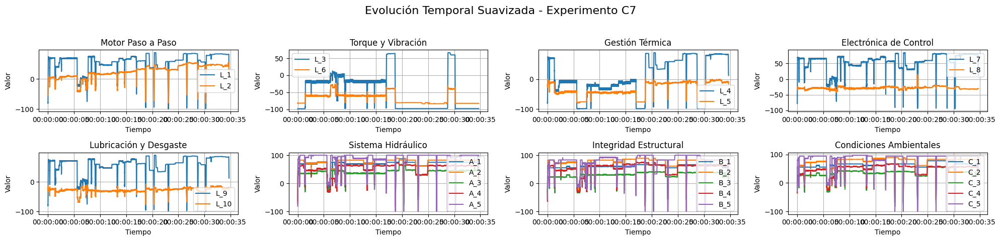

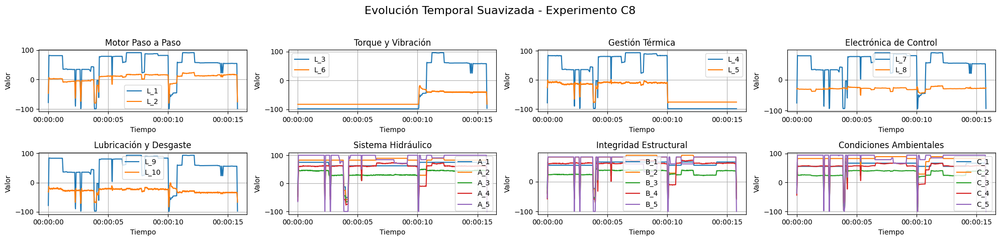

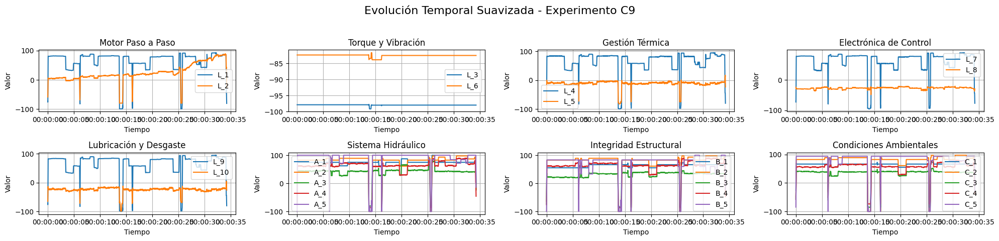

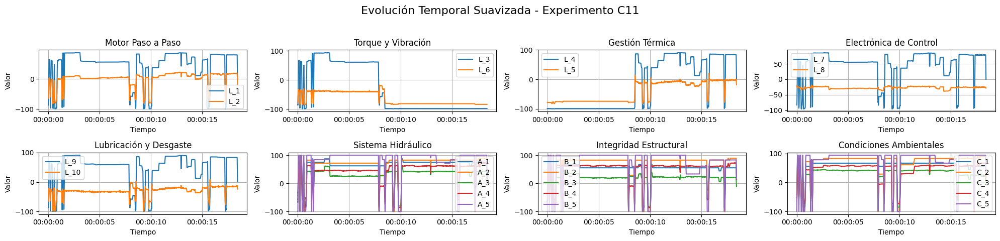

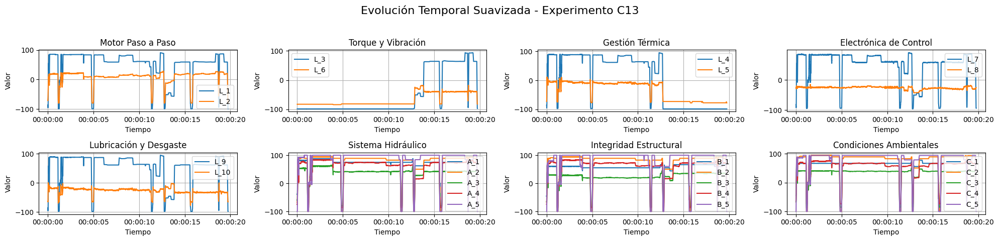

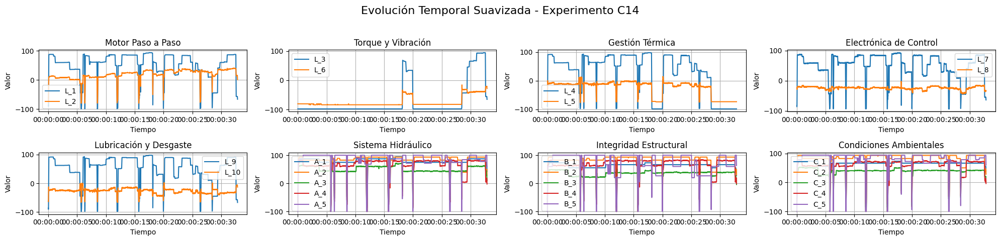

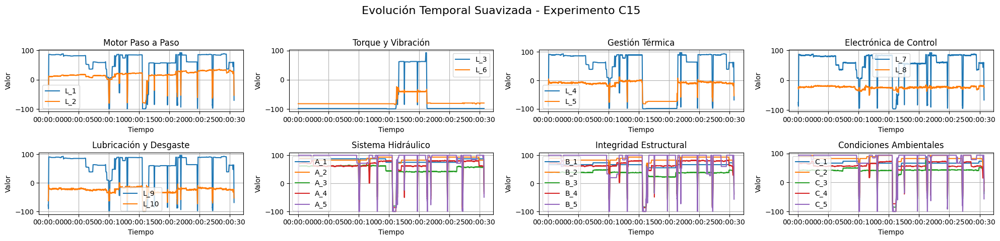

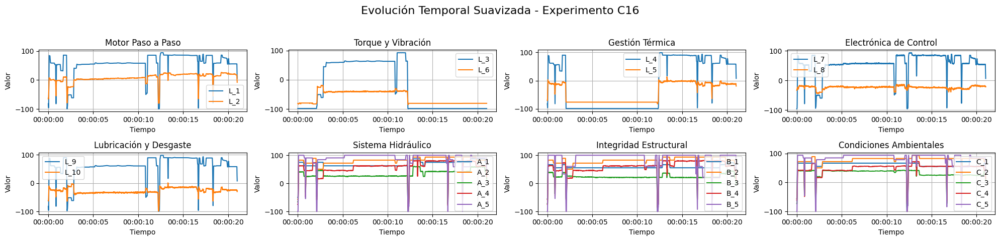

In [ ]:
import matplotlib.pyplot as plt

def plot_time_series_by_experiments_components_smoothed(df, time_col="Timestamp", window=50):
    """
    Para cada experimento en la lista global 'experimentos', genera una figura que contiene
    8 subplots (uno por componente, según lo definido en el diccionario 'componentes') con gráficos
    suavizados (por promedio móvil). La altura global de la figura se ha reducido para que cada
    gráfico sea aproximadamente la mitad de la altura original.

    Parámetros:
      df (DataFrame): DataFrame con los datos de todos los experimentos.
      time_col (str): Columna de tiempo (por defecto "Timestamp").
      window (int): Tamaño de la ventana para el promedio móvil (por defecto 50).
    """
    # Se asume que 'experimentos' es una pd.Series y 'componentes' es un diccionario definidos globalmente.
    for exp_id in experimentos:
        # Filtrar y ordenar los datos para el experimento actual.
        df_exp = df[df["experiment_ID"] == exp_id].copy()
        df_exp.sort_values(by=time_col, inplace=True)

        if df_exp.empty:
            print(f"No se encontraron datos para el experimento {exp_id}.")
            continue

        # Creamos la figura con 2 filas x 4 columnas, reduciendo la altura total de la figura.
        fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 5))
        axes = axes.flatten()  # Convertir el array bidimensional en una lista "plana"

        # Iterar sobre cada componente y asignar cada gráfico a un subplot
        for ax, (comp_name, sensor_list) in zip(axes, componentes.items()):
            for sensor in sensor_list:
                if sensor in df_exp.columns:
                    # Aplicar suavizado con promedio móvil
                    smoothed = df_exp[sensor].rolling(window=window, min_periods=1, center=True).mean()
                    ax.plot(df_exp[time_col], smoothed, label=sensor)
                else:
                    print(f"Advertencia: El sensor {sensor} no se encontró en el experimento {exp_id} para el componente {comp_name}.")
            ax.set_title(comp_name)
            ax.set_xlabel("Tiempo")
            ax.set_ylabel("Valor")
            ax.legend()
            ax.grid(True)

        plt.suptitle(f"Evolución Temporal Suavizada - Experimento {exp_id}", fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

# Llama a la función (asegúrate de que df_monitoring es tu DataFrame de origen)
plot_time_series_by_experiments_components_smoothed(df_monitoring, time_col="Timestamp", window=50)


**CONCLUSION 1.**



>*A partir de lo que se observa en las gráficas suavizadas, se pueden vislumbrar varias opciones interesantes para el modelado futuro. Por ejemplo, dado que cada experimento muestra una evolución temporal propia, resulta fundamental tratar cada uno de ellos de manera diferenciada. Esto se traduce en la recomendación de reiniciar el conteo temporal por experimento y utilizar la **variable** que identifica cada uno `(experiment_ID)` para que el modelo pueda aprender las particularidades de cada ciclo sin confundir patrones.*

>*Además, cuando se notan picos o caídas abruptas en las series, se abren posibilidades claras para la detección de anomalías. Estos cambios bruscos sugieren que, en el preprocesamiento, puede ser muy útil aplicar métodos que permitan identificar outliers o “change points”, de modo que se puedan capturar de forma temprana señales que indiquen el inicio de un fallo o una condición inestable.*

>*Otra recomendación que se desprende de la visión global de las series es aprovechar la consistencia de los patrones a lo largo de experimentos. Esto respalda el uso de modelos como los basados en árboles (por ejemplo, RandomForest), que son capaces de capturar las relaciones complejas y no lineales presentes en los datos sin requerir transformaciones demasiado específicas de las series temporales.*

>*Finalmente, la estabilidad aparente de ciertos patrones visuales invita a considerar técnicas interpretables, como el análisis de Permutation Importance o SHAP, para validar las features derivadas. Estas herramientas no solo confirman que las variables seleccionadas son relevantes, sino que también ayudan a afinar la selección de indicadores clave que alimentarán el modelo predictivo.*





**Análisis estadístico**

---


In [ ]:
df_monitoring.describe()

,Timestamp,L_1,L_2,A_1,A_2,B_1,B_2,C_1,C_2,A_3,...,B_5,C_5,year,month,day,hour,minute,second,day_of_week,elapsed_seconds
count,228412,228412.000000,228412.000000,228412.000000,228412.000000,228412.000000,228412.000000,228412.000000,228412.000000,228412.000000,...,228412.000000,228412.000000,228412.0,228412.0,228412.0,228412.0,228412.0,228412.000000,228412.0,228412.000000
mean,1970-01-01 00:00:13.406851268,55.973554,14.789952,69.121850,76.068734,56.457228,76.740953,59.534030,75.947494,39.139038,...,75.728702,81.812927,1970.0,1.0,1.0,0.0,0.0,12.910486,3.0,13.406851
min,1970-01-01 00:00:00,-100.000000,-100.000000,-100.000000,-100.000000,-100.000000,-100.000000,-100.000000,-100.000000,-100.000000,...,-100.000000,-100.000000,1970.0,1.0,1.0,0.0,0.0,0.000000,3.0,0.000000
25%,1970-01-01 00:00:05.909000,55.717540,6.673294,74.723683,82.534583,55.319293,82.596721,66.420489,82.449702,38.125145,...,83.333333,84.615385,1970.0,1.0,1.0,0.0,0.0,5.000000,3.0,5.909000
50%,1970-01-01 00:00:12.254000,60.652999,15.807133,74.830399,82.613256,66.330331,82.649180,66.515347,82.541451,43.056525,...,83.333333,93.846149,1970.0,1.0,1.0,0.0,0.0,12.000000,3.0,12.254000
75%,1970-01-01 00:00:19.365000,83.037206,27.190257,74.906624,89.051334,66.425137,89.101639,66.569551,88.950783,47.259052,...,100.000000,93.846149,1970.0,1.0,1.0,0.0,0.0,19.000000,3.0,19.365000
max,1970-01-01 00:00:34.697000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,100.000000,100.000000,1970.0,1.0,1.0,0.0,0.0,34.000000,3.0,34.697000
std,NaN,42.782118,24.470182,29.770464,33.009632,26.990088,32.678891,27.192271,32.434466,25.561299,...,41.970740,38.094381,0.0,0.0,0.0,0.0,0.0,8.989239,0.0,8.989864


**Comprobación de registros redundantes**

---

In [ ]:
print("Número de registros duplicados:", df_monitoring.duplicated().sum())


Número de registros duplicados: 0


**Revisión de valores nulos**

---


In [ ]:
print("Valores nulos por columna:")
df_monitoring.isnull().sum()


Valores nulos por columna:


,0
Timestamp,0
L_1,0
L_2,0
A_1,0
A_2,0
B_1,0
B_2,0
C_1,0
C_2,0
A_3,0


**Gráficos exploratorios.**

---

**Análisis de la Distribución de Registros por Experimento**


<ipython-input-29-2566972e205c>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_monitoring, x='experiment_ID', palette="viridis")


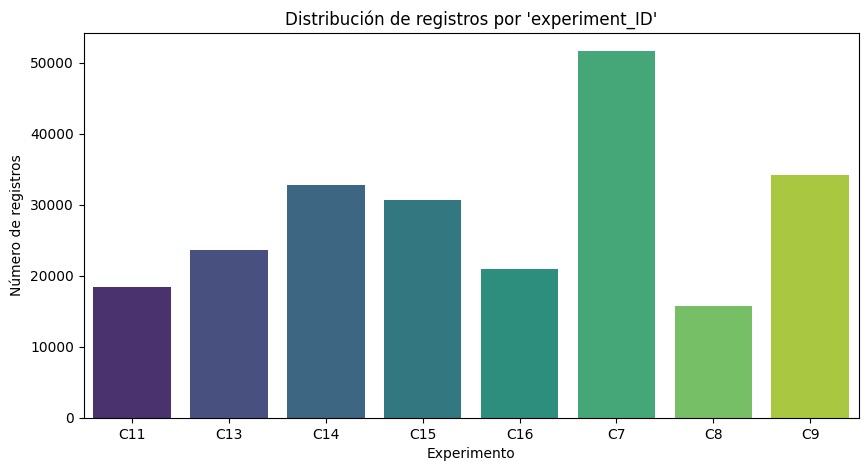

In [ ]:
plt.figure(figsize=(10, 5))
sns.countplot(data=df_monitoring, x='experiment_ID', palette="viridis")
plt.title("Distribución de registros por 'experiment_ID'")
plt.xlabel("Experimento")
plt.ylabel("Número de registros")
plt.show()


>**CONCLUSION 2.**


>La gráfica evidencia que, pese a las diferencias entre componentes, no es adecuado aplicar un balanceo general, ya que cada sensor muestra dinámicas propias que exigen un tratamiento individual para lograr un modelado predictivo consistente.

**Visualización de la Distribución de las lecturas de los experimentos por cada componente**


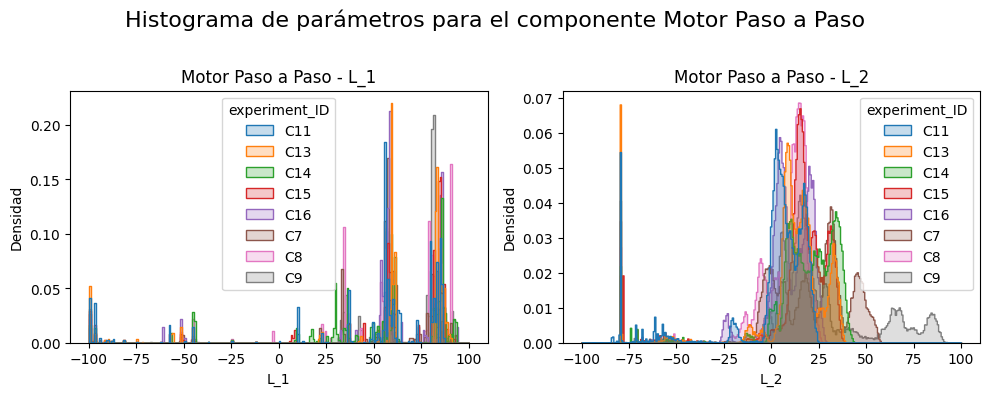

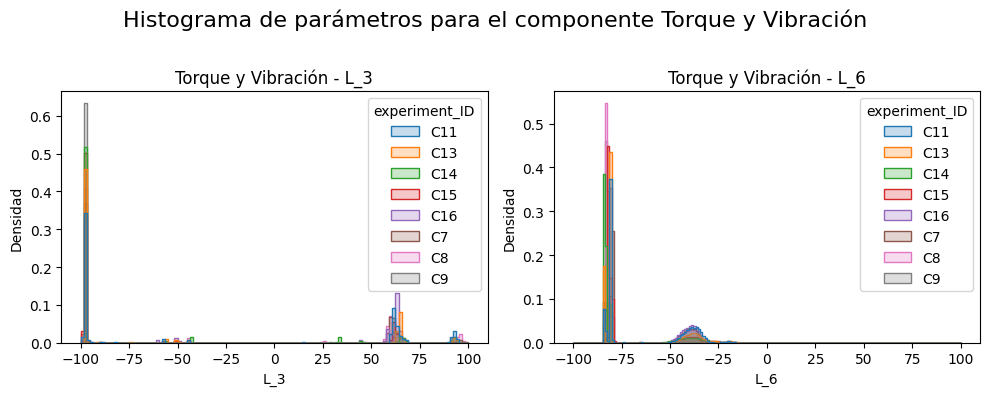

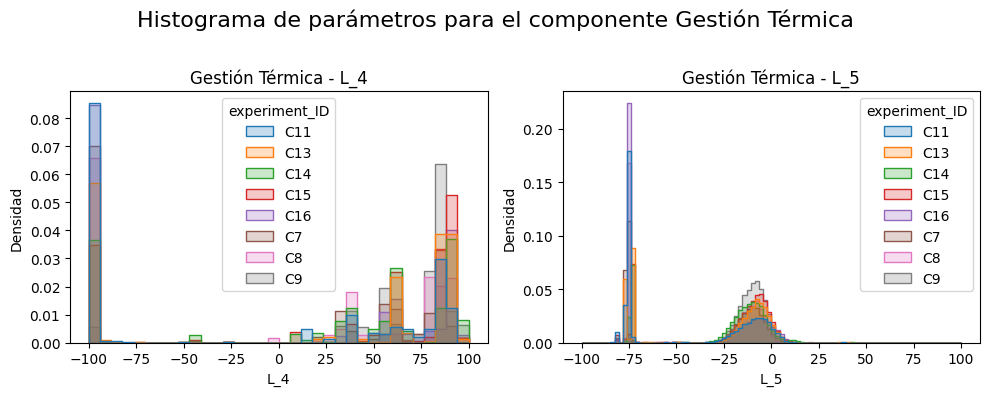

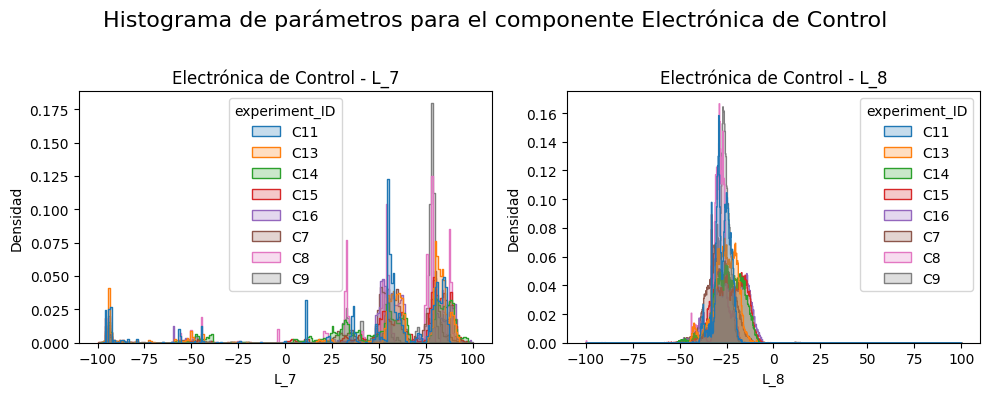

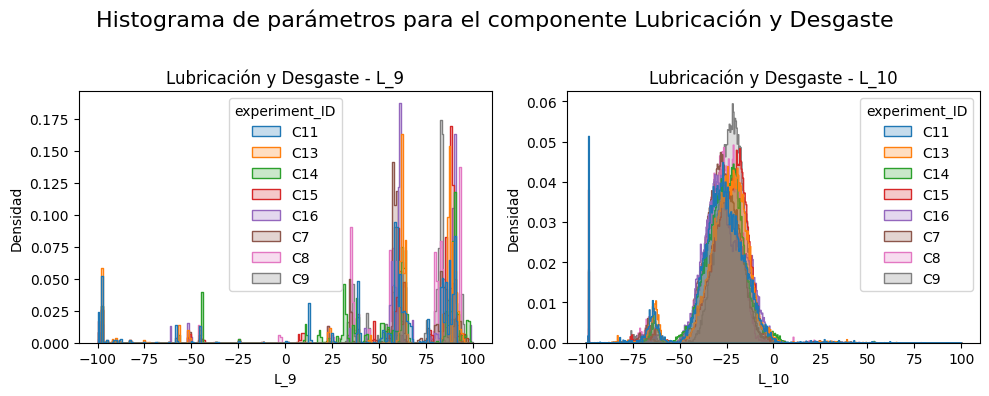

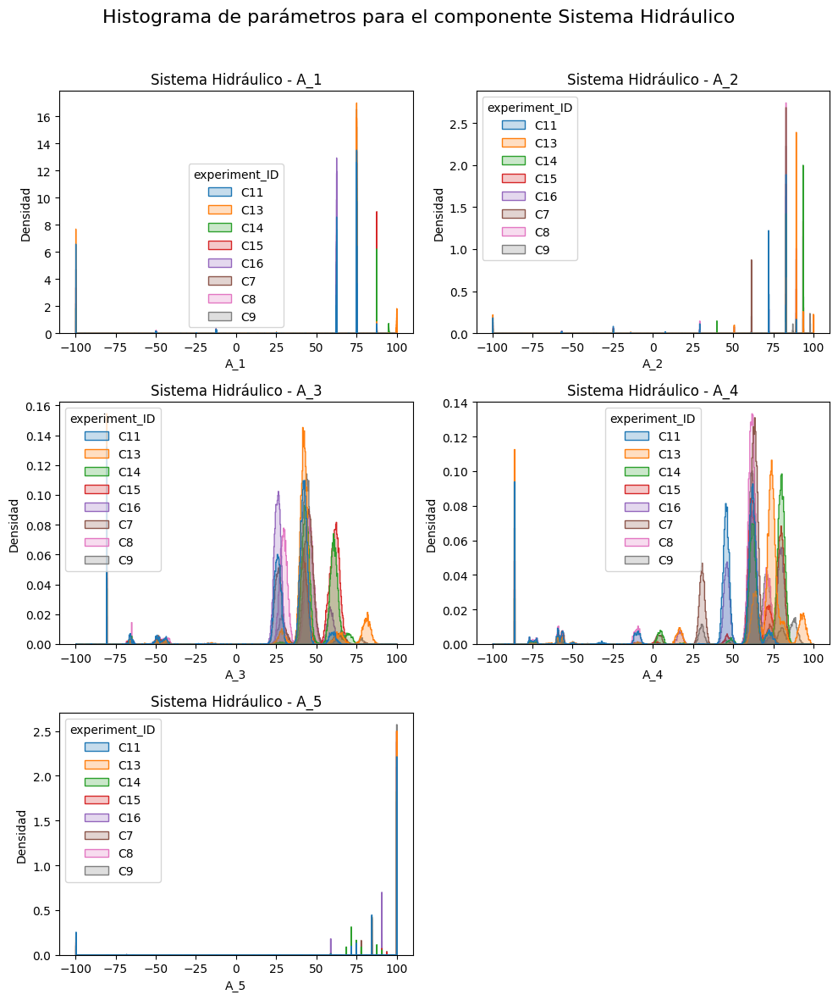

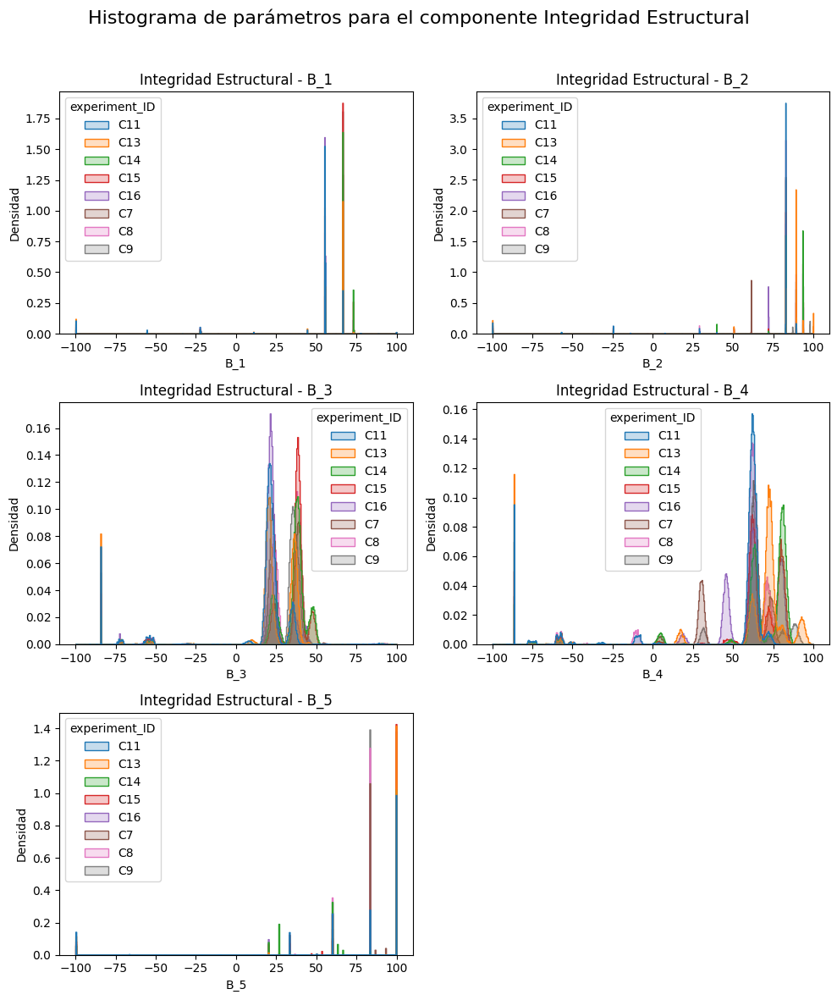

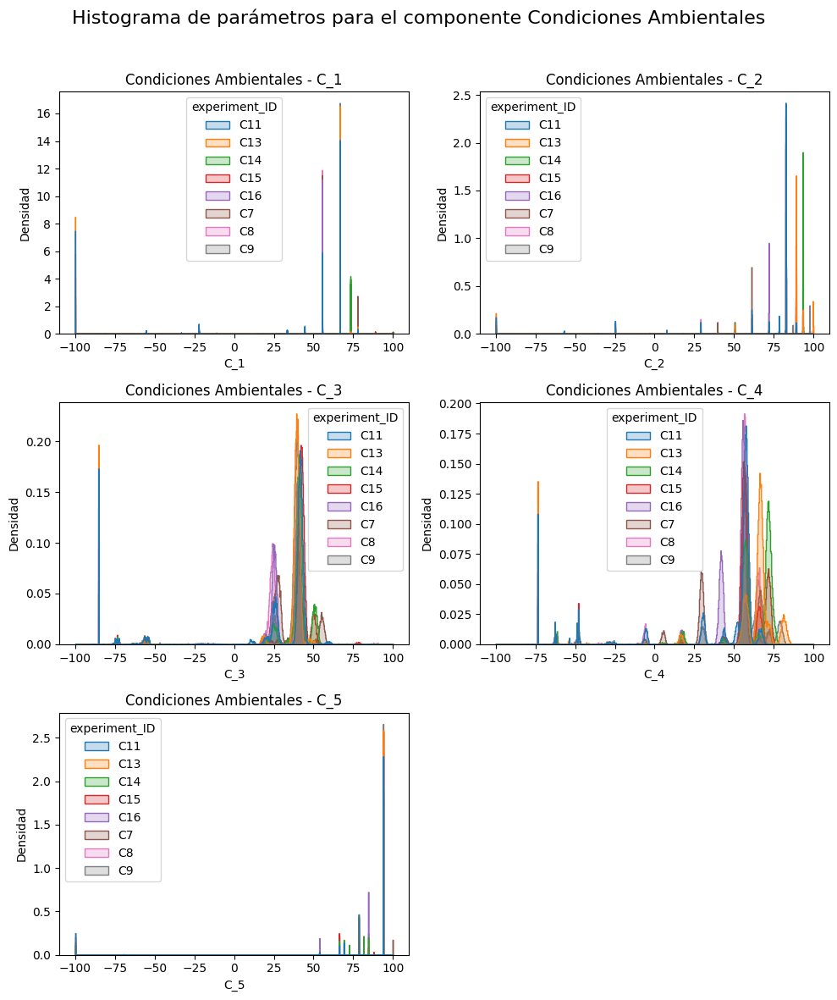

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Iterar sobre cada componente del diccionario
for comp, params in componentes.items():
    n_params = len(params)
    n_cols = 2  # Ahora se muestran 2 columnas
    n_rows = math.ceil(n_params / n_cols)  # Número de filas necesarias

    # Crear una figura con n_rows x 2 subplots, manteniendo la altura original de 4 unidades por fila.
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(10, 4 * n_rows))

    # Asegurarse que 'axes' se trate como lista plana
    if n_rows * n_cols > 1:
        axes = axes.flatten()
    else:
        axes = [axes]

    # Para cada parámetro, crear el histograma usando los datos, separándolo por experimentos.
    for ax, param in zip(axes, params):
        sns.histplot(
            data=df_monitoring,
            x=param,
            hue="experiment_ID",     # Separa según cada experimento
            stat="density",          # Normaliza para comparar densidades
            element="step",          # Muestra los contornos de forma escalonada
            common_norm=False,       # Cada experimento se normaliza de forma independiente
            ax=ax
        )
        ax.set_title(f"{comp} - {param}")
        ax.set_xlabel(param)
        ax.set_ylabel("Densidad")

    # Ocultar aquellos subplots vacíos (por ejemplo, en caso de número impar de parámetros)
    for ax in axes[len(params):]:
        ax.set_visible(False)

    # Título global para la figura del componente
    plt.suptitle(f"Histograma de parámetros para el componente {comp}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


>**CONCLUSION 3.**


>Las gráficas evidencian diferencias claras en la distribución de los parámetros según el componente y el experimento.
>
>En el futuro modelado, es preferible incluir el identificador del experimento como variable en lugar de aplicar un preprocesamiento global homogéneo.Esto permite que el modelo se ajuste mejor a las diferencias inherentes a cada conjunto de parámetros y mejore la precisión en sus predicciones.

**Identificación de Outliers**

---


* **Gráficos Boxplots**

>Se generarán ***gráficos boxplots*** para mostrar de forma visual los valores atípicos de cada parámetro de control porque, por construcción, dibujan "bigotes" que se extienden hasta un límite (normalmente 1.5 veces el rango intercuartílico, IQR) y cualquier valor que exceda estos límites se marca como un punto aislado. Es decir, en cada boxplot se verán puntos que se sitúan fuera de la "caja" y de los "bigotes", lo que indica que son outliers.

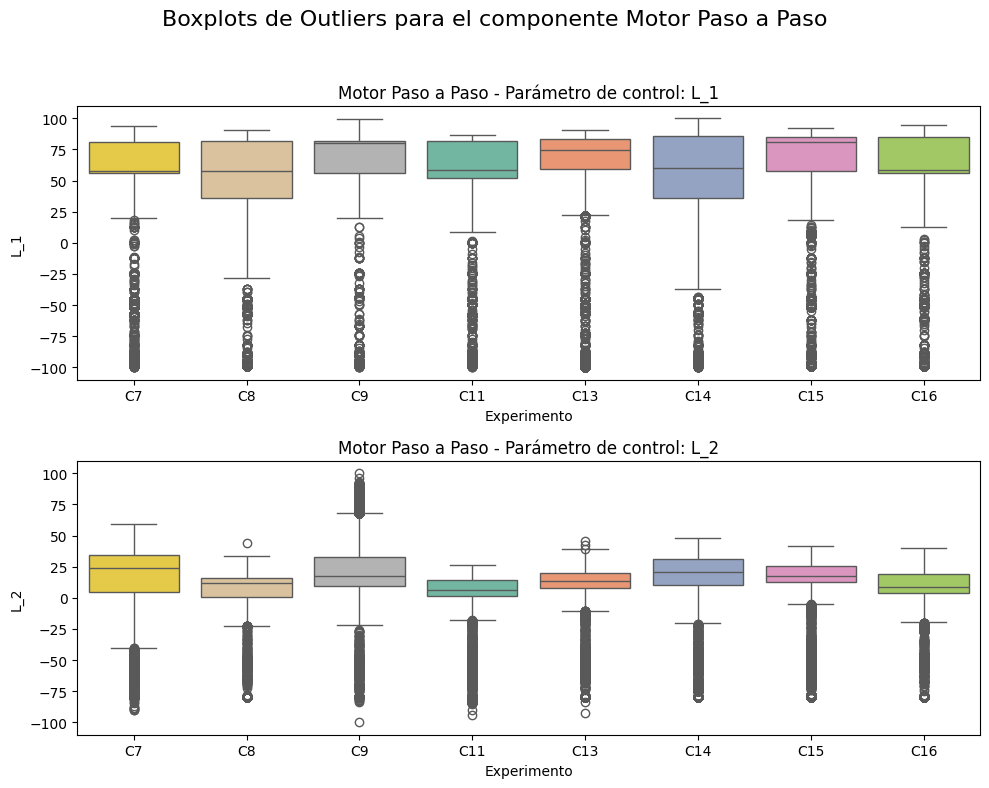

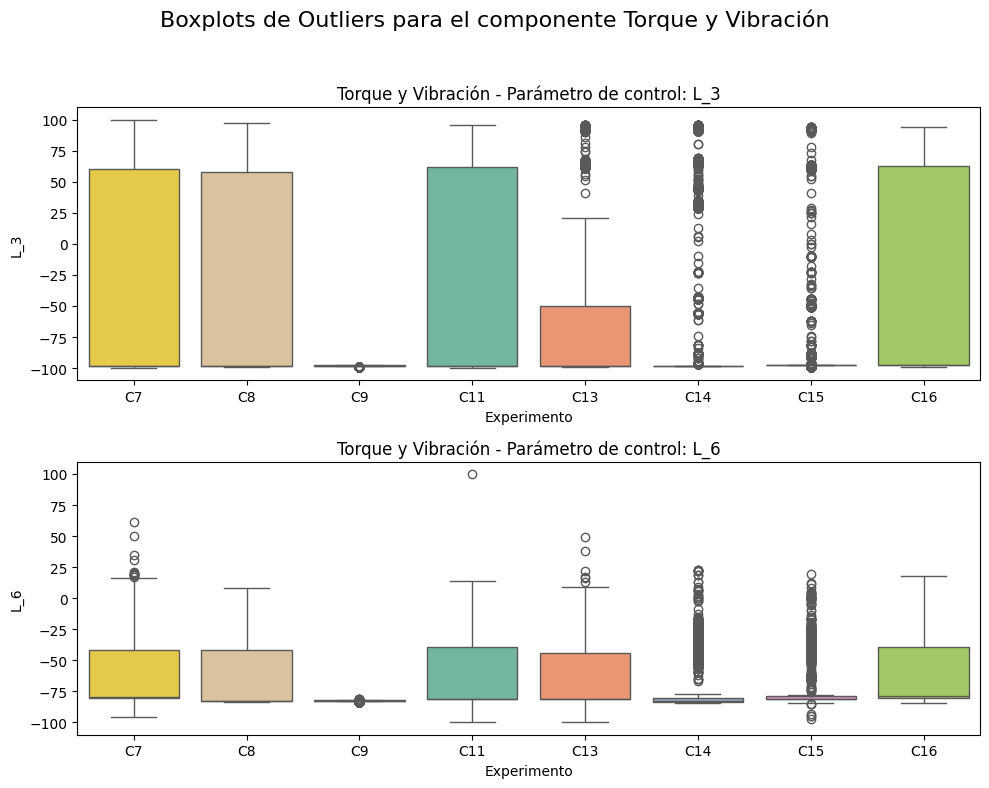

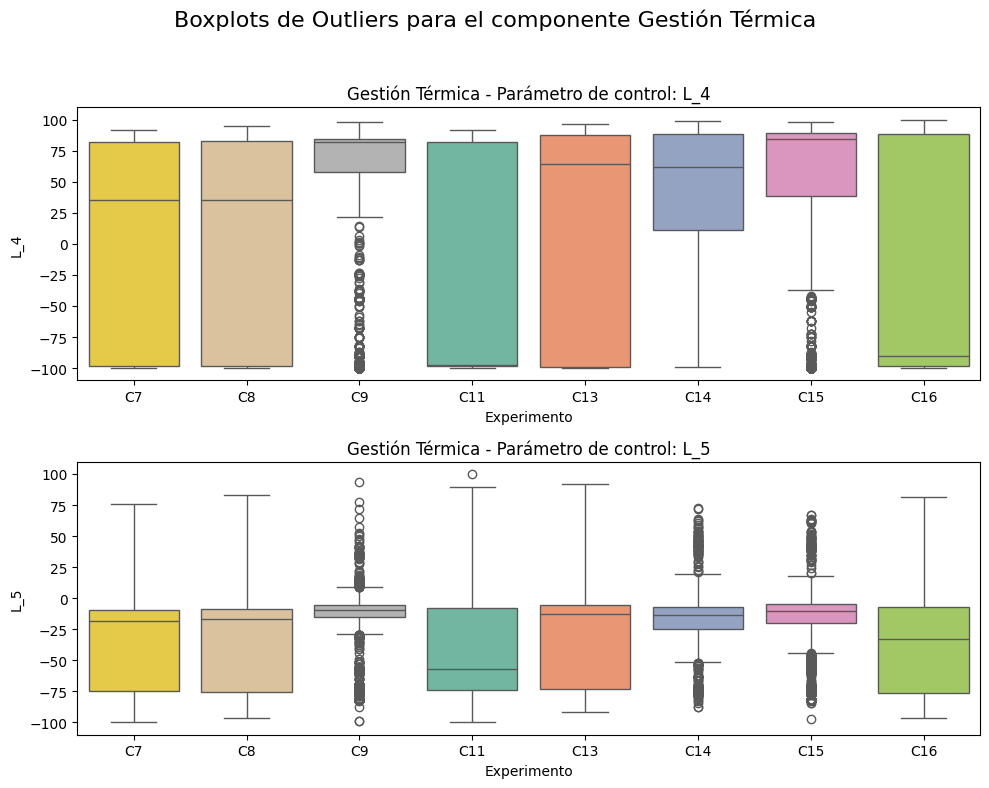

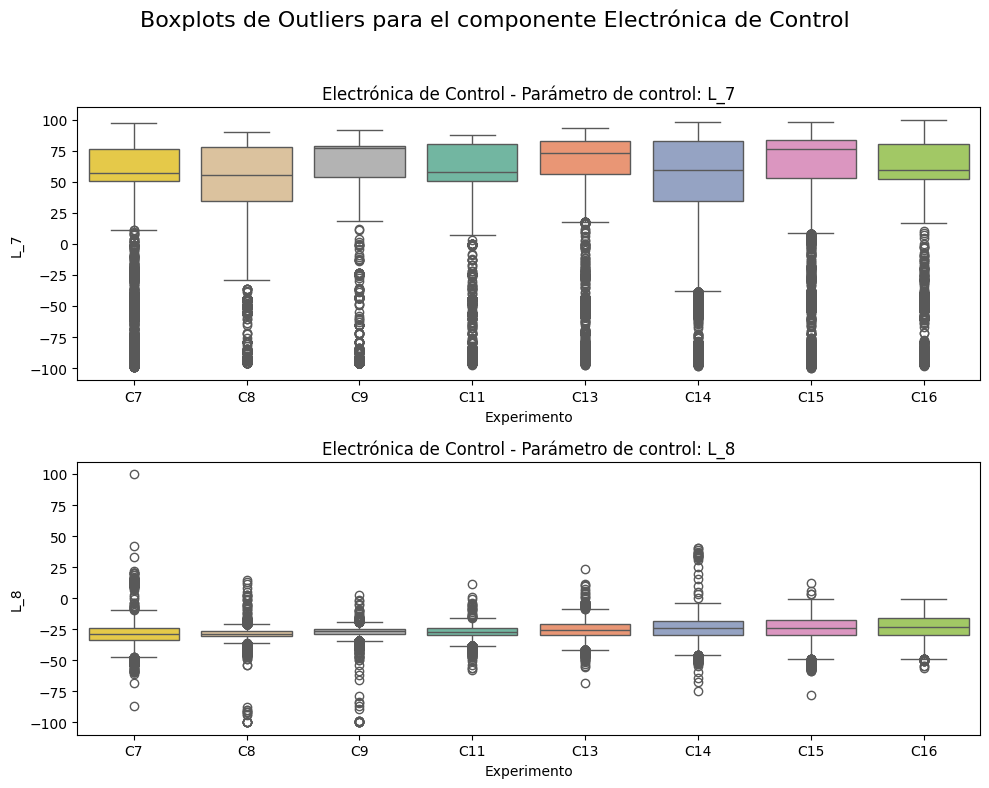

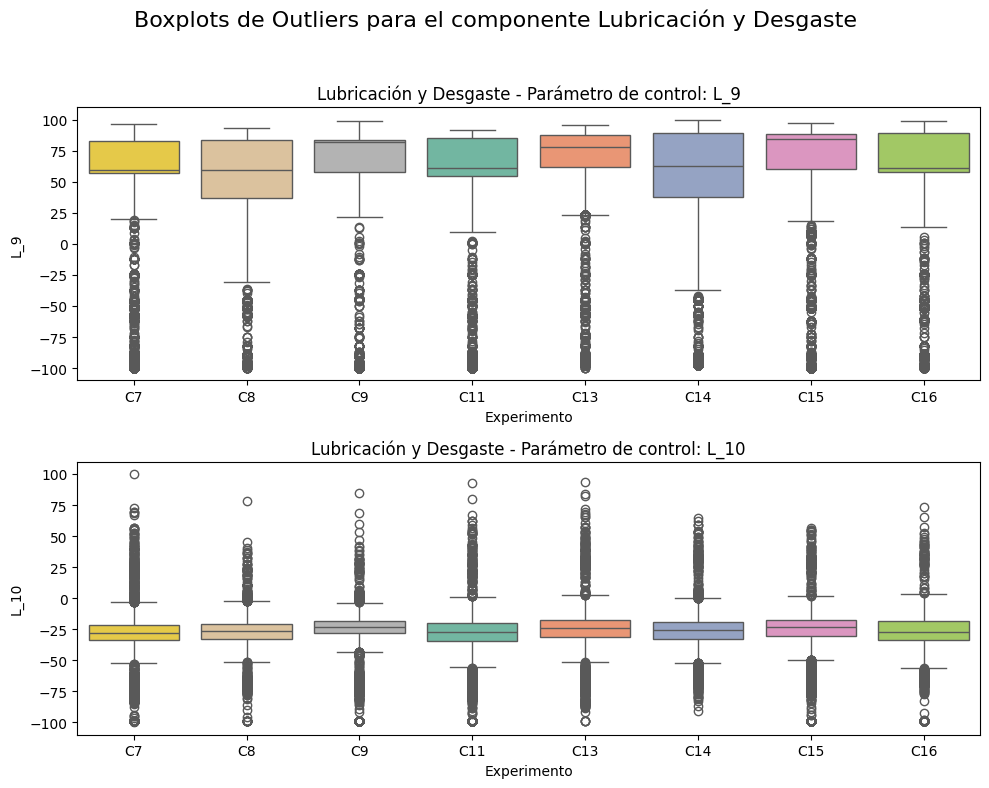

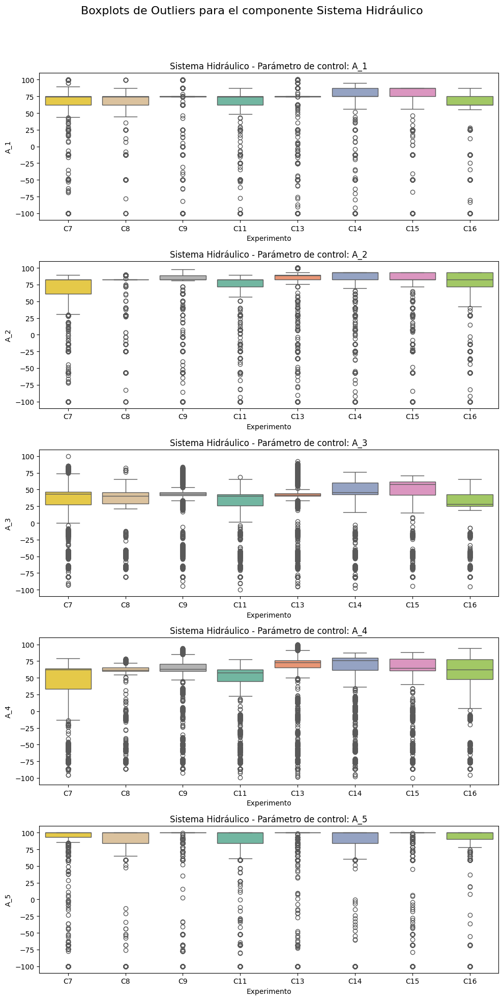

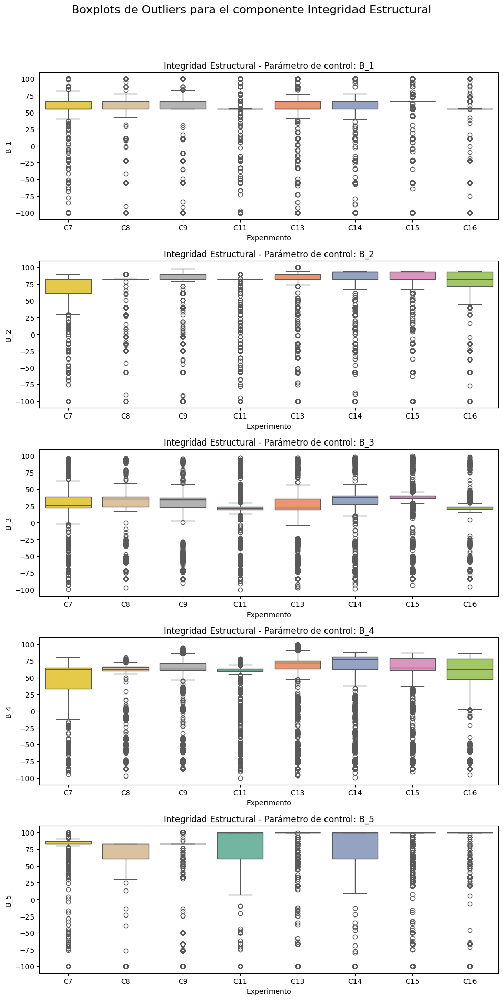

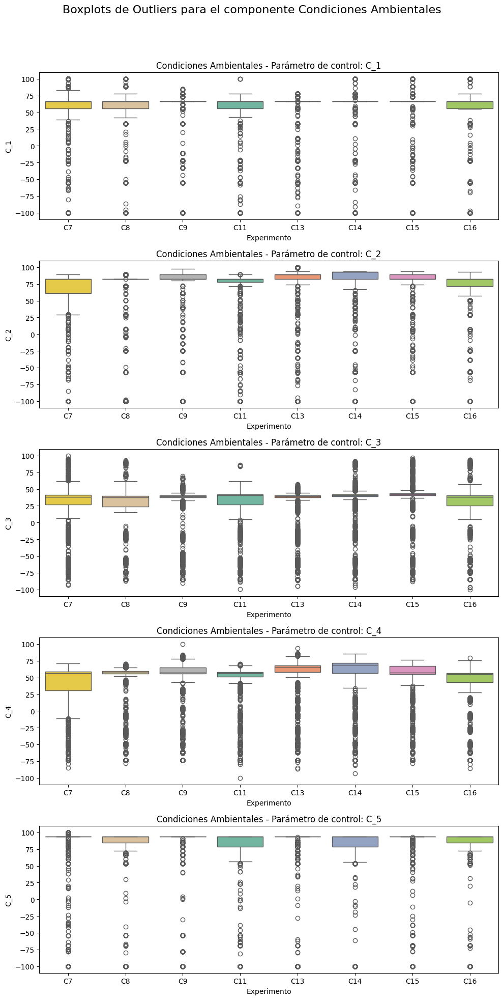

In [ ]:
# Definimos el orden de los experimentos mediante una serie o lista
experimentos = pd.Series(["C7", "C8", "C9", "C11", "C13", "C14", "C15", "C16"])

# Utilizamos una paleta de colores (por ejemplo, "Set2") para diferenciar los experimentos visualmente
for comp, parametros in componentes.items():
    n_params = len(parametros)
    fig, axes = plt.subplots(nrows=n_params, ncols=1, figsize=(10, 4 * n_params))

    # Si solo hay un parámetro, se encapsula en una lista para iterar
    if n_params == 1:
        axes = [axes]

    for ax, param in zip(axes, parametros):
        sns.boxplot(
            data=df_monitoring,
            x="experiment_ID",           # Agrupación de datos según experimentos
            y=param,
            order=experimentos.tolist(),  # Se asegura el orden de los experimentos
            hue="experiment_ID",          # Asignamos hue para evitar el warning
            palette="Set2",               # Paleta de colores que asigna colores distintos a cada grupo
            dodge=False,                # Evitamos separar los boxplots
            ax=ax
        )
        # Eliminamos la leyenda, ya que la variable de agrupación es evidente en el eje x
        if ax.get_legend() is not None:
            ax.get_legend().remove()

        ax.set_title(f"{comp} - Parámetro de control: {param}")
        ax.set_xlabel("Experimento")
        ax.set_ylabel(param)

    plt.suptitle(f"Boxplots de Outliers para el componente {comp}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


>**CONCLUSION 4**


>Los gráficos dejan en claro que los experimentos run-to-failure presentan numerosos outliers, lo cual es inherente a su naturaleza.

* **Ubicación de los outliers**



Se puede obtener la ubicación exacta de los outliers por columna, calculandolos de forma manual.












In [ ]:
def detectar_outliers(serie):
    Q1 = serie.quantile(0.25)
    Q3 = serie.quantile(0.75)
    IQR = Q3 - Q1
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR
    return serie[(serie < limite_inferior) | (serie > limite_superior)]

# Iterar sobre cada componente y sus variables asociadas
for componente, lista_vars in componentes.items():
    print(f"Componente: {componente}")
    for var in lista_vars:
        outliers = detectar_outliers(df_monitoring[var])
        print(f"Outliers en {var}:")
        print(outliers)
        print("--------------")



Componente: Motor Paso a Paso
Outliers en L_1:
0        -99.331815
1        -99.331815
2        -96.142749
3        -88.883827
4        -66.985573
            ...    
228407   -91.921033
228408   -99.331815
228409   -99.331815
228410   -99.331815
228411   -99.331815
Name: L_1, Length: 19953, dtype: float64
--------------
Outliers en L_2:
0        -79.731577
1        -79.731577
2        -71.343358
3        -59.724121
4        -50.316888
            ...    
228407   -54.939729
228408   -79.731577
228409   -79.731577
228410   -79.731577
228411   -79.731577
Name: L_2, Length: 16886, dtype: float64
--------------
Componente: Torque y Vibración
Outliers en L_3:
1469      27.216405
1470      26.989665
1471      40.246412
1472      52.671779
1473      59.730959
            ...    
219605    64.764593
219606    64.190184
219607    63.298339
219608    63.993676
219609    64.749447
Name: L_3, Length: 54237, dtype: float64
--------------
Outliers en L_6:
1457      14.694881
1458       9.158918
145

>**CONCLUSION 5**

>Es bastante común que, al aplicar el criterio tradicional de **1.5·IQR** para detectar outliers, se terminen detectando muchos valores "atípicos", especialmente **en datos de sensores** o **en distribuciones con colas largas o asimetrías**.
>
>Esto no necesariamente significa que haya errores o datos erróneos; **y simplemente puede ser que la dispersión natural o la variabilidad de la señal eleva el número de puntos que quedan fuera del rango definido**.
>
>En estos caso:
>
>1.  Hay varios métodos para **ajustar el Factor del IQR**, .
  * *Ajustar el Factor del IQR (por ejemplo, usar 3·IQR en lugar de 1.5·IQR)*
  * *Modified Z-score basados en la Mediana Absoluta de las Desviaciones (MAD)*
  * *Métodos basados en Densidad o Modelos de Clustering (ej. Isolation Forest, DBSCAN)*
  * *Método de Z-score (estándar)*
  * *Método Basado en Percentiles*
  * *Winsorización*
>
>2.  Revisar la Distribución, por ejemplo con el **uso de gráficos de densidad**. Si se observa una distribución asimétrica o con colas pesadas, es normal que el método del 1.5·IQR marque muchos puntos como outliers

* **Comparación entre** **`1.5IQR`** **&** **`3IQR`**





Cantidad de Outliers para cada componente y parámetro de control

In [ ]:
def detectar_outliers(serie, factor=1.5):
    Q1 = serie.quantile(0.25)
    Q3 = serie.quantile(0.75)
    IQR = Q3 - Q1
    limite_inferior = Q1 - factor * IQR
    limite_superior = Q3 + factor * IQR
    return serie[(serie < limite_inferior) | (serie > limite_superior)]

# Iteramos por cada componente y sus parámetros para calcular y mostrar el número de outliers
for comp, parametros in componentes.items():
    print(f"Componente: {comp}")
    for param in parametros:
        outliers_factor_1_5 = detectar_outliers(df_monitoring[param], factor=1.5)
        outliers_factor_3 = detectar_outliers(df_monitoring[param], factor=3)
        print(f"  Parámetro de control: {param}")
        print(f"    Cantidad de outliers con factor 1.5: {outliers_factor_1_5.shape[0]}")
        print(f"    Cantidad de outliers con factor 3:   {outliers_factor_3.shape[0]}")
        print("    --------------")
    print("==========================================")


Componente: Motor Paso a Paso
  Parámetro de control: L_1
    Cantidad de outliers con factor 1.5: 19953
    Cantidad de outliers con factor 3:   17118
    --------------
  Parámetro de control: L_2
    Cantidad de outliers con factor 1.5: 16886
    Cantidad de outliers con factor 3:   8301
    --------------
Componente: Torque y Vibración
  Parámetro de control: L_3
    Cantidad de outliers con factor 1.5: 54237
    Cantidad de outliers con factor 3:   2545
    --------------
  Parámetro de control: L_6
    Cantidad de outliers con factor 1.5: 67
    Cantidad de outliers con factor 3:   2
    --------------
Componente: Gestión Térmica
  Parámetro de control: L_4
    Cantidad de outliers con factor 1.5: 0
    Cantidad de outliers con factor 3:   0
    --------------
  Parámetro de control: L_5
    Cantidad de outliers con factor 1.5: 1
    Cantidad de outliers con factor 3:   0
    --------------
Componente: Electrónica de Control
  Parámetro de control: L_7
    Cantidad de outliers co

>**CONCLUSION 6**

> Los resultados muestran que aplicar un factor de 1.5IQR detecta muchos más outliers que al usar 3IQR, especialmente en sensores con alta variabilidad, lo que indica que estos valores extremos forman parte intrínseca del comportamiento en experimentos run-to-failure.

>Por lo que no los eliminaremos para no perder así información crucial para entrenar los modelos en encontrar patrones de fallos críticos.

>Por otro lado, para el modelo que se proponga para producción utilizaremos la estrategia de imputación con la mediana en lugar de por eliminar, ya que esta técnica es menos sensible a la presencia de outliers.En nuestro actual dataframe dado que la proporción de datos faltantes fue prácticamente insignificante (alrededor del 0.01–0.02%), optamos por eliminar los registros incompletos en lugar de imputarlos.

* ***Gáficos de densidad***



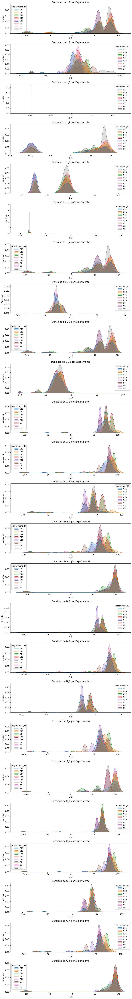

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Lista de variables monitorizadas
V_Monitorizados = [
    'L_1', 'L_2', 'L_3', 'L_4', 'L_5',
    'L_6', 'L_7', 'L_8', 'L_9', 'L_10',
    'A_1', 'A_2', 'A_3', 'A_4', 'A_5',
    'B_1', 'B_2', 'B_3', 'B_4', 'B_5',
    'C_1', 'C_2', 'C_3', 'C_4', 'C_5'
]

n_vars = len(V_Monitorizados)
# Establecemos una figura con tantas filas como variables (una gráfica por variable) y 1 columna.
fig, axes = plt.subplots(nrows=n_vars, ncols=1, figsize=(10, 3 * n_vars))

# Si sólo hay una variable (caso singular), aseguramos que axes sea iterable
if n_vars == 1:
    axes = [axes]

# Generar cada gráfica de densidad
for i, var in enumerate(V_Monitorizados):
    sns.kdeplot(
        data=df_monitoring,
        x=var,
        hue="experiment_ID",    # Separa y sobrepone las curvas correspondientes a cada experimento
        ax=axes[i],
        common_norm=False,      # Cada grupo se normaliza de forma independiente
        fill=True              # Se muestran solamente las líneas para evitar solapamientos densos
    )
    axes[i].set_title(f"Densidad de {var} por Experimento")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("Densidad")

plt.tight_layout()
plt.show()




>*A la vista de las gráficas de densidad:*

>- **Visualización de la Distribución Completa:**  
  Las gráficas de densidad permiten observar la forma completa de la distribución, revelando la presencia de ***colas largas y acumulaciones en regiones extremas***. En muchos casos, se aprecia que ***la densidad disminuye de forma gradual en los extremos***, lo que sugiere que ***los valores extremos no son meras aberraciones sino parte de la dinámica del sistema***.

* **Modified Z-score con MAD**

  - **¿Por qué?**  
  En el contexto del TFM, **los outliers en los parámetros de control pueden reflejar momentos críticos o de failure en los equipos**. Estos valores extremos no son simplemente "ruido" a eliminar, sino señales importantes que pueden mejorar la capacidad predictiva del modelo.  

  - **Ventajas del Modified Z-score:**  
    - **Resistencia a distribuciones asimétricas y colas largas:**  
    En sistemas con alta variabilidad o mediciones de sensores, las distribuciones suelen no ser perfectamente simétricas. La mediana y el MAD son estadísticas que no se ven tan afectadas por aquellos valores extremos.  
    - **Detección precisa de outliers relevantes:**  
    Al utilizar el Modified Z-score, se logra identificar aquellos puntos que se desvían significativamente del comportamiento típico sin etiquetar en exceso los datos normales que simplemente reflejan la naturaleza inherente de la distribución.  
    - **Preservación de información crítica:**  
    Es fundamental en este proyecto no eliminar automáticamente los outliers, ya que pueden corresponder a los momentos previos a fallos (failures). Reconocer y analizar estos valores permite desarrollar modelos de regresión o clustering que tengan en cuenta esta información crucial.
  - **Aplicación**  
    A continuación se muestra el código para iterar sobre la serie con los parámetros de control y generar, para cada parámetro, el cálculo del Modified Z-score y su respectiva visualización (gráfica de densidad con los outliers señalados).

Cantidad de outliers detectados en L_1: 14024
0   -99.331815
1   -99.331815
2   -96.142749
3   -88.883827
4   -66.985573
Name: L_1, dtype: float64 
--------------


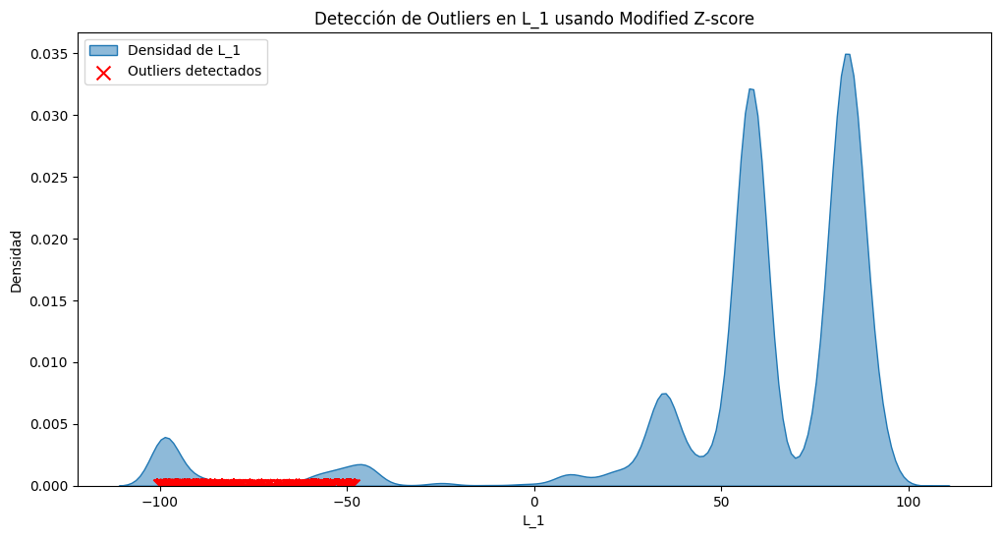

Cantidad de outliers detectados en L_2: 14062
0   -79.731577
1   -79.731577
2   -71.343358
3   -59.724121
4   -50.316888
Name: L_2, dtype: float64 
--------------


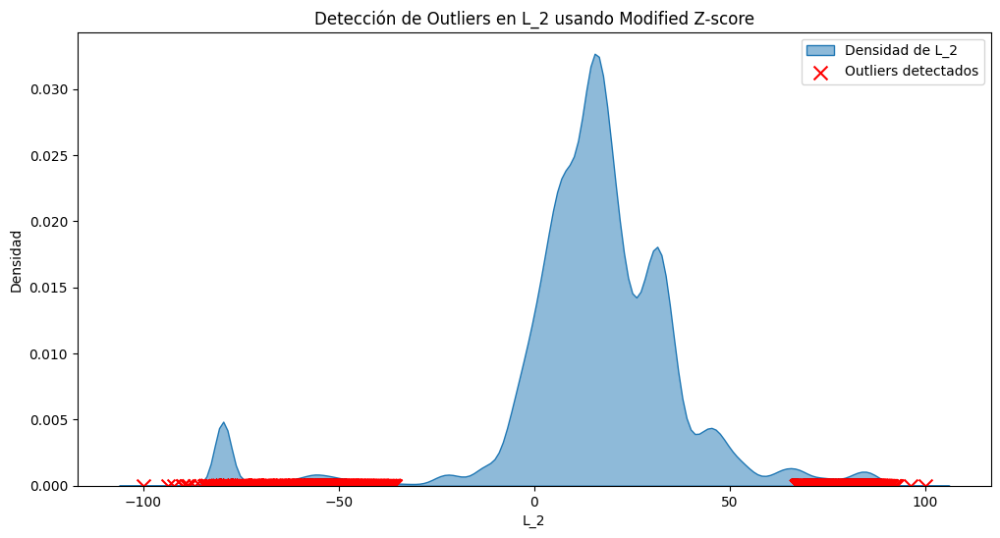

Cantidad de outliers detectados en L_3: 66849
0   -99.183735
1   -99.183735
2   -99.183735
3   -99.183735
4   -99.183735
Name: L_3, dtype: float64 
--------------


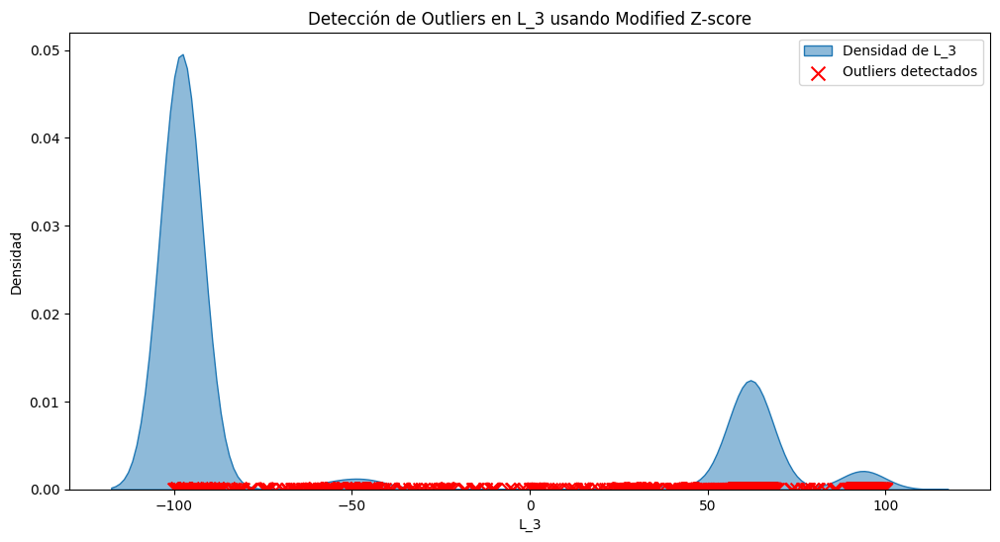

Cantidad de outliers detectados en L_4: 70276
0   -97.704794
1   -97.704794
2   -97.402793
3   -90.033974
9   -97.463193
Name: L_4, dtype: float64 
--------------


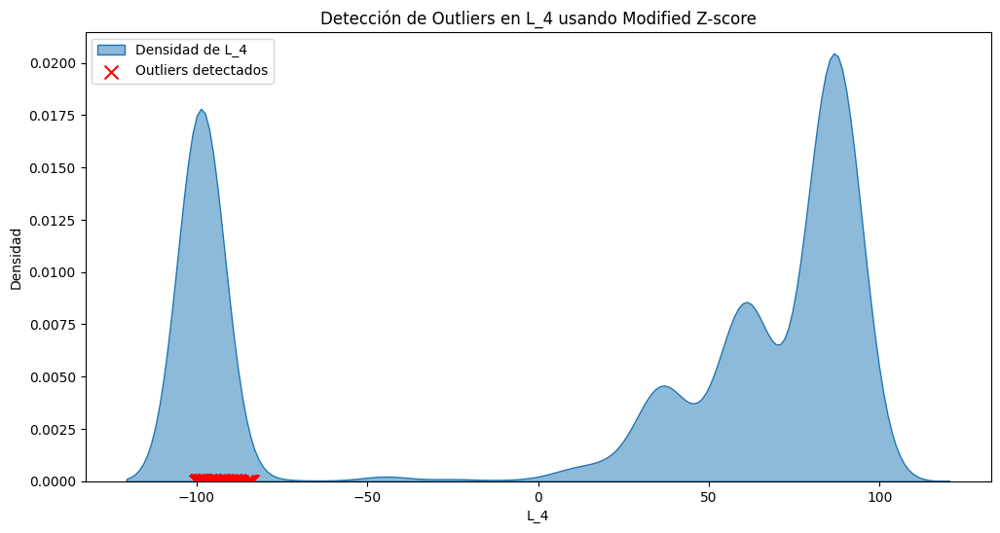

Cantidad de outliers detectados en L_5: 69610
0   -76.934022
1   -76.934022
2   -71.781622
7   -71.092638
8   -96.555081
Name: L_5, dtype: float64 
--------------


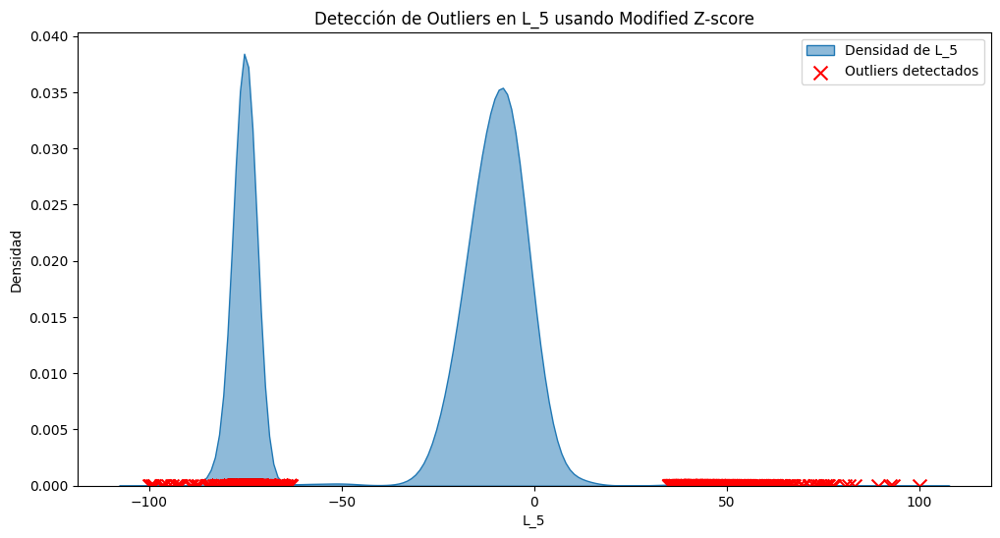

Cantidad de outliers detectados en L_6: 61037
1416   -63.043711
1417   -63.043711
1418   -61.323074
1419   -68.162873
1420   -67.446831
Name: L_6, dtype: float64 
--------------


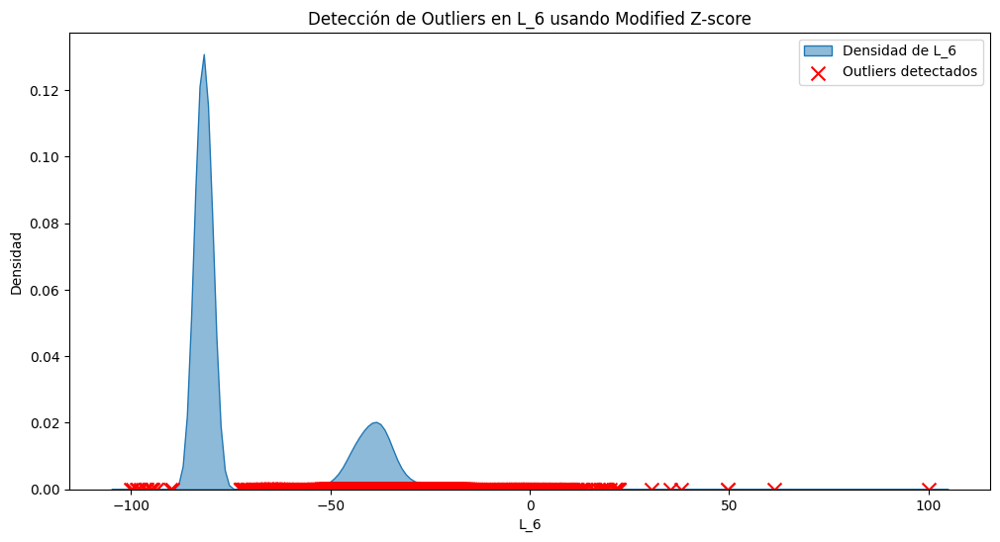

Cantidad de outliers detectados en L_7: 17108
0   -93.610953
1   -93.610953
2   -93.610953
3   -85.852824
4   -65.288078
Name: L_7, dtype: float64 
--------------


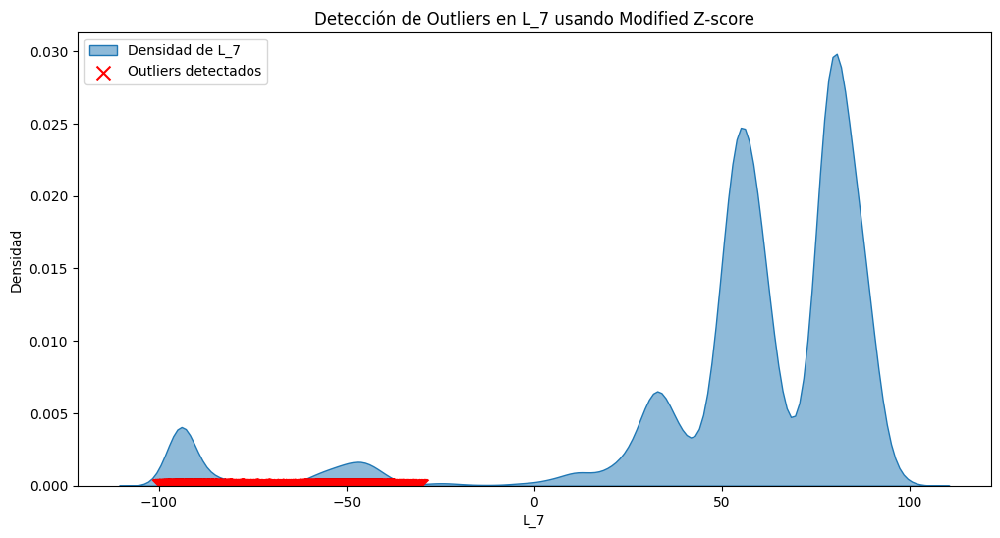

Cantidad de outliers detectados en L_8: 851
335    -51.734260
1454   -49.020214
7449   -59.464401
7451   -48.216815
8371   -48.572164
Name: L_8, dtype: float64 
--------------


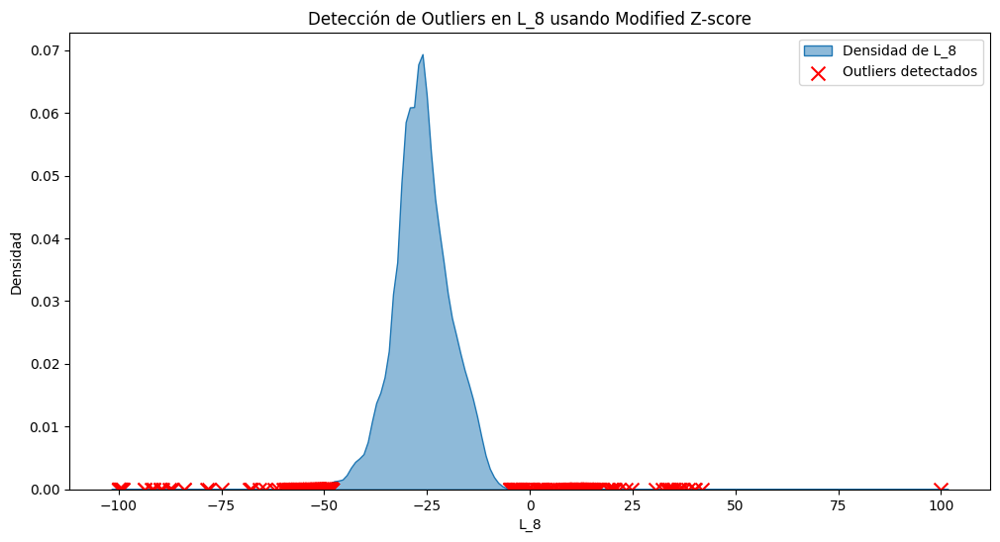

Cantidad de outliers detectados en L_9: 17009
0   -97.509680
1   -97.509680
2   -97.509680
3   -89.826133
4   -67.853618
Name: L_9, dtype: float64 
--------------


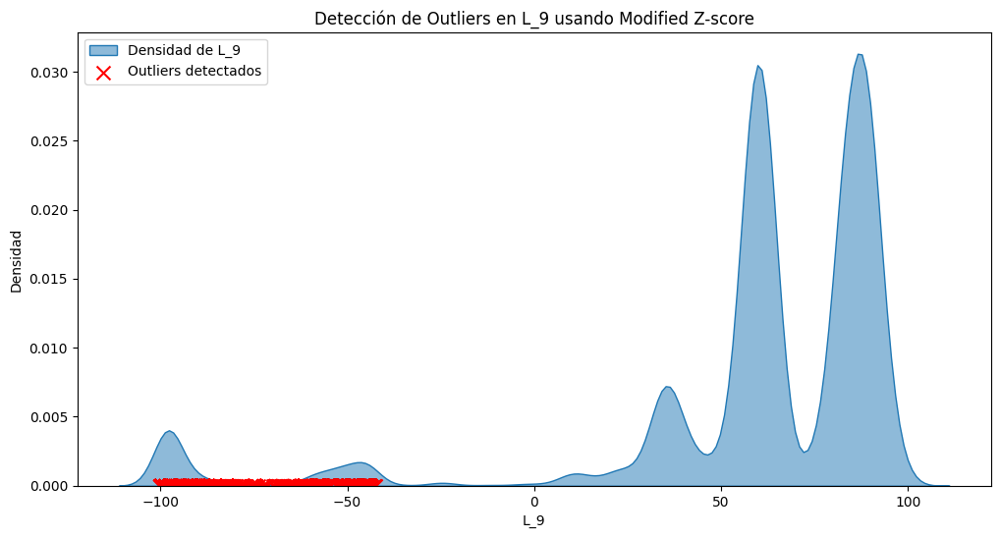

Cantidad de outliers detectados en L_10: 9723
0   -65.524273
1   -65.524273
2   -71.139518
3   -68.708337
4   -67.030037
Name: L_10, dtype: float64 
--------------


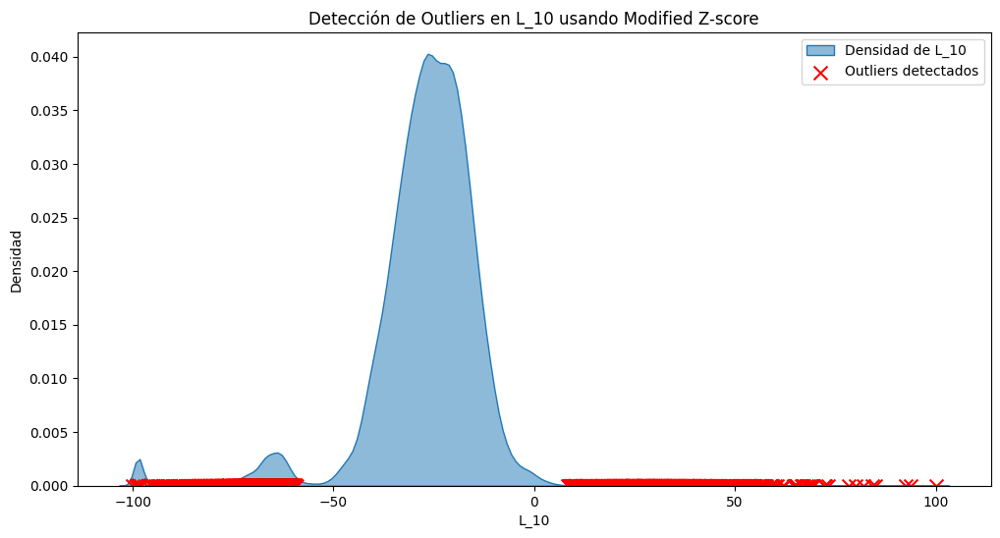

Cantidad de outliers detectados en A_1: 99334
0   -49.996189
1   -50.087659
2   -50.118149
3   -50.102904
4   -50.148639
Name: A_1, dtype: float64 
--------------


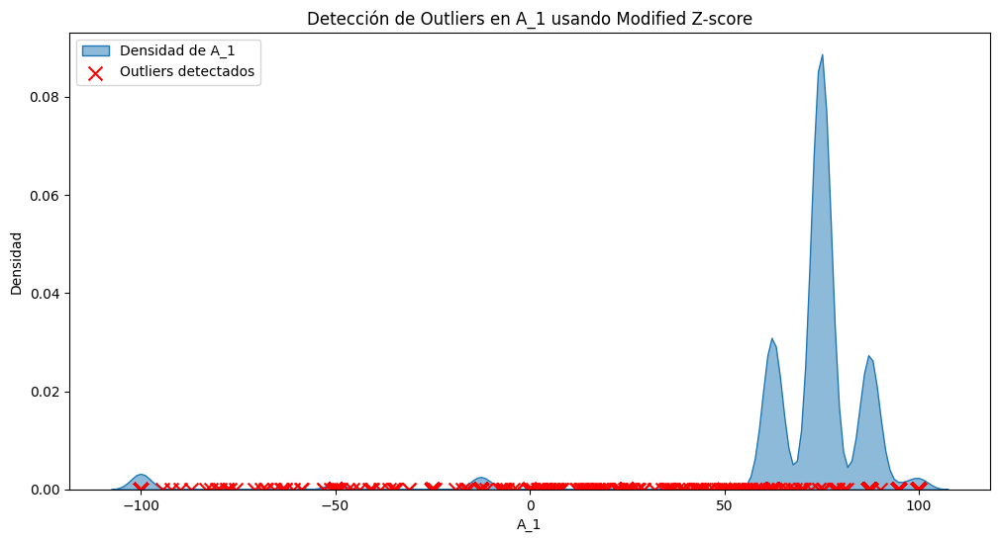

Cantidad de outliers detectados en A_2: 15266
0   -56.874058
1   -56.874058
2   -56.978955
3   -56.874058
4   -56.992067
Name: A_2, dtype: float64 
--------------


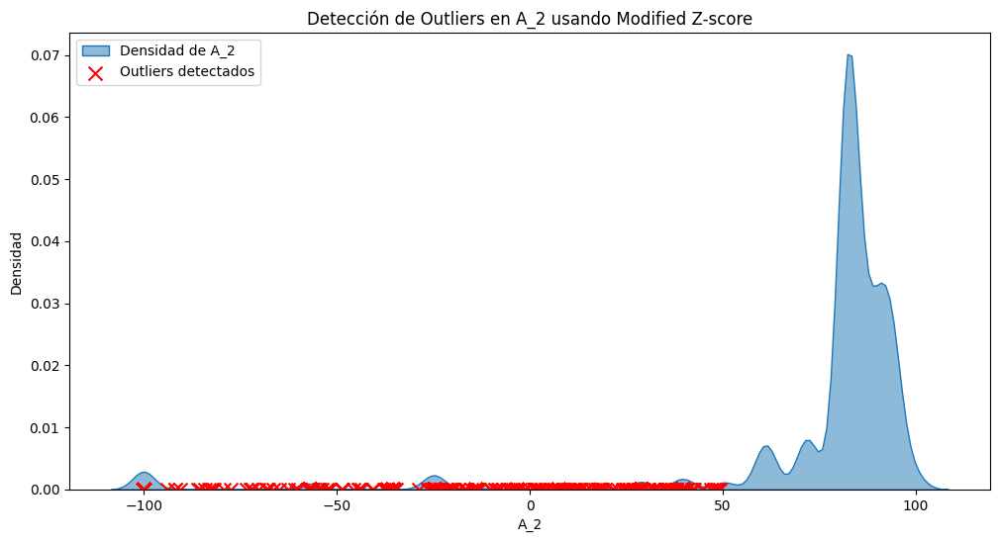

Cantidad de outliers detectados en A_3: 17176
0   -65.697449
1   -65.697449
2   -65.697449
3   -65.697449
4   -65.697449
Name: A_3, dtype: float64 
--------------


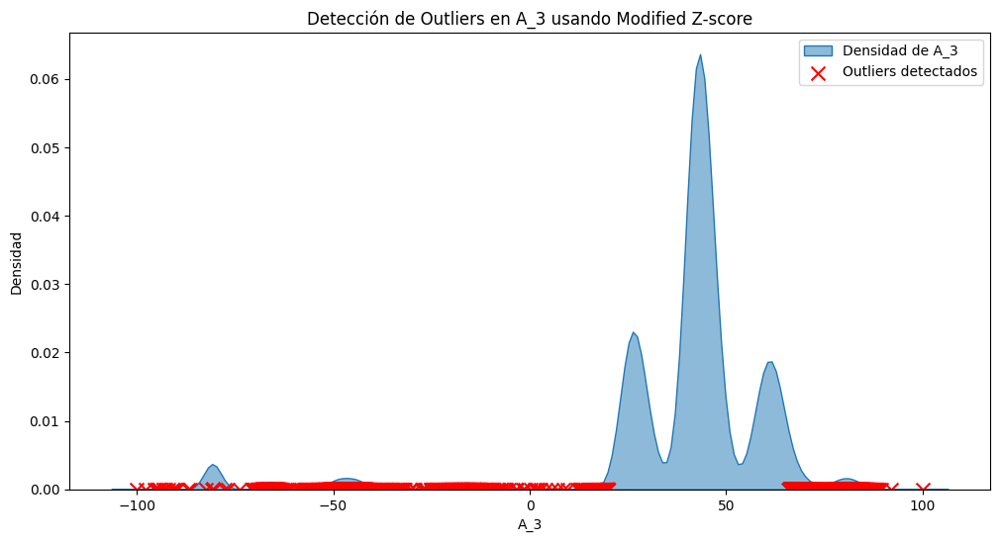

Cantidad de outliers detectados en A_4: 24858
0   -74.540022
1   -76.505740
2   -72.637207
3   -72.511401
4   -75.939613
Name: A_4, dtype: float64 
--------------


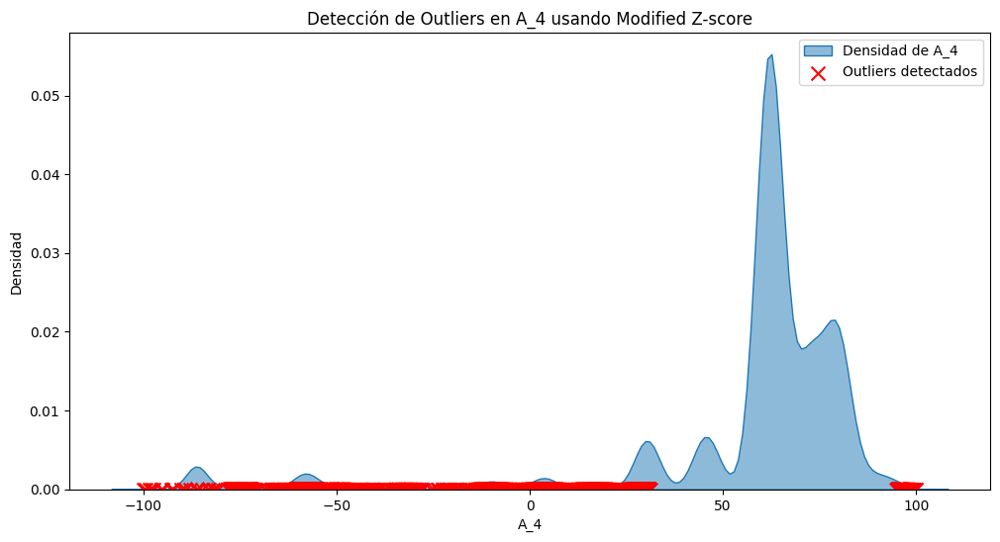

Cantidad de outliers detectados en A_5: 67207
0   -100.0
1   -100.0
2   -100.0
3   -100.0
4   -100.0
Name: A_5, dtype: float64 
--------------


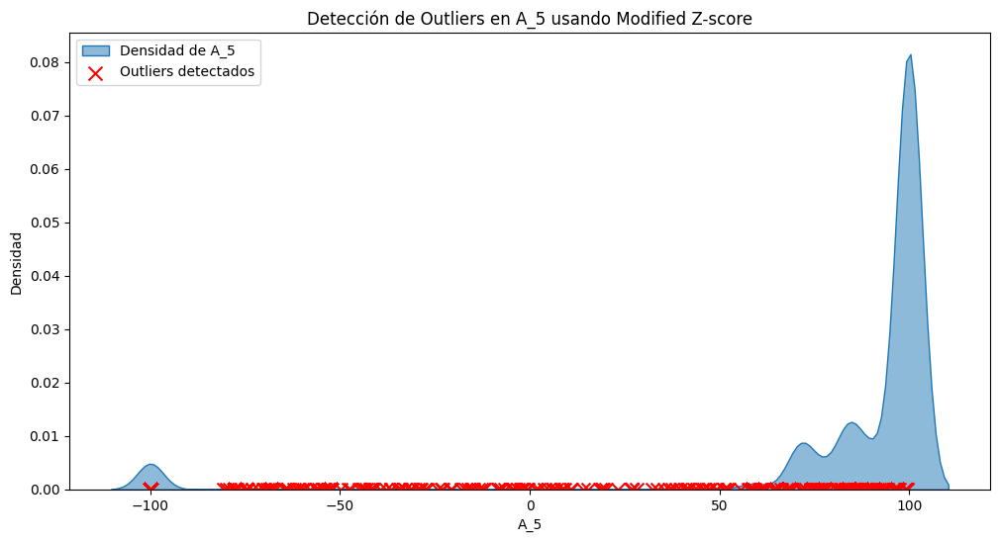

Cantidad de outliers detectados en B_1: 10257
0   -55.671430
1   -55.617255
2   -55.603711
3   -55.671430
4   -55.590167
Name: B_1, dtype: float64 
--------------


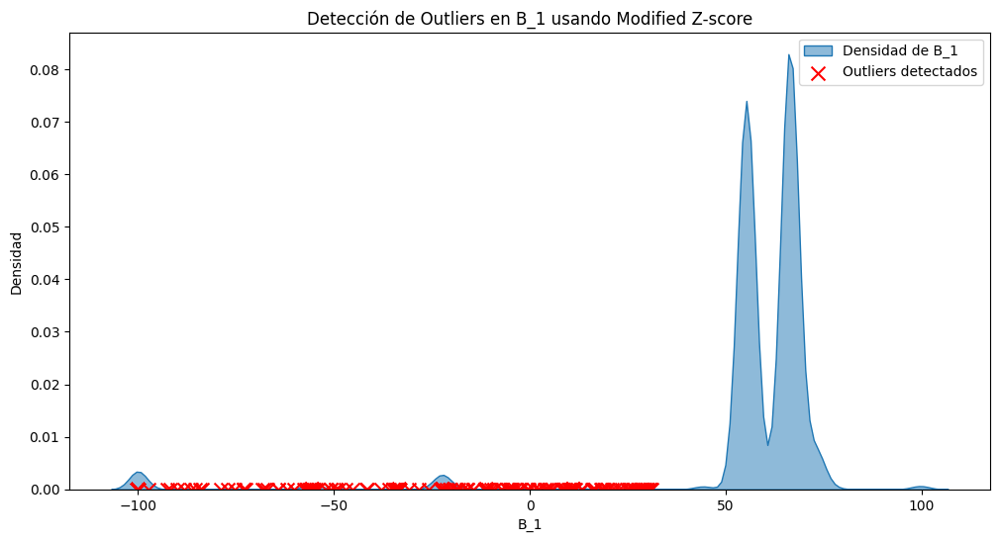

Cantidad de outliers detectados en B_2: 14980
0   -57.022951
1   -56.970492
2   -57.140984
3   -56.983607
4   -57.062295
Name: B_2, dtype: float64 
--------------


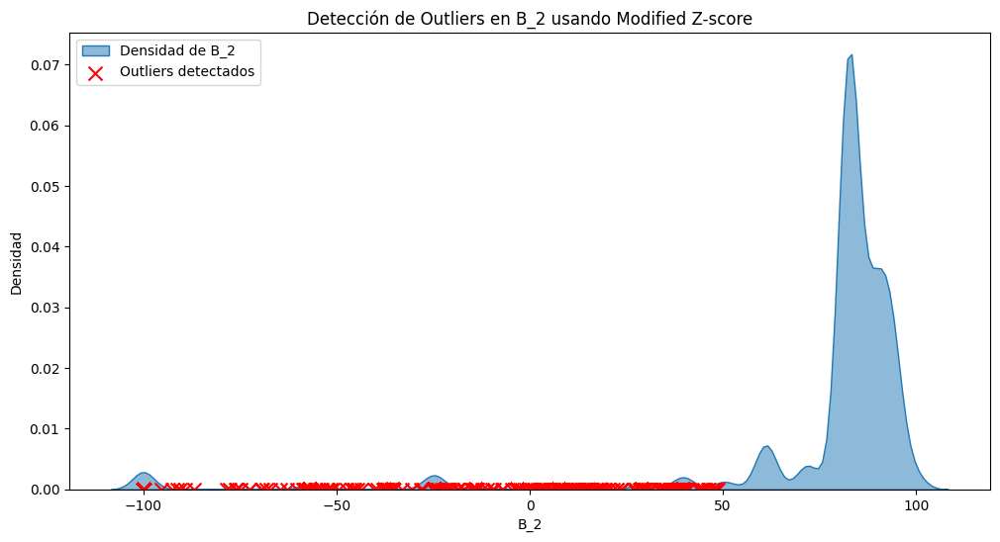

Cantidad de outliers detectados en B_3: 11020
0   -71.040724
1   -71.040724
2   -71.040724
3   -71.040724
4   -71.040724
Name: B_3, dtype: float64 
--------------


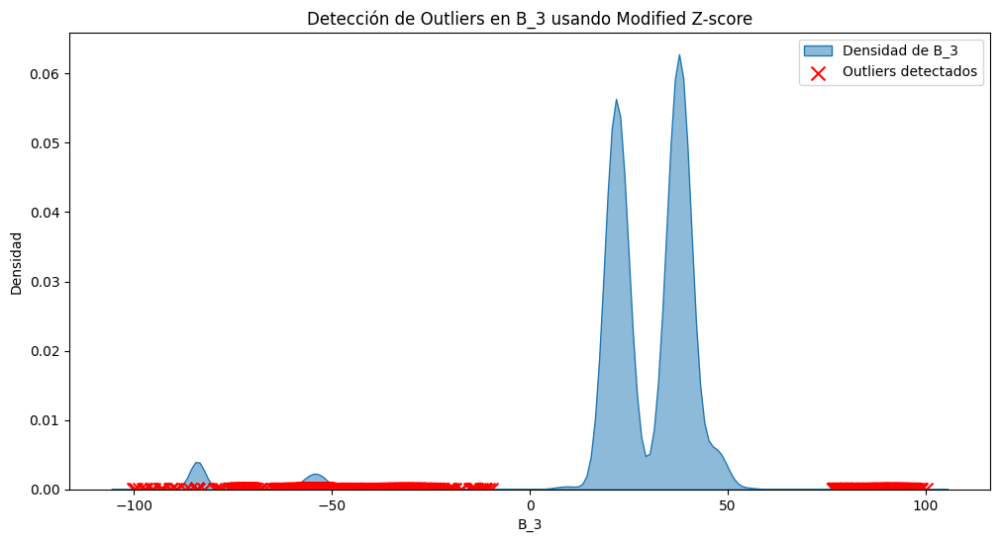

Cantidad de outliers detectados en B_4: 28977
0   -72.811377
1   -74.141754
2   -76.726049
3   -76.726049
4   -78.117593
Name: B_4, dtype: float64 
--------------


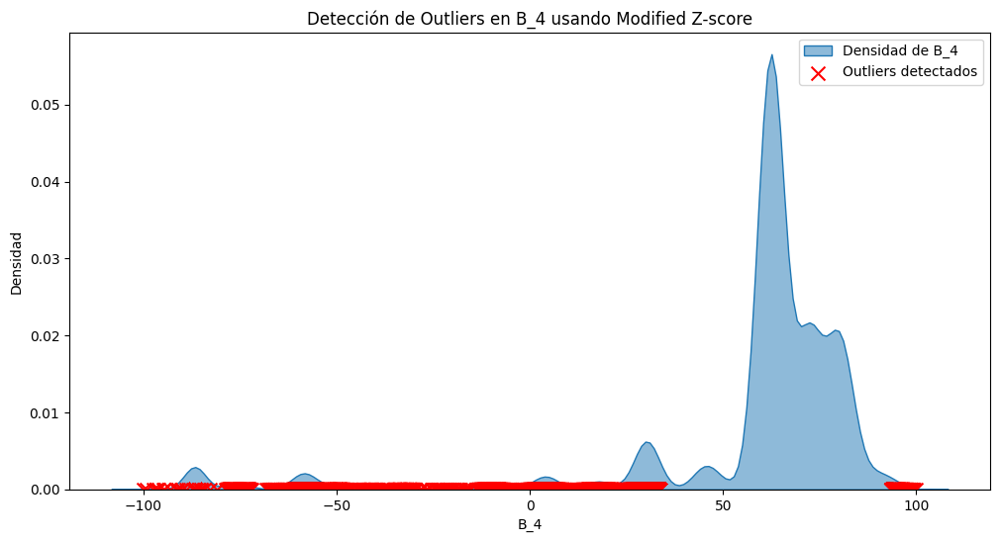

Cantidad de outliers detectados en B_5: 9642
0   -100.0
1   -100.0
2   -100.0
3   -100.0
4   -100.0
Name: B_5, dtype: float64 
--------------


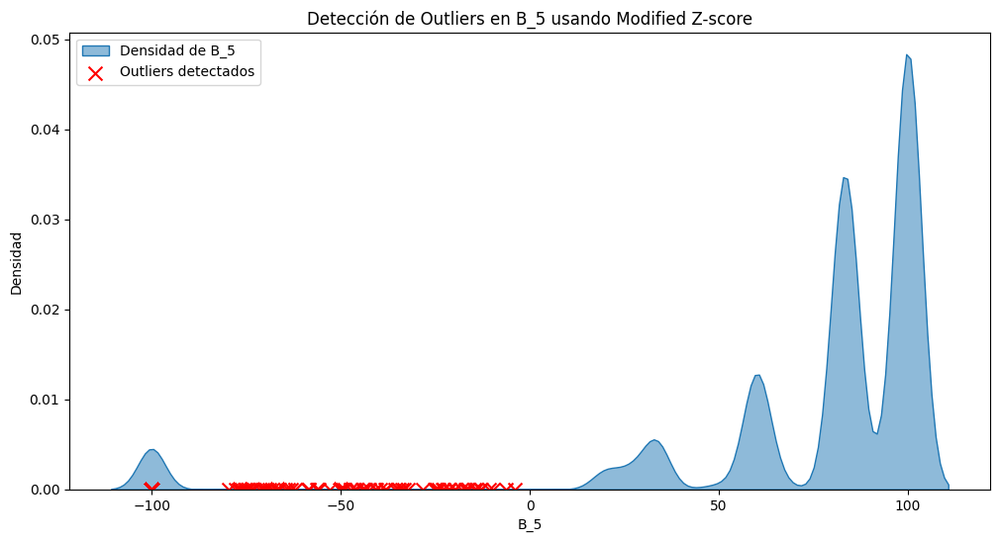

Cantidad de outliers detectados en C_1: 70646
0   -55.660953
1   -55.498340
2   -55.538993
3   -55.593197
4   -55.674504
Name: C_1, dtype: float64 
--------------


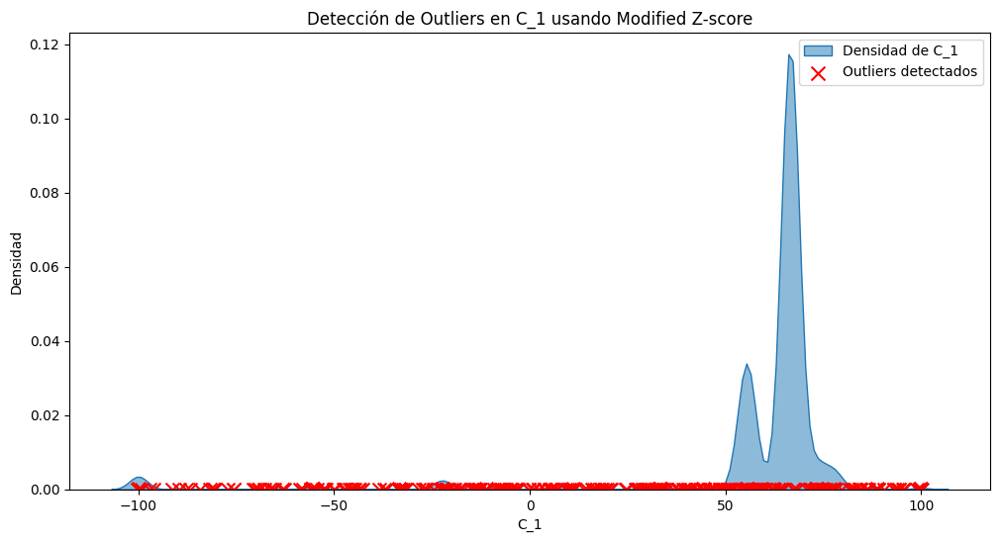

Cantidad de outliers detectados en C_2: 112098
0   -57.035192
1   -57.087620
2   -57.048299
3   -57.035192
4   -57.035192
Name: C_2, dtype: float64 
--------------


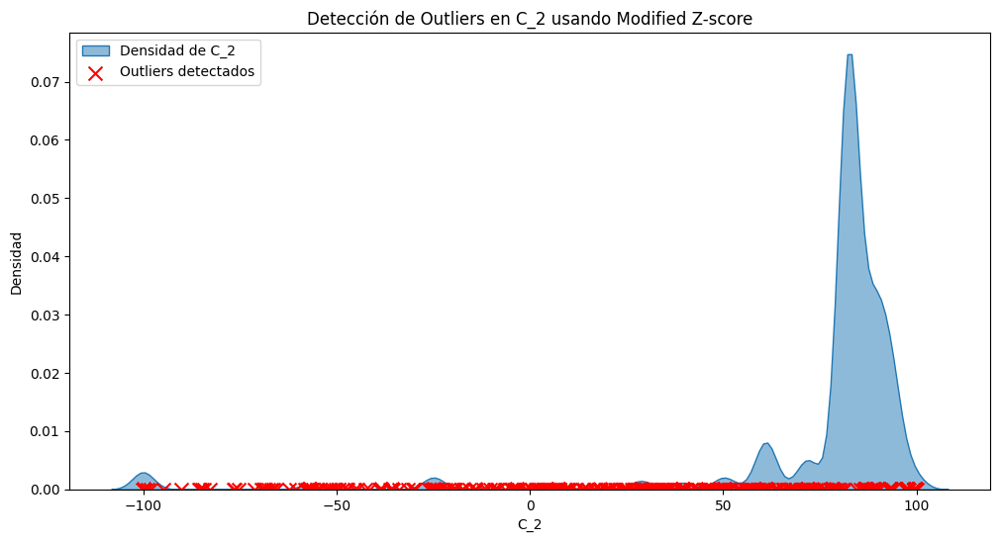

Cantidad de outliers detectados en C_3: 56606
0   -72.546054
1   -72.546054
2   -72.546054
3   -72.546054
4   -72.546054
Name: C_3, dtype: float64 
--------------


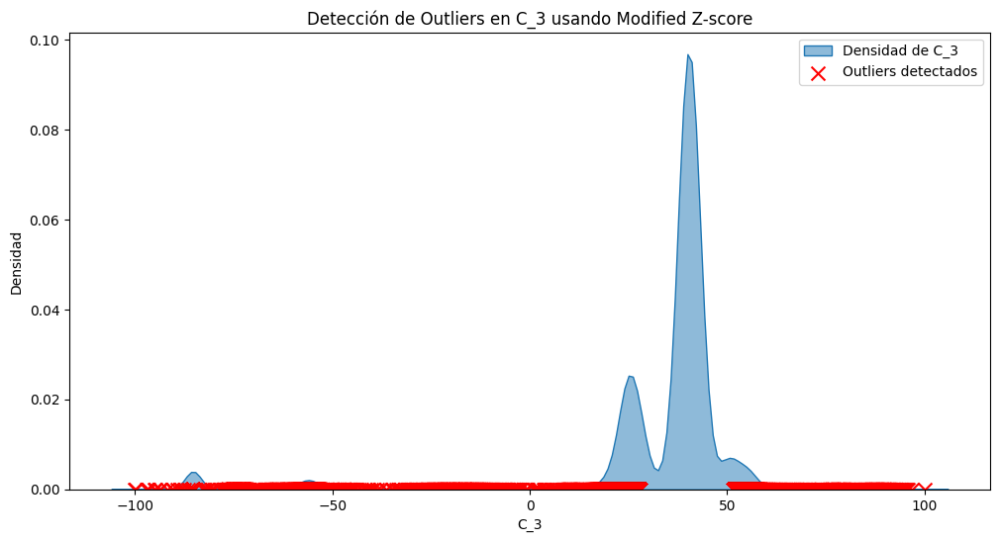

Cantidad de outliers detectados en C_4: 35250
0   -62.125488
1   -62.125488
2   -62.125488
3   -62.125488
4   -62.125488
Name: C_4, dtype: float64 
--------------


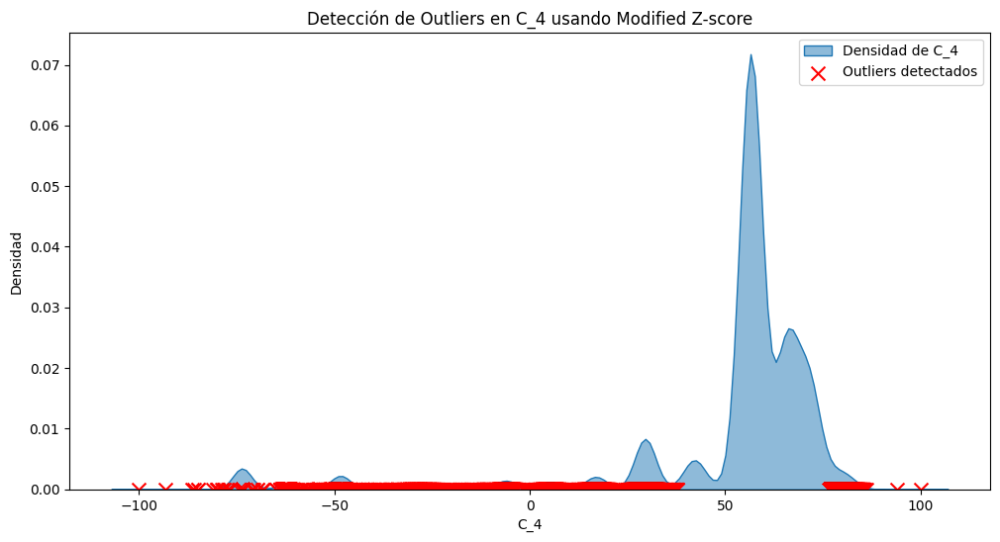

Cantidad de outliers detectados en C_5: 64815
0   -100.0
1   -100.0
2   -100.0
3   -100.0
4   -100.0
Name: C_5, dtype: float64 
--------------


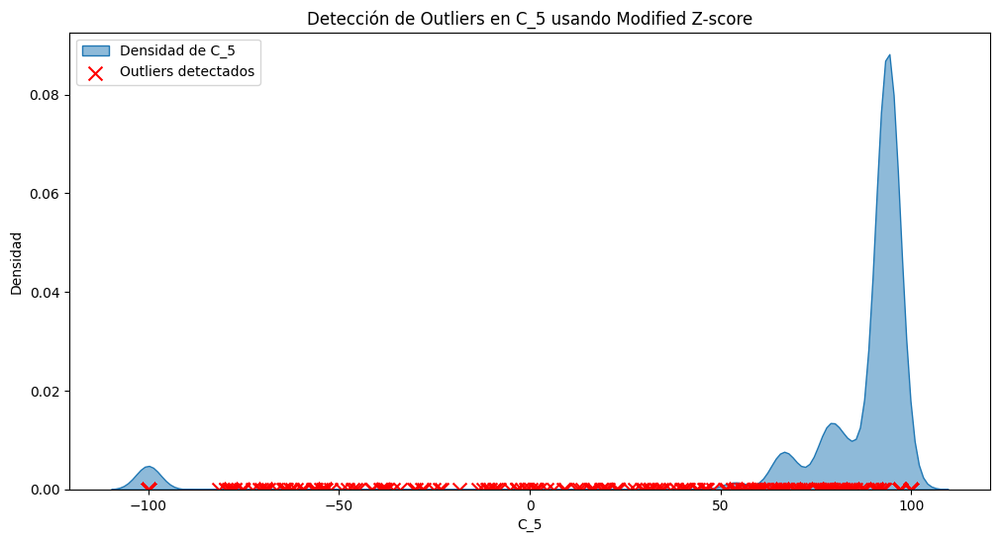

In [ ]:
def modified_z_score(series, threshold=3.5):
    """
    Calcula el Modified Z-score para cada dato de la serie usando la Mediana Absoluta de las Desviaciones (MAD).

    Parámetros:
      series (pd.Series o np.array): La serie de datos a analizar.
      threshold (float): Valor umbral para etiquetar como outlier. Por defecto se utiliza 3.5.

    Retorna:
      outliers (np.array): Array booleano donde True indica que el valor es un outlier.
      z_scores (np.array): Array con los Modified Z-scores de cada dato.
    """
    # Calcular la mediana de la serie
    median = np.median(series)
    # Calcular el MAD (Median Absolute Deviation)
    mad = np.median(np.abs(series - median))
    # Evitar la división por cero; si el MAD es cero, se asigna un valor muy pequeño
    if mad == 0:
        mad = 1e-6
    # Calcular el Modified Z-score
    z_scores = 0.6745 * (series - median) / mad
    # Se consideran outliers aquellos valores cuyo z_score absoluto sobrepasa el threshold
    outliers = np.abs(z_scores) > threshold
    return outliers, z_scores

# Iterar por cada parámetro de V_Monitorizados para calcular outliers y graficar la densidad
for parametro in V_Monitorizados:
    # Calcular modified z-score y detectar outliers
    outliers, z_scores = modified_z_score(df_monitoring[parametro], threshold=3.5)

    # Imprimir resumen de outliers para el parámetro
    print(f"Cantidad de outliers detectados en {parametro}: {outliers.sum()}")
    print(df_monitoring.loc[outliers, parametro].head(), "\n--------------")

    # Guardar resultados en el DataFrame para análisis posterior (nuevas columnas)
    df_monitoring[parametro + "_modified_z"] = z_scores
    df_monitoring[parametro + "_outlier"] = outliers

    # Visualización: gráfica de densidad con los outliers señalados
    plt.figure(figsize=(12, 6))
    sns.kdeplot(df_monitoring[parametro], fill=True, alpha=0.5, label=f'Densidad de {parametro}')

    # Se superponen los outliers usando un scatter plot (se colocan en y=0 para una referencia)
    plt.scatter(df_monitoring.loc[outliers, parametro],
                np.zeros(outliers.sum()),
                color='red', marker='x', s=100, label='Outliers detectados')

    plt.title(f"Detección de Outliers en {parametro} usando Modified Z-score")
    plt.xlabel(parametro)
    plt.ylabel("Densidad")
    plt.legend()
    plt.show()


>**Aplicación en el DataFrame**  

>   - Se imprimen y almacenan los outliers detectados.
>   - Se añaden **dos columnas adicionales: una con los Modified Z-scores y otra indicadora (True/False = outlier/not outlier)** para los outliers.

>*Visualización*  
   - Se genera un gráfico de densidad con Seaborn.
   - Se sobreponen los outliers detectados (marcados con una "x" roja) para visualizar cómo se sitúan respecto a la distribución.

>---

>El método Modified Z-score permite identificar valores extremos manteniendo la integridad de la información crítica para el análisis. En el contexto de este TFM, esta detección es esencial ya que **los outliers pueden representar momentos de failure y deben ser tratados con especial cuidado para alimentar modelos predictivos** sin perder información relevante.

---
>**Proceso de limpieza y normalización.**
>
>*Este proceso crucial se realiza en el procesamiento previo aplicado a los datos de los sensores ***para atenuar la influencia de outliers y escalarlos***. Este procesamiento es el que se realiza utilizando el método*  **Modified Z-score**. *Con él, en lugar de trabajar con los valores brutos de los sensores (por ejemplo, `L_2`), se transforma la variable en **`L_2_modified`** calculando:*
>- *La mediana de la variable.*
>- *La mediana absoluta de las desviaciones respecto a la mediana (MAD).*

  >*Luego se utiliza la fórmula:*
  >
  >  `Modified Z-score = 0.6745 * (valor - mediana) / MAD`

  >***Este procedimiento "limpia" los datos al reducir la influencia de valores extremos y "normaliza" la escala, facilitando comparaciones directas entre sensores.*** *Así, cuando hablamos de la variabilidad en el sensor, nos referimos a la variabilidad "limpiada y normalizada" que se refleja en `L_2_modified`, y no a los valores originales de `L_2`.*



In [ ]:
df_monitoring.head(-5)

,Timestamp,L_1,L_2,A_1,A_2,B_1,B_2,C_1,C_2,A_3,...,C_1_modified_z,C_1_outlier,C_2_modified_z,C_2_outlier,C_3_modified_z,C_3_outlier,C_4_modified_z,C_4_outlier,C_5_modified_z,C_5_outlier
0,1970-01-01 00:00:00.000,-99.331815,-79.731577,-49.996189,-56.874058,-55.671430,-57.022951,-55.660953,-57.035192,-65.697449,...,-1216.258325,True,-552.519291,True,-33.172398,True,-21.429996,True,-1.307492e+08,True
1,1970-01-01 00:00:00.001,-99.331815,-79.731577,-50.087659,-56.874058,-55.617255,-56.970492,-55.498340,-57.087620,-65.697449,...,-1214.639525,True,-552.726829,True,-33.172398,True,-21.429996,True,-1.307492e+08,True
2,1970-01-01 00:00:00.002,-96.142749,-71.343358,-50.118149,-56.978955,-55.603711,-57.140984,-55.538993,-57.048299,-65.697449,...,-1215.044225,True,-552.571176,True,-33.172398,True,-21.429996,True,-1.307492e+08,True
3,1970-01-01 00:00:00.003,-88.883827,-59.724121,-50.102904,-56.874058,-55.671430,-56.983607,-55.593197,-57.035192,-65.697449,...,-1215.583825,True,-552.519291,True,-33.172398,True,-21.429996,True,-1.307492e+08,True
4,1970-01-01 00:00:00.004,-66.985573,-50.316888,-50.148639,-56.992067,-55.590167,-57.062295,-55.674504,-57.035192,-65.697449,...,-1216.393225,True,-552.519291,True,-33.172398,True,-21.429996,True,-1.307492e+08,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
228402,1970-01-01 00:00:21.011,37.145027,8.027836,74.830399,82.600144,55.346380,71.816393,66.528898,71.728160,42.823913,...,0.134900,False,-42.804809,True,-0.280364,False,-3.220445,False,-6.226151e+06,True
228403,1970-01-01 00:00:21.012,-11.176917,-20.156580,74.876134,82.534583,55.305749,71.934426,66.515347,71.806803,40.792432,...,0.000000,False,-42.493502,True,-1.137711,False,-2.877347,False,-6.226151e+06,True
228404,1970-01-01 00:00:21.013,-88.139711,-27.637629,24.887568,-9.906248,10.950091,-13.993443,33.274612,7.398912,-14.569280,...,-330.909680,True,-297.454512,True,-15.728852,True,-15.193795,True,-2.698000e+07,True
228405,1970-01-01 00:00:21.014,-91.921033,-33.788990,24.918058,-14.102144,10.950091,-14.085246,-3.828173,-24.726391,-15.158564,...,-700.265857,True,-424.623709,True,-32.961109,True,-18.373302,True,-1.307492e+08,True


* **Comparación entre IQR con factor 1.5, factor 3, y Modifiez Z-Score con MAD**

In [ ]:
def modified_z_score(series, threshold=3.5):
    """
    Calcula el Modified Z-score para cada dato de la serie usando la Mediana Absoluta de las Desviaciones (MAD).

    Parámetros:
      series (pd.Series o np.array): La serie de datos a analizar.
      threshold (float): Valor umbral para etiquetar como outlier (por defecto 3.5).

    Retorna:
      outliers (np.array): Array booleano donde True indica que el valor es un outlier.
      z_scores (np.array): Array con los Modified Z-scores de cada dato.
    """
    median = np.median(series)
    mad = np.median(np.abs(series - median))
    # Evitar división por cero
    if mad == 0:
        mad = 1e-6
    z_scores = 0.6745 * (series - median) / mad
    outliers = np.abs(z_scores) > threshold
    return outliers, z_scores

# Lista que almacenará los resultados comparativos
resultados = []

for param in V_Monitorizados:
    # Cálculo de cuartiles e IQR
    Q1 = df_monitoring[param].quantile(0.25)
    Q3 = df_monitoring[param].quantile(0.75)
    IQR = Q3 - Q1

    # Método IQR con factor 1.5 (criterio clásico)
    lower_1_5 = Q1 - 1.5 * IQR
    upper_1_5 = Q3 + 1.5 * IQR
    count_1_5 = df_monitoring[param][(df_monitoring[param] < lower_1_5) | (df_monitoring[param] > upper_1_5)].shape[0]

    # Método IQR con factor 3 (criterio laxo)
    lower_3 = Q1 - 3 * IQR
    upper_3 = Q3 + 3 * IQR
    count_3 = df_monitoring[param][(df_monitoring[param] < lower_3) | (df_monitoring[param] > upper_3)].shape[0]

    # Método Modified Z-score con MAD (umbral 3.5)
    outliers_mz, _ = modified_z_score(df_monitoring[param], threshold=3.5)
    count_mz = outliers_mz.sum()

    resultados.append({
        "Parámetro": param,
        "Outliers (1.5 IQR)": count_1_5,
        "Outliers (3 IQR)": count_3,
        "Outliers (Mod Z-score)": int(count_mz)
    })

# Crear y mostrar la tabla comparativa
tabla_comparativa = pd.DataFrame(resultados)
print("Tabla comparativa de outliers detectados:")
print(tabla_comparativa)



Tabla comparativa de outliers detectados:
   Parámetro  Outliers (1.5 IQR)  Outliers (3 IQR)  Outliers (Mod Z-score)
0        L_1               19953             17118                   14024
1        L_2               16886              8301                   14062
2        L_3               54237              2545                   66849
3        L_4                   0                 0                   70276
4        L_5                   1                 0                   69610
5        L_6                  67                 2                   61037
6        L_7               18733             17074                   17108
7        L_8                4028               239                     851
8        L_9               19952             17114                   17009
9       L_10               10745              3536                    9723
10       A_1               99334             99331                   99334
11       A_2               43632             28504        

>**Observación**

>**Razones para utilizar Modified Z‑score con MAD**
>
>1. **Sensibilidad a la Variabilidad y Distribución:**  
   - El método utiliza la mediana y el MAD que no se ven afectadas.  
   - En datos de sensores o en procesos run‑to‑failure, las distribuciones suelen ser asimétricas y presentar colas pesadas.  
   - Debido a que el MAD puede ser pequeño frente a estas condiciones, incluso fluctuaciones moderadas generan Modified Z‑scores altos, detectando así más outliers.

>2. **Umbral**  
   - El umbral por defecto de 3.5 está diseñado para marcar puntos que se desvían significativamente del comportamiento central.  
   - En entornos con alta variabilidad o condiciones operativas extremas, este umbral marca más valores como outliers, lo que es ventajoso cuando esos extremos pueden ser señales tempranas de fallo o deterioro.

>3. **Comparación con el Método IQR:**  
   - El método IQR (con factores 1.5 o 3) se basa únicamente en el rango intercuartílico, que se centra en la dispersión de la parte central de la distribución.  
   - Esto puede llevar a que el IQR marque menos outliers en datos con colas extendidas, mientras que el Modified Z‑score, siendo más sensible a la variabilidad en los extremos, permite capturar señales críticas que podrían ser indicativas de futuros fallos.

> **A la vista de las gráficas de densidad**

>- **Detección de Señales Críticas:**  
  Al superponer en las gráficas los outliers detectados por el Modified Z‑score, se evidencia de manera clara la ubicación de los puntos extremos. Esto refuerza la idea de que dichos valores pueden corresponder a momentos críticos, por ejemplo, estados previos a fallos, y por lo tanto no deben descartarse de forma automática.

>- **Complementariedad al Preprocesamiento y Modelado:**  
  Utilizar el Modified Z‑score permite una detección más fina y fiable de cambios significativos en la señal. Las densidades, en conjunto con este método, ofrecen una perspectiva más completa que ayuda a desarrollar modelos predictivos (como modelos de clustering o regresión) que sean sensibles a las señales tempranas de deterioro.



**Conclusión 7**

Aunque el Modified Z‑score con MAD detecta más outliers en comparación con los métodos basados en IQR, este comportamiento es especialmente beneficioso en el contexto del TFM. Los valores extremos capturados representan señales críticas que pueden indicar el inicio de un fallo en los equipos. La visualización a través de gráficas de densidad confirma que muchos de estos outliers se sitúan en regiones de colas prolongadas de la distribución, lo que refuerza su relevancia. En resumen, aplicar el método Modified Z‑score con MAD permite preservar información valiosa para anticipar fallos y desarrollar modelos predictivos más sensibles, sin eliminar datos que, aunque extremos, son fundamentales para el análisis de la salud del sistema.

**Heatmaps de Correlación**

---

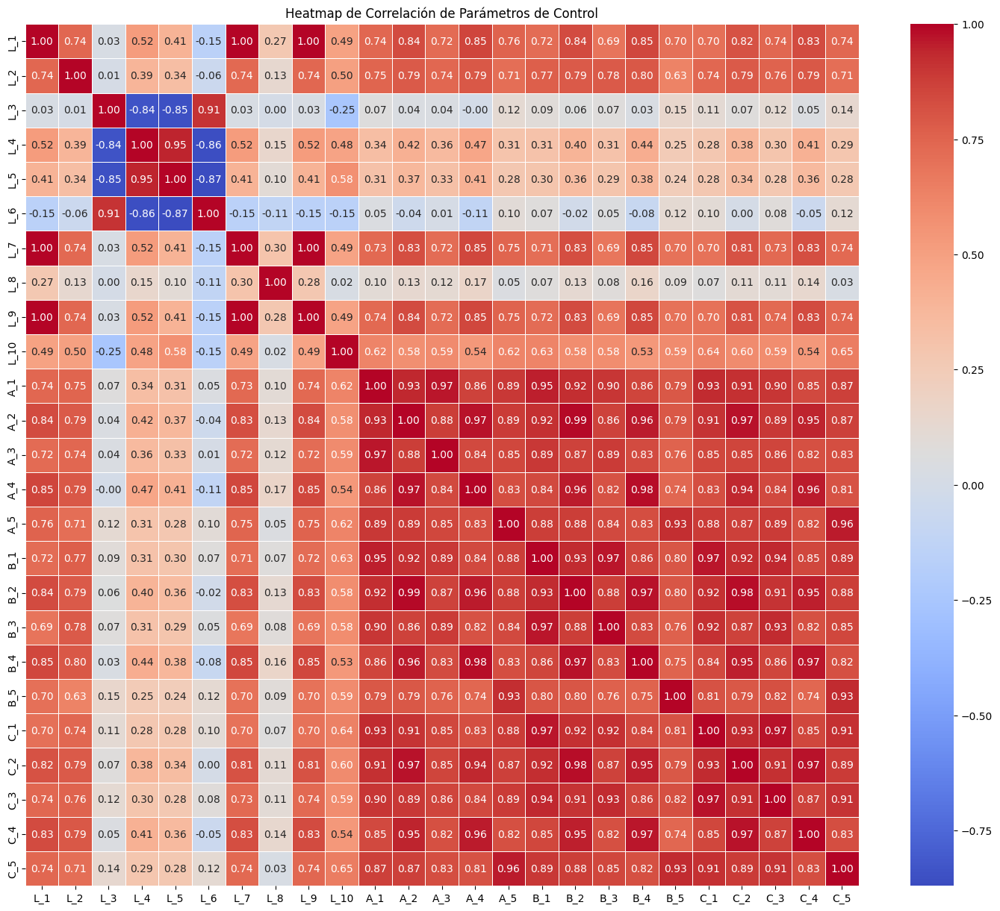

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación de las variables de control:
matriz_corr = df_monitoring[V_Monitorizados].corr()

# Configurar el tamaño de la figura:
plt.figure(figsize=(18, 15))

# Generar el heatmap:
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)

# Agregar un título descriptivo:
plt.title("Heatmap de Correlación de Parámetros de Control")
plt.show()


**Conclusión 8**

El heatmap de correlación revela que:

- **Correlaciones Significativas:**  
  Algunos sensores, especialmente los que miden aspectos similares o pertenecen al mismo componente, muestran relaciones muy fuertes (valores cercanos a 0.8–0.9), lo que indica que comparten información relevante. En contraste, otros sensores presentan correlaciones débiles o nulas y capturan señales independientes, aportando diversidad al modelo predictivo.

- **Estrategia para el Mantenimiento de Variables:**  
  En esta etapa resulta prudente conservar todas las variables de control para no omitir información potencialmente valiosa. Posteriormente, se podrá aplicar reducción de dimensionalidad (p.ej., mediante PCA) o técnicas de selección de variables para identificar y fusionar aquellas redundantes, simplificando así el modelo sin sacrificar su fiabilidad.

- **Impacto en el Análisis Predictivo:**  
  La matriz de correlación ayuda a comprender la dinámica del sistema al evidenciar tanto la conjunción de algunas señales (posible progresión hacia el fallo) como la independencia de otras, lo que orienta el diseño de estrategias de modelado más eficientes.
>
>

**En resumen, aunque existen redundancias, el enfoque inicial es mantener la totalidad de las variables; el análisis de correlación servirá de guía para optimizar el modelo en fases posteriores.**



**Scatter Plots**

---

Interpretación

- **Ejes X e Y:**  
  - **Eje X:** Se coloca el parámetro base. Esta variable actúa como referencia para posicionar los puntos horizontalmente.  
  - **Eje Y:** Se ubican los sensores comparadores, cada uno con un color fijo para facilitar su identificación.

- **Puntos y Colores:**  
  - **Densidad de puntos:** Una gran concentración de puntos (color saturado) en una zona indica una relación muy consistente entre el parámetro base y el sensor comparador.  
  - **Dispersión:** Zonas con menor saturación muestran que los valores están más dispersos, sugiriendo una relación más variable.

- **Estructura del Gráfico:**  
  - **Filas:** Cada fila corresponde a un experimento distinto, lo que permite observar cómo varía la relación entre el parámetro base y los sensores en diferentes experimentos.  
  - **Columnas:** Cada columna representa la comparación entre el parámetro base y un sensor comparador específico, facilitando la evaluación de la consistencia de dicha relación a lo largo del run-to-failure.

**Resumen:**  
El scatter plot muestra cómo el parámetro base se relaciona con otros sensores. La posición en el eje X y Y, sumado a la saturación del color, indica si la relación es consistente o variable, y la estructura en filas y columnas permite comparar estos patrones entre diferentes experimentos.

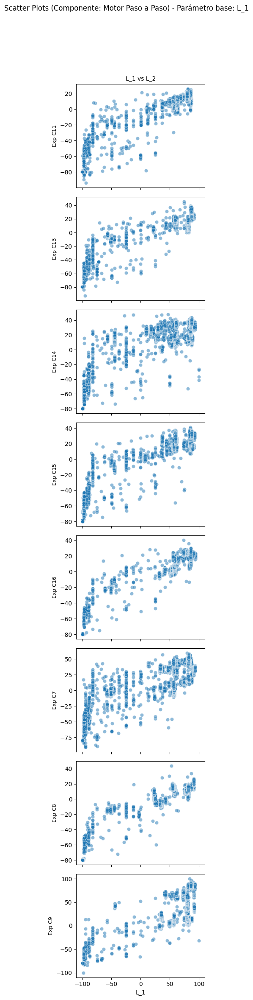

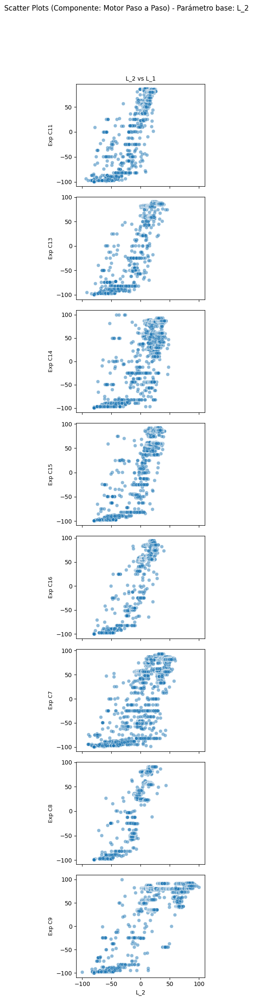

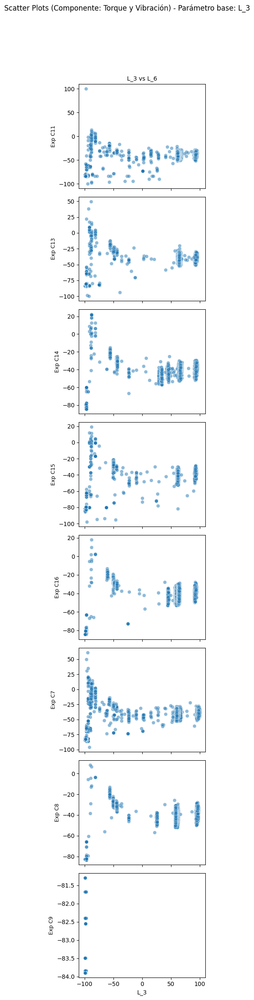

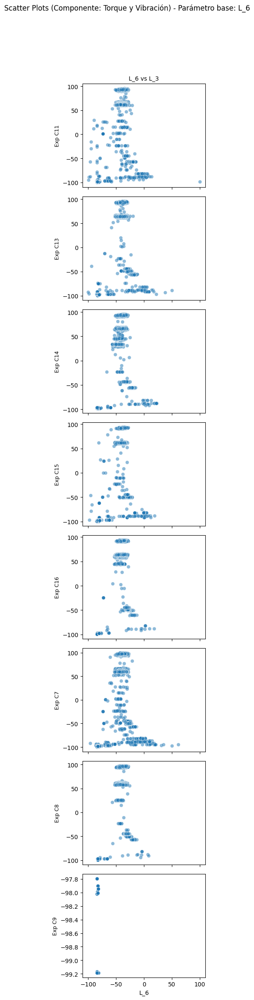

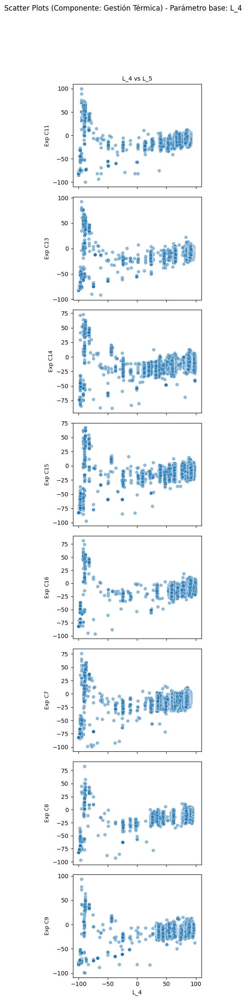

...

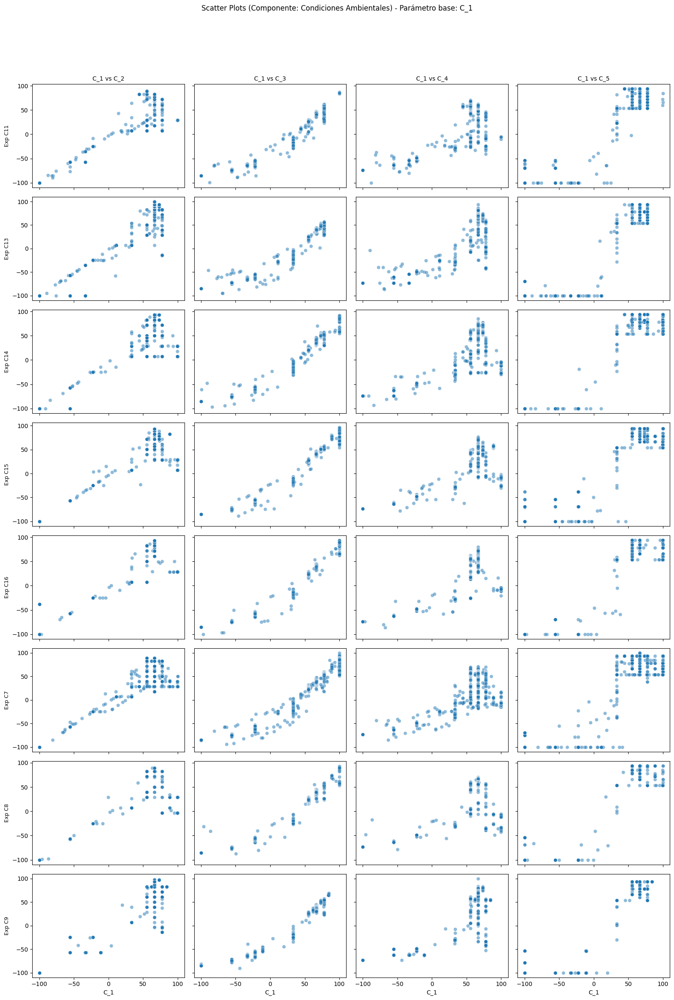

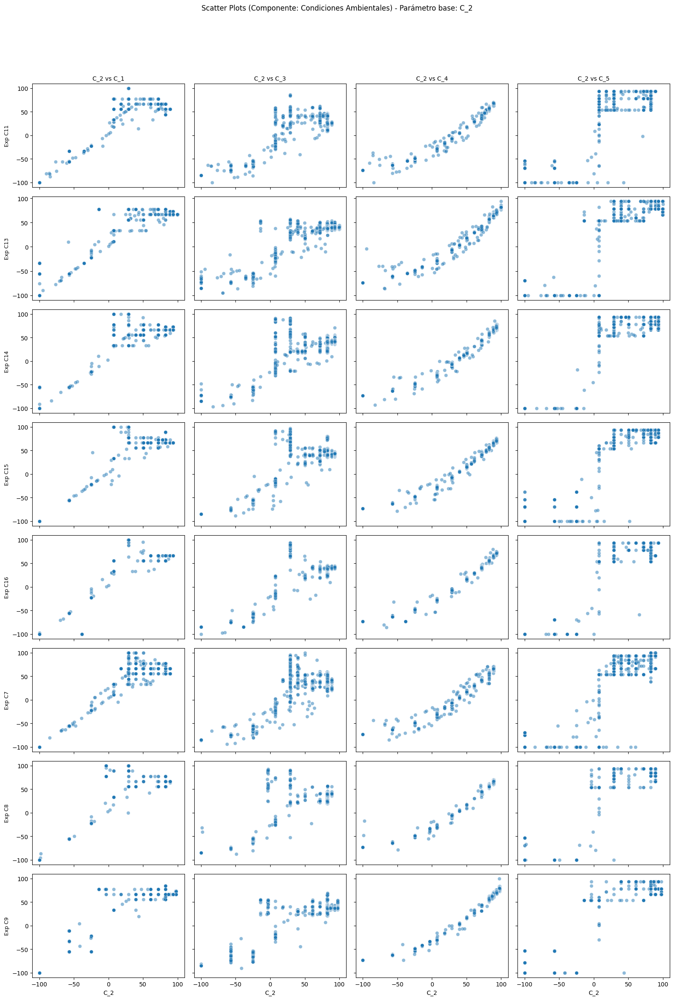

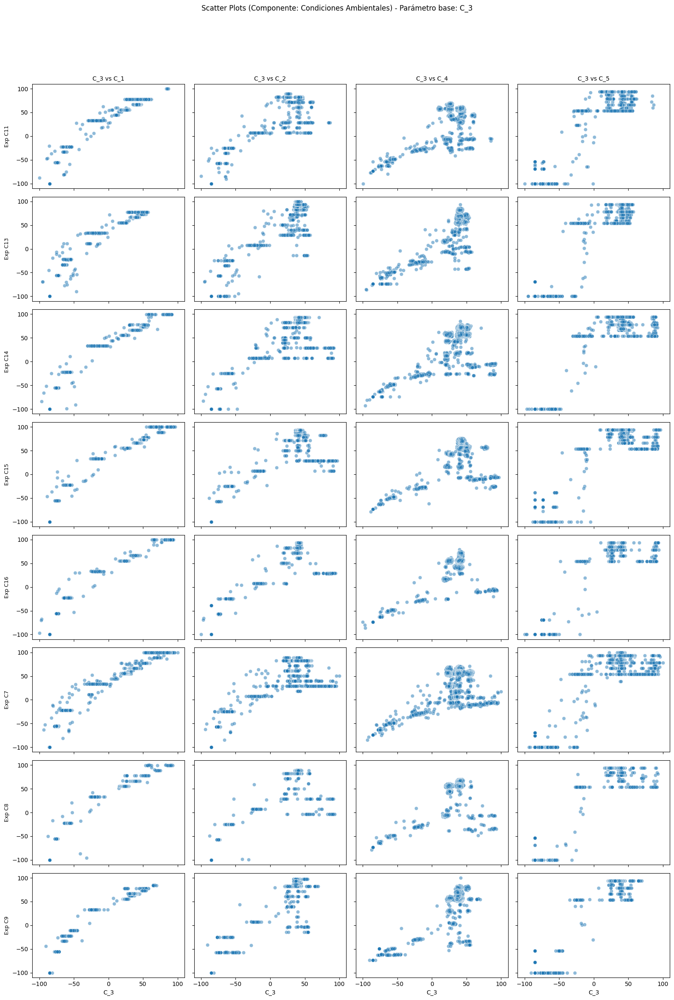

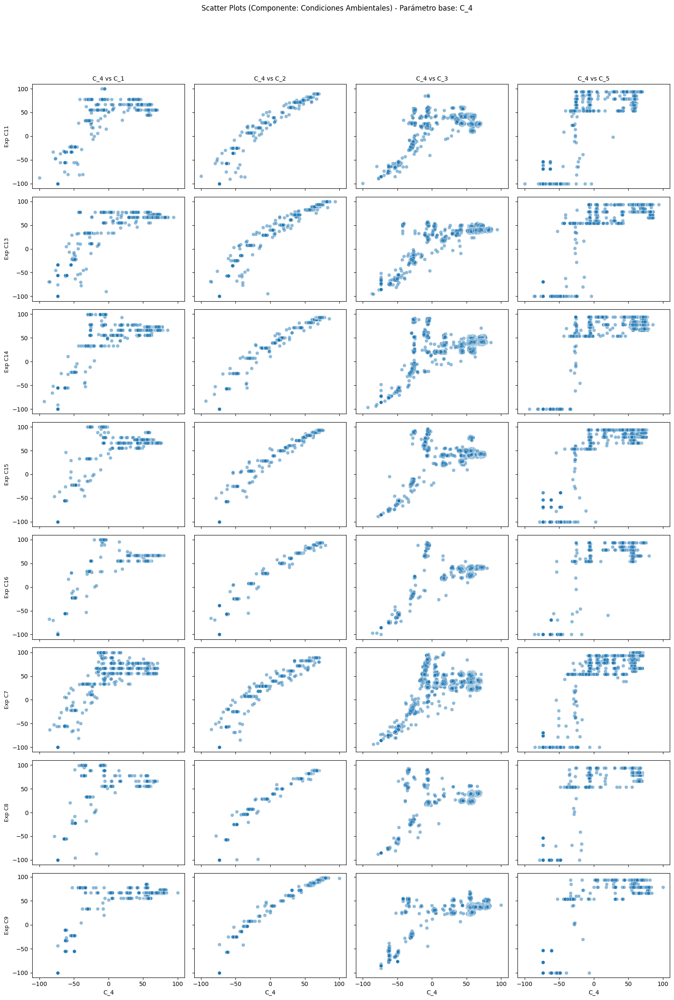

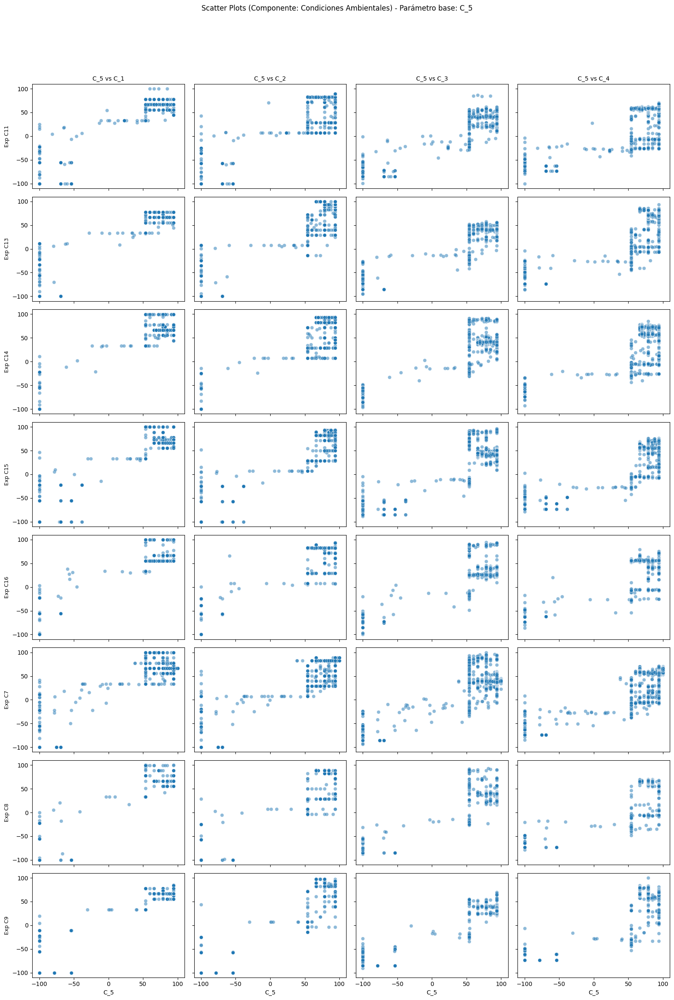

In [ ]:
def plot_scatter_component(comp_name, df_monitoring, componentes, experiment_col='experiment_ID'):
    """
    Parámetros:
      comp_name (str): Nombre del componente (clave en el diccionario 'componentes').
      df_monitoring (pd.DataFrame): DataFrame que contiene, entre otras, la columna con el identificador de experimento.
      componentes (dict): Diccionario cuyo valor es una lista de sensores para cada componente.
      experiment_col (str): Nombre de la columna que contiene el identificador de experimento (por defecto 'experiment_ID').
    """
    if comp_name not in componentes:
        print(f"El componente '{comp_name}' no se encuentra en el diccionario.")
        return

    sensores = componentes[comp_name]
    if len(sensores) < 2:
        print(f"El componente '{comp_name}' tiene menos de 2 sensores; no es posible comparar.")
        return

    # Creamos una lista ordenada de los experimentos
    experiments = sorted(df_monitoring[experiment_col].unique())

    # Para cada sensor del componente, lo usamos como base para comparar con el resto
    for base_sensor in sensores:
        comparadores = [s for s in sensores if s != base_sensor]
        if not comparadores:
            continue

        n_rows = len(experiments)     # Cada fila corresponde a un experimento
        n_cols = len(comparadores)     # Cada columna, a un scatter plot: base_sensor vs comparador

        # Utilizamos sharex y sharey para que la escala sea la misma en cada columna y fila respectivamente.
        fig, axes = plt.subplots(n_rows, n_cols,
                                 figsize=(4*n_cols, 3*n_rows),
                                 squeeze=False,
                                 sharex='col', sharey='row')

        # Recorremos cada experimento (fila)
        for i, exp in enumerate(experiments):
            df_exp = df_monitoring[df_monitoring[experiment_col] == exp]
            # Recorrer cada comparador (columna)
            for j, comp_sensor in enumerate(comparadores):
                ax = axes[i][j]
                sns.scatterplot(
                    x=df_exp[base_sensor],
                    y=df_exp[comp_sensor],
                    ax=ax,
                    alpha=0.5
                )
                # Etiquetamos solo la primera fila (para identificar la comparación)
                if i == 0:
                    ax.set_title(f"{base_sensor} vs {comp_sensor}", fontsize=10)
                # En la primera columna de cada fila, mostramos el identificador de experimento
                if j == 0:
                    ax.set_ylabel(f"Exp {exp}", fontsize=9)
                else:
                    ax.set_ylabel("")
                # Sólo dejamos etiquetas en la parte inferior de la última fila
                if i == n_rows - 1:
                    ax.set_xlabel(base_sensor)
                else:
                    ax.set_xlabel("")

        fig.suptitle(f"Scatter Plots (Componente: {comp_name}) - Parámetro base: {base_sensor}", fontsize=12)
        plt.tight_layout(rect=[0, 0, 1, 0.93])
        plt.show()

# Ejemplo de uso: iterar por cada componente
for comp in componentes.keys():
    plot_scatter_component(comp, df_monitoring, componentes)


**Conclusión 9**

- **Relación en condiciones normales:**  
  En condiciones de funcionamiento óptimo, muchos sensores se comportan de manera similar y muestran una relación casi lineal entre sí. Esto indica que ambos proporcionan información coherente sobre el estado del sistema.

- **Cambios cerca del fallo:**  
  Cuando el sistema se acerca a una situación crítica, se observa que la relación entre los sensores se vuelve menos clara y se dispersa más. Este cambio en el patrón es un indicativo de que el sistema está entrando en una fase de deterioro.

- **Presencia de puntos extremos (outliers):**  
  Con frecuencia aparecen puntos aislados que se alejan de la tendencia general. Estos outliers pueden ser señales tempranas de condiciones anómalas o problemas inminentes en el funcionamiento del equipo.







**Conclusiones de la Fase 1**

---

- **Evolución Temporal Individual:**  
  Se observó que cada experimento presenta una evolución temporal propia. Por ello, se recomienda reiniciar el conteo del tiempo por experimento e incorporar la variable `experiment_ID` en el modelado. De esta forma, el modelo aprende las particularidades de cada ciclo sin confundir patrones.

- **Detección de Anomalías y Outliers:**  
  Los gráficos suavizados evidencian picos y caídas abruptas que abren oportunidades para identificar “change points” y anomalías. Dado que los ensayos run‑to‑failure naturalmente presentan numerosos outliers, se opta por preservarlos utilizando técnicas de imputación con mediana en lugar de eliminarlos, asegurando que no se pierda información crítica.

- **Consistencia y Relaciones entre Sensores:**  
  Las visualizaciones (scatter plots, heatmaps) muestran que las relaciones entre sensores son consistentes en condiciones normales, mientras que se alteran cuando el sistema se aproxima al fallo. Estos hallazgos respaldan el uso de modelos como RandomForest y técnicas interpretables (Permutation Importance, SHAP) para identificar los indicadores clave.

- **Selección y Reducción de Variables:**  
  Aunque el heatmap revela redundancias por correlación, se recomienda mantener inicialmente todas las variables de control y, en fases posteriores, aplicar reducción dimensional para optimizar el modelado sin perder la riqueza informativa.

**Resumen:**  
Los hallazgos sugieren que un tratamiento individualizado por experimento—integrado mediante el uso de `experiment_ID`—, la preservación de outliers y el empleo de modelos interpretables son estrategias fundamentales para desarrollar un sistema predictivo ante condiciones críticas.


# **Fase 2: Interpretación de Datos y Relaciones entre Variables**

Lo que se estudia aquí es el determinar si existen patrones consistentes entre ciertas variables.

**Configurar Mapeo de Sensores por Componente**

---

* **Para Componentes con Dos Sensores crear un gráfico de líneas por cada experimento que trace ambos sensores en el mismo gráfico**

Procesando experiment: C7
  Graficando componente: Motor Paso a Paso


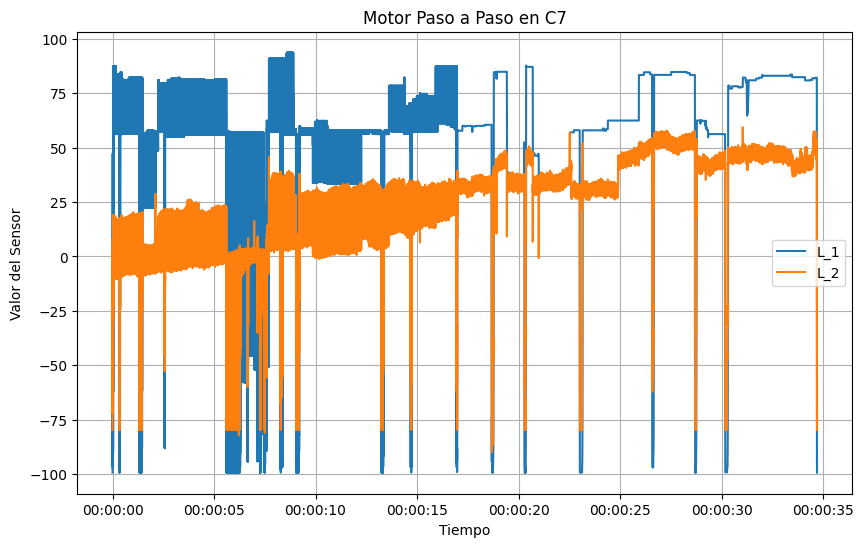

  Graficando componente: Torque y Vibración


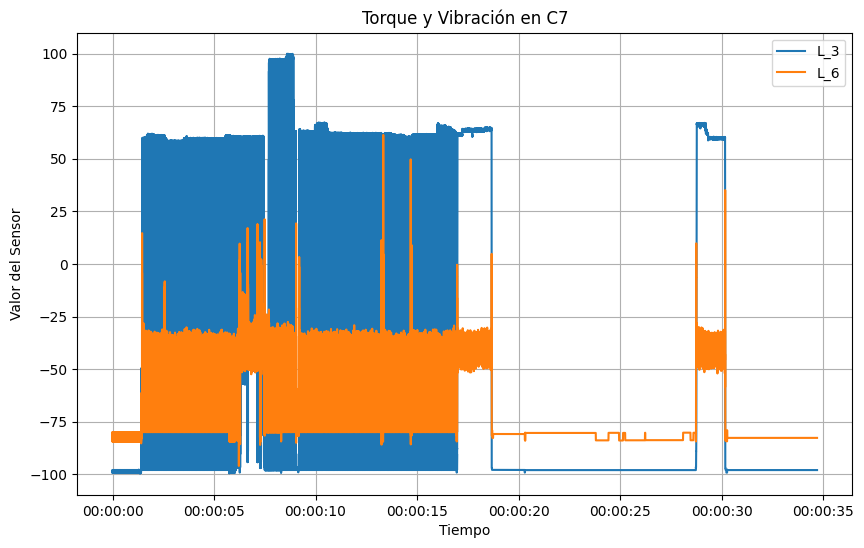

  Graficando componente: Gestión Térmica


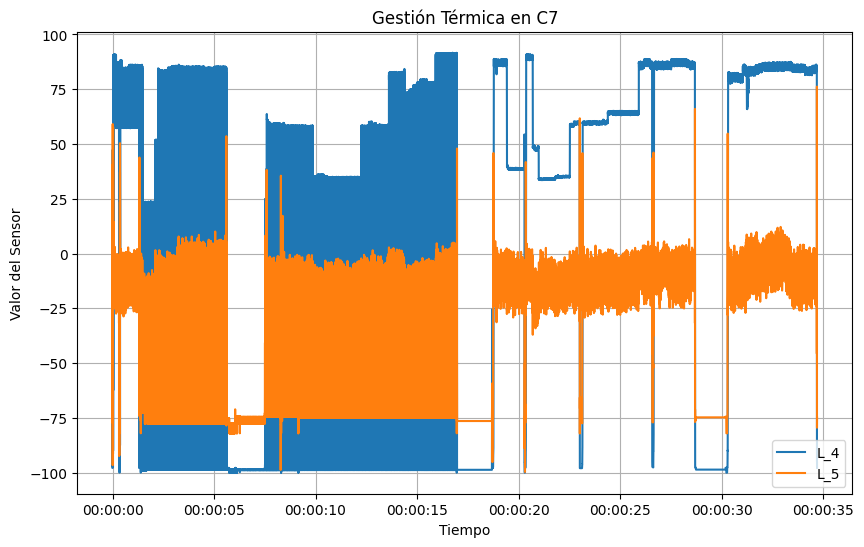

  Graficando componente: Electrónica de Control


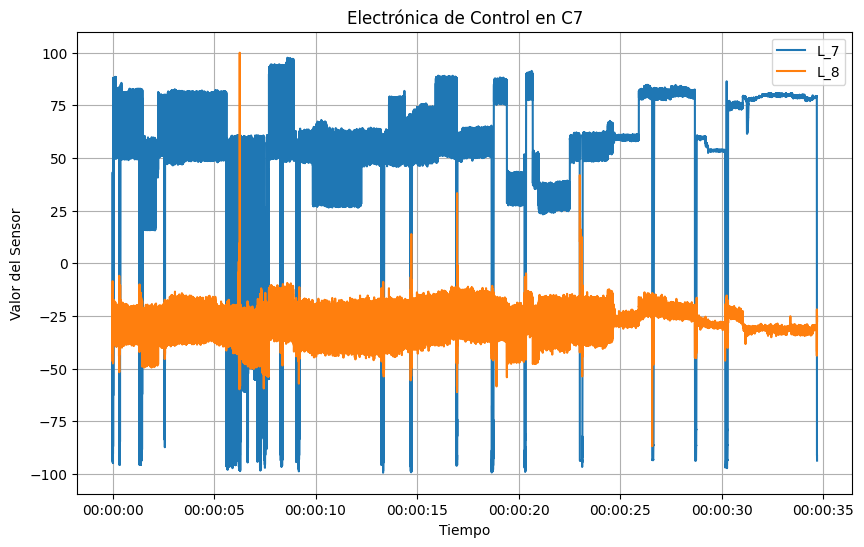

  Graficando componente: Lubricación y Desgaste


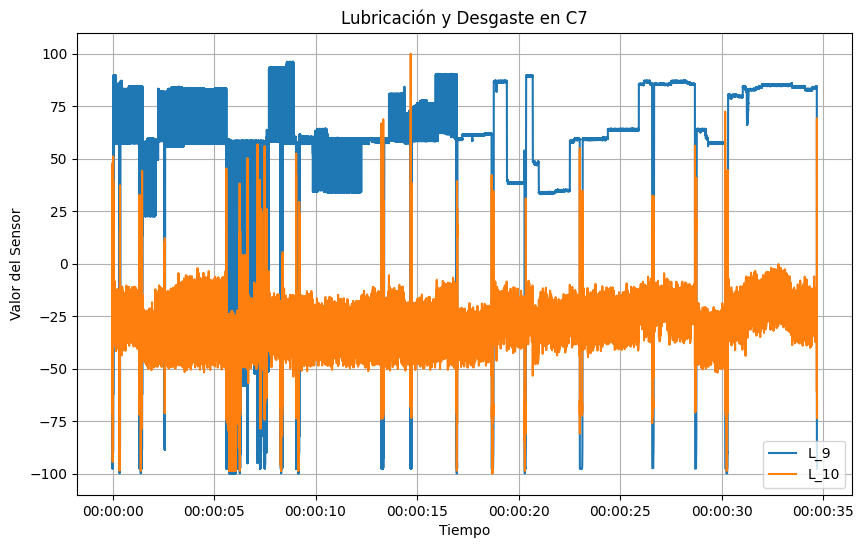

Procesando experiment: C8
  Graficando componente: Motor Paso a Paso


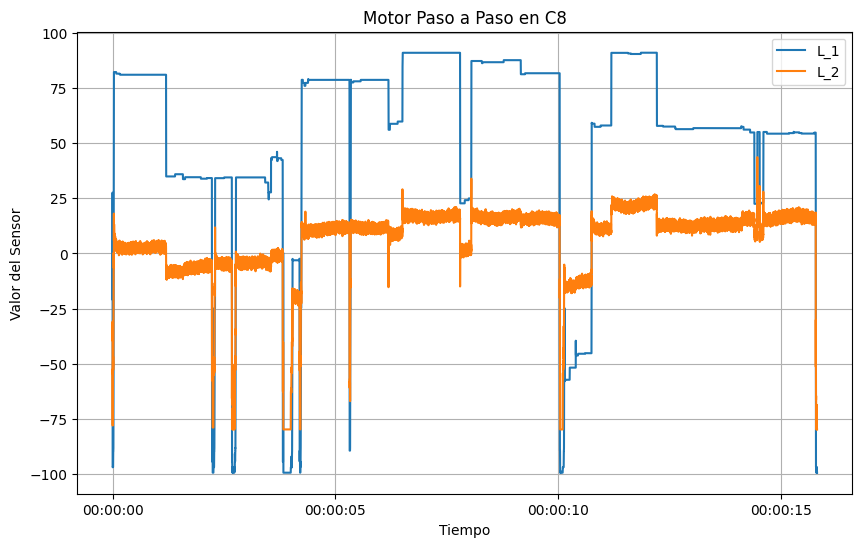

  Graficando componente: Torque y Vibración


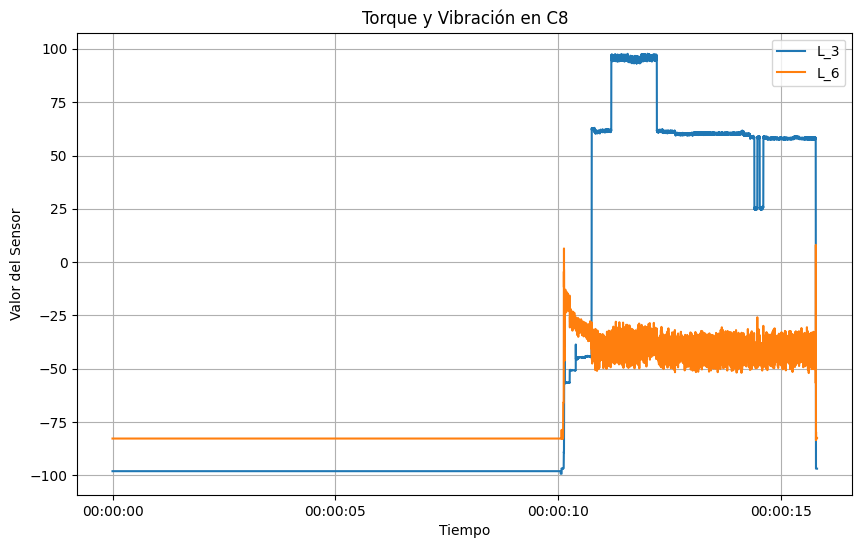

  Graficando componente: Gestión Térmica


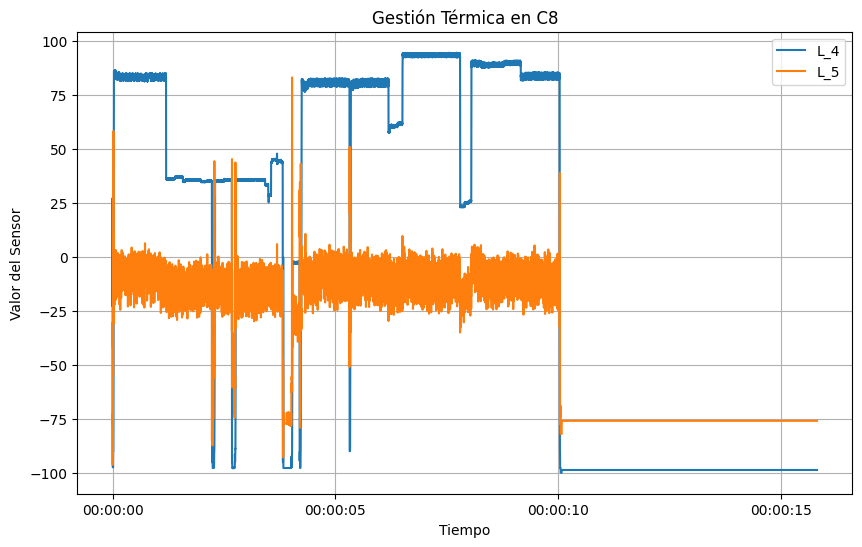

  Graficando componente: Electrónica de Control


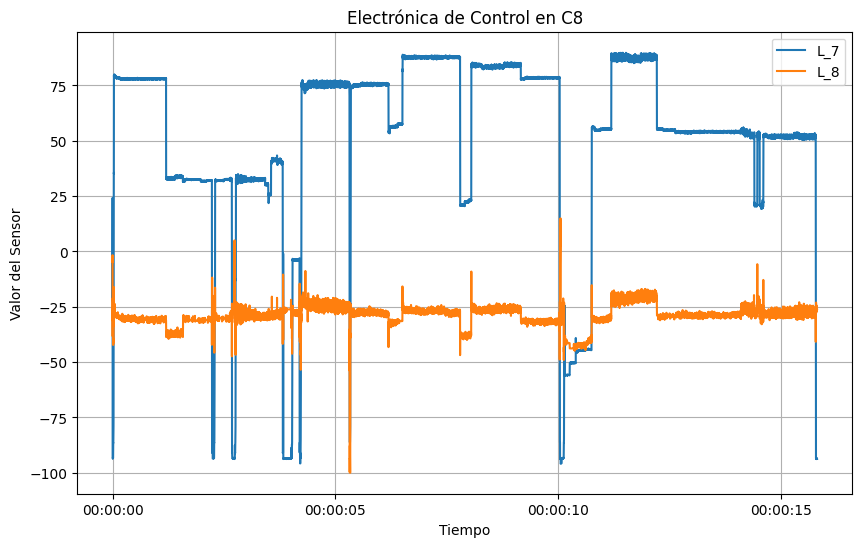

  Graficando componente: Lubricación y Desgaste


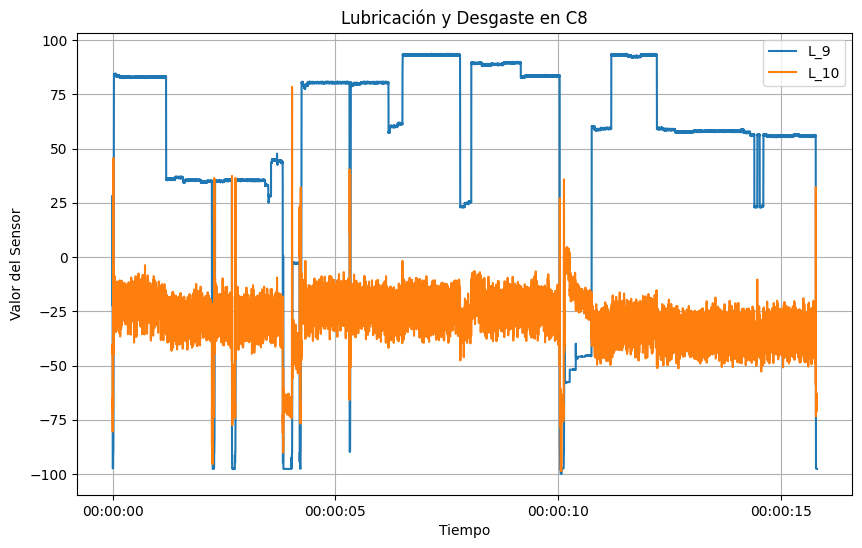

Procesando experiment: C9
  Graficando componente: Motor Paso a Paso


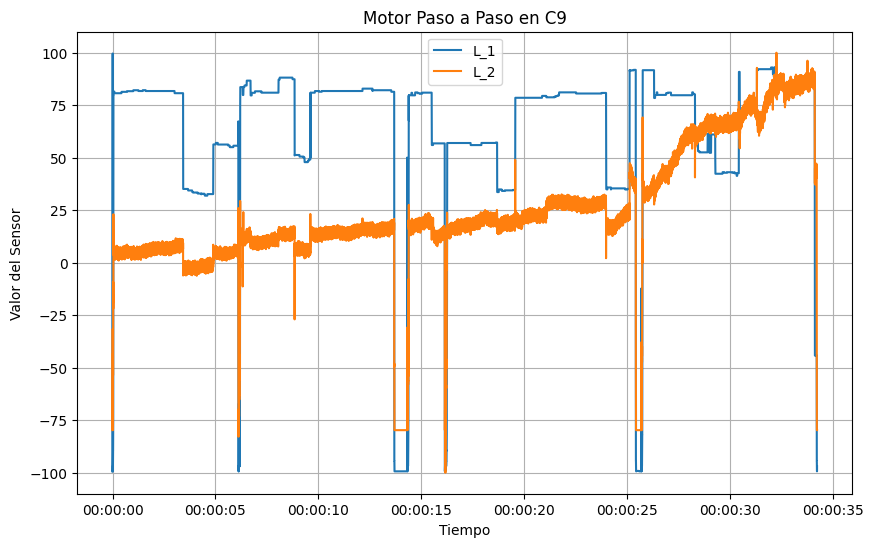

  Graficando componente: Torque y Vibración


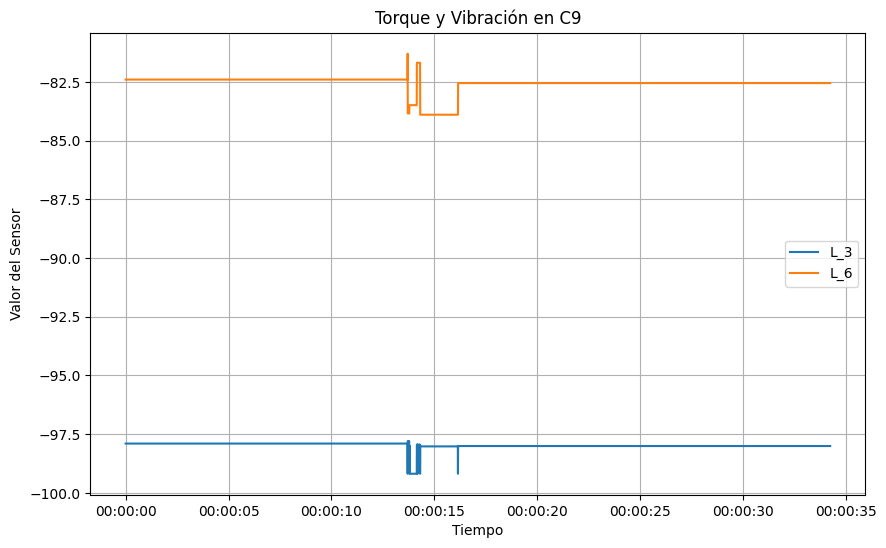

  Graficando componente: Gestión Térmica


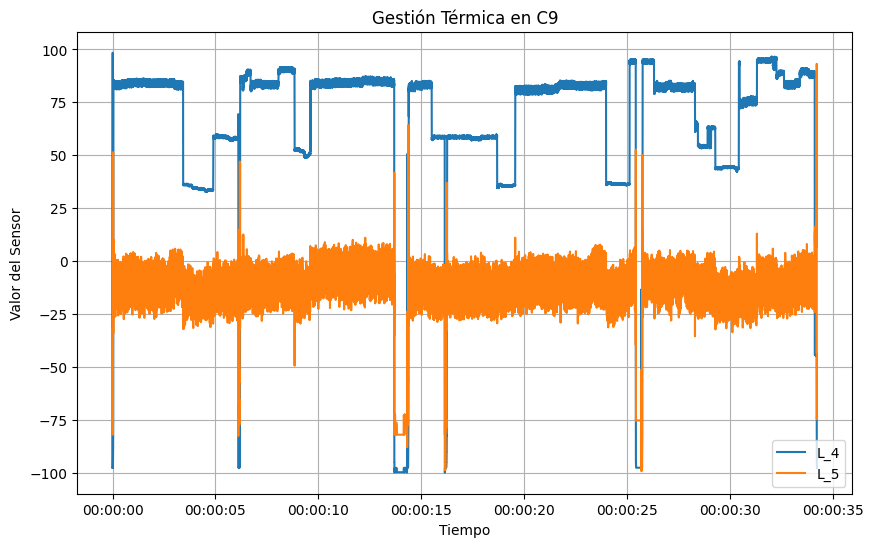

  Graficando componente: Electrónica de Control


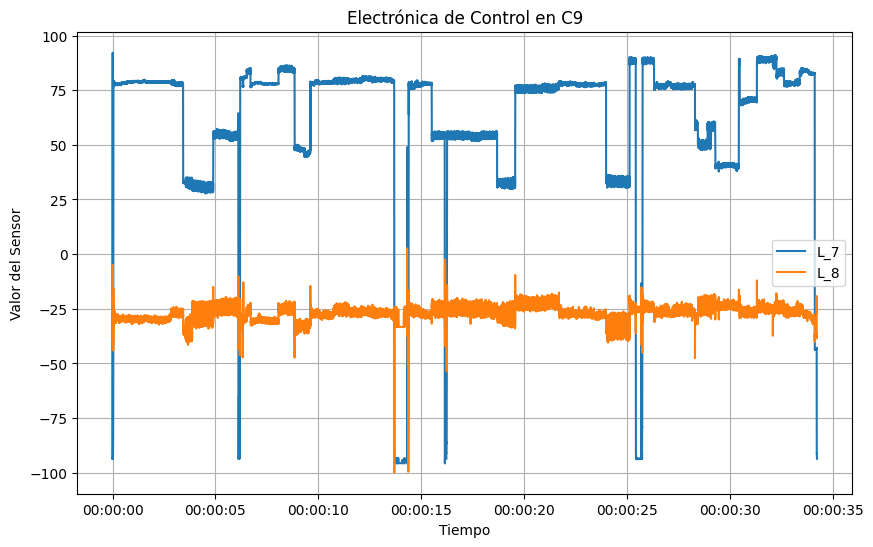

  Graficando componente: Lubricación y Desgaste


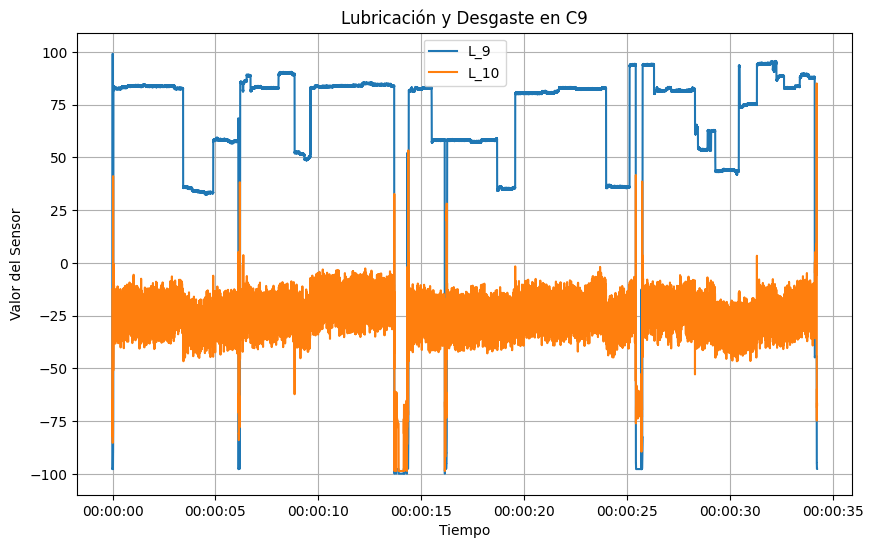

Procesando experiment: C11
  Graficando componente: Motor Paso a Paso


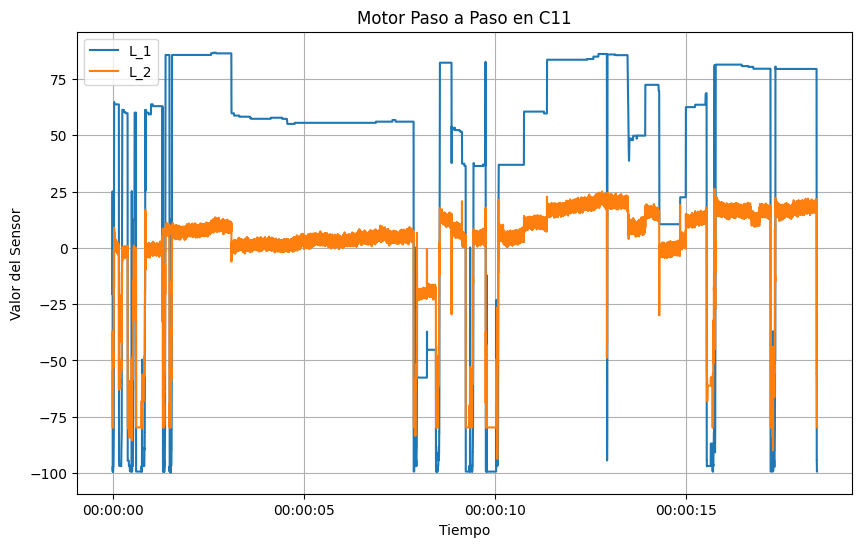

  Graficando componente: Torque y Vibración


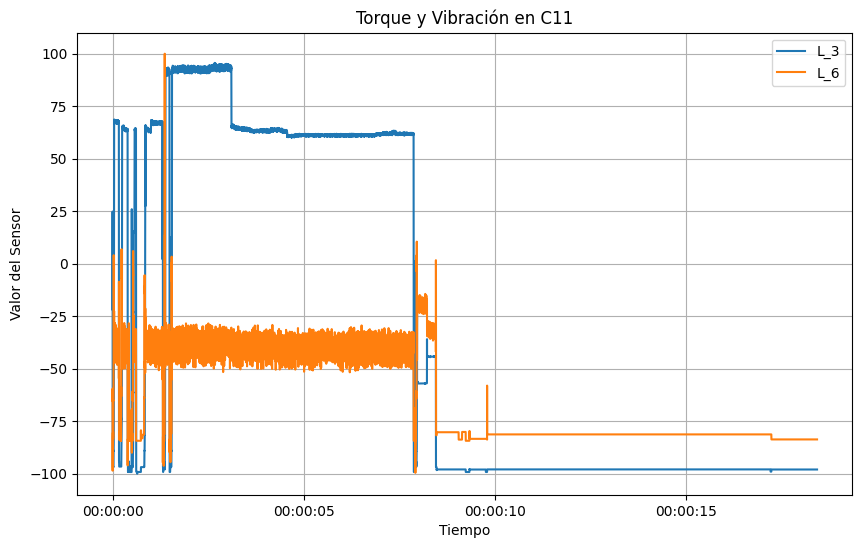

  Graficando componente: Gestión Térmica


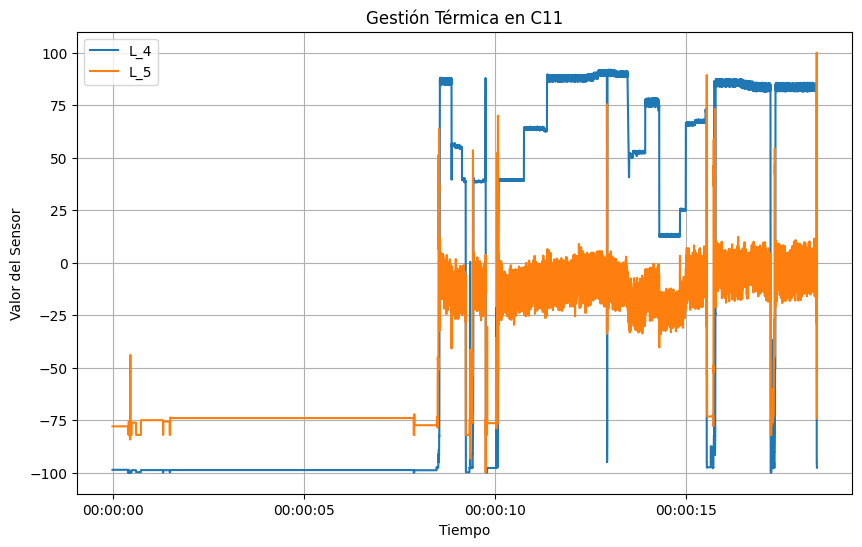

  Graficando componente: Electrónica de Control


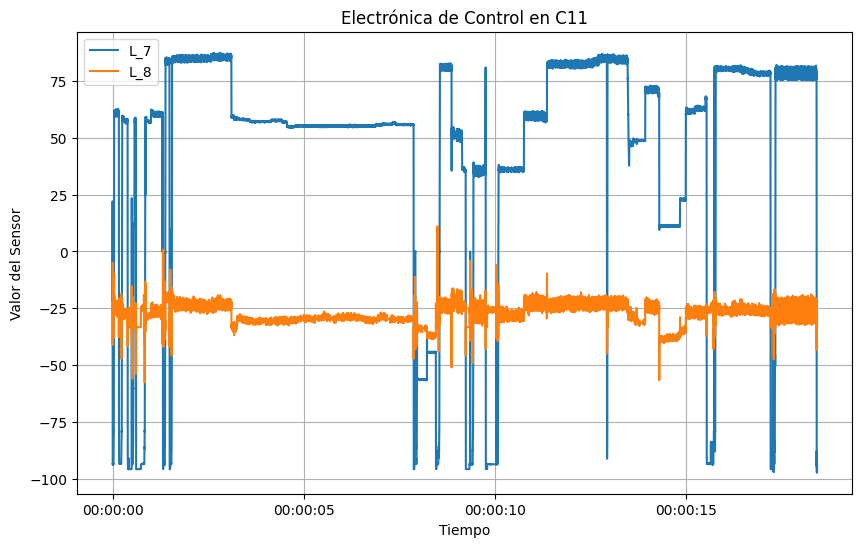

  Graficando componente: Lubricación y Desgaste


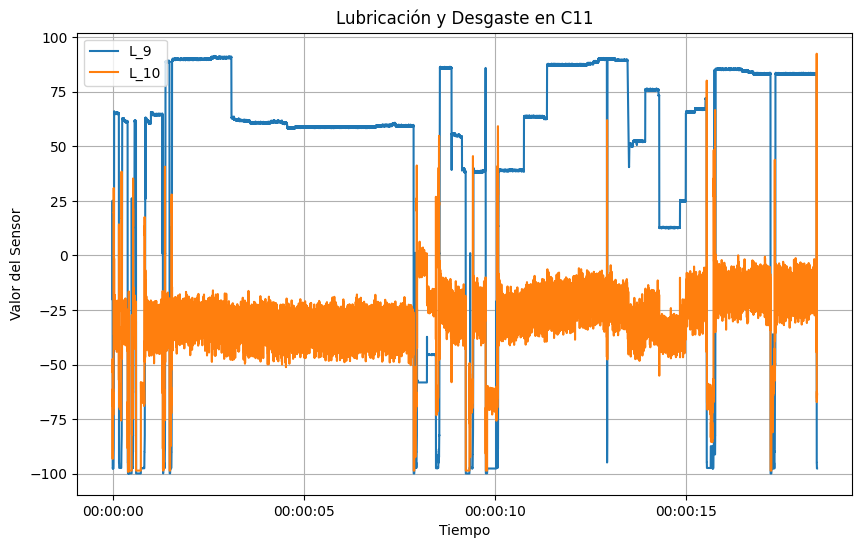

Procesando experiment: C13
  Graficando componente: Motor Paso a Paso


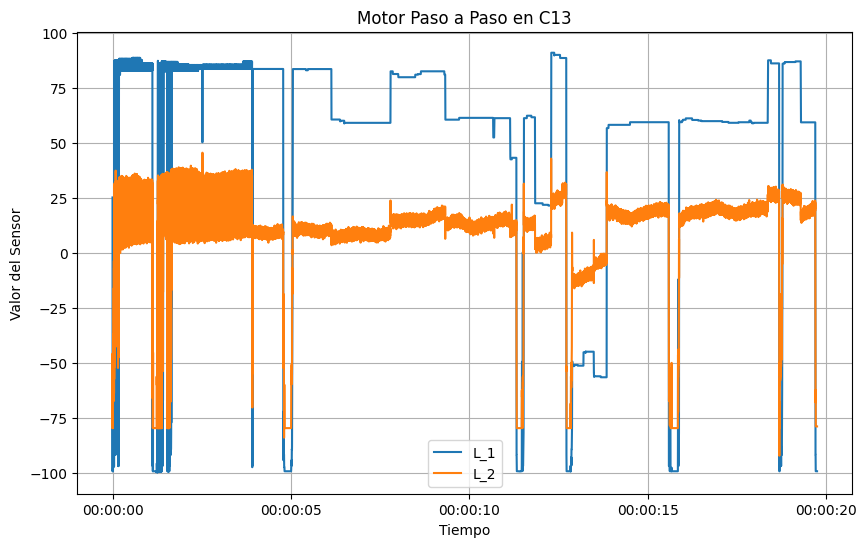

  Graficando componente: Torque y Vibración


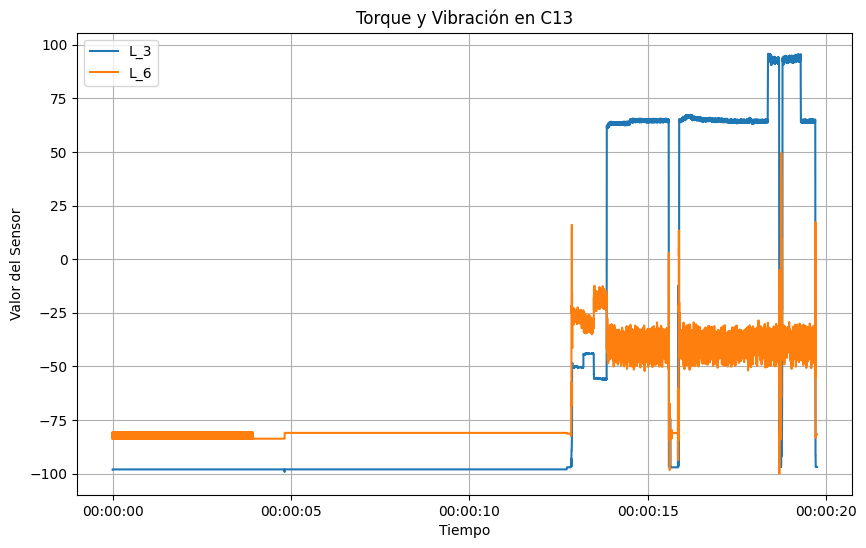

  Graficando componente: Gestión Térmica


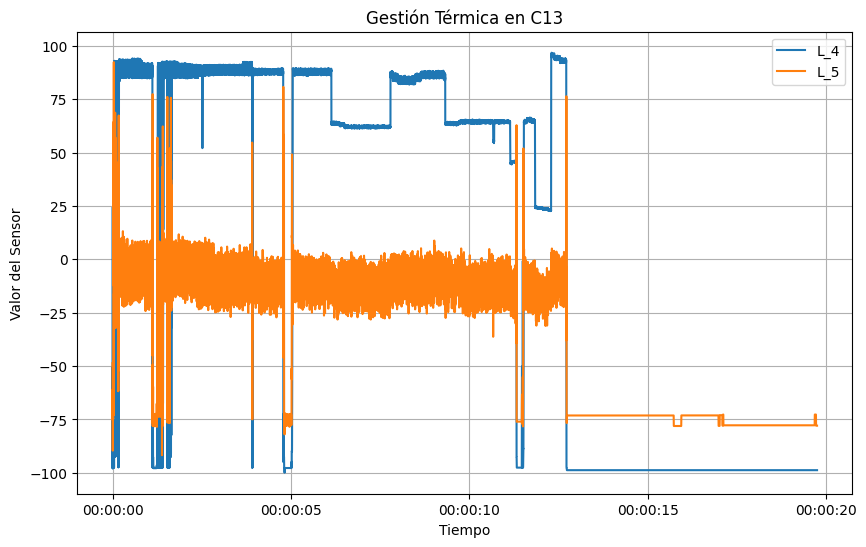

  Graficando componente: Electrónica de Control


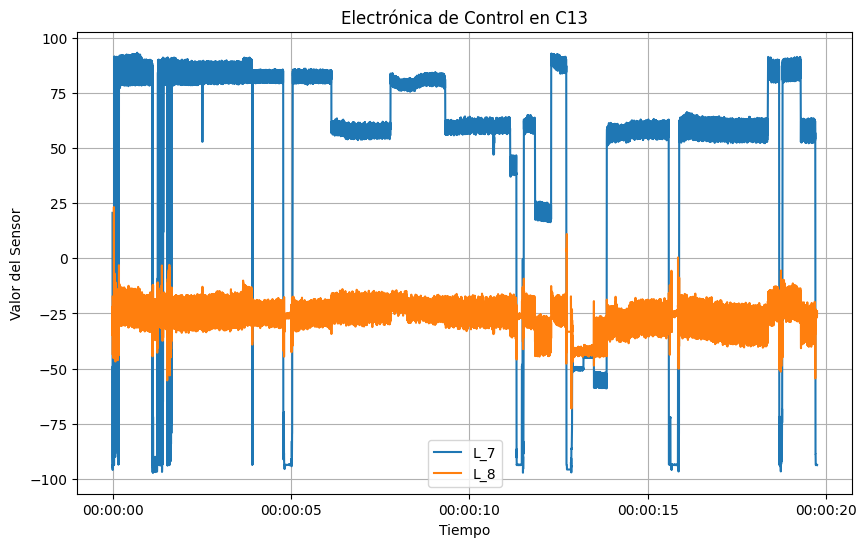

  Graficando componente: Lubricación y Desgaste


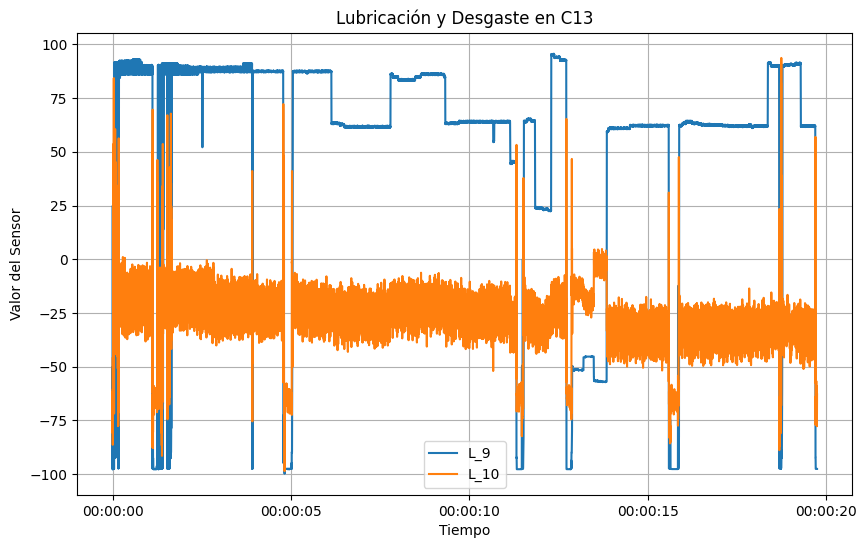

Procesando experiment: C14
  Graficando componente: Motor Paso a Paso


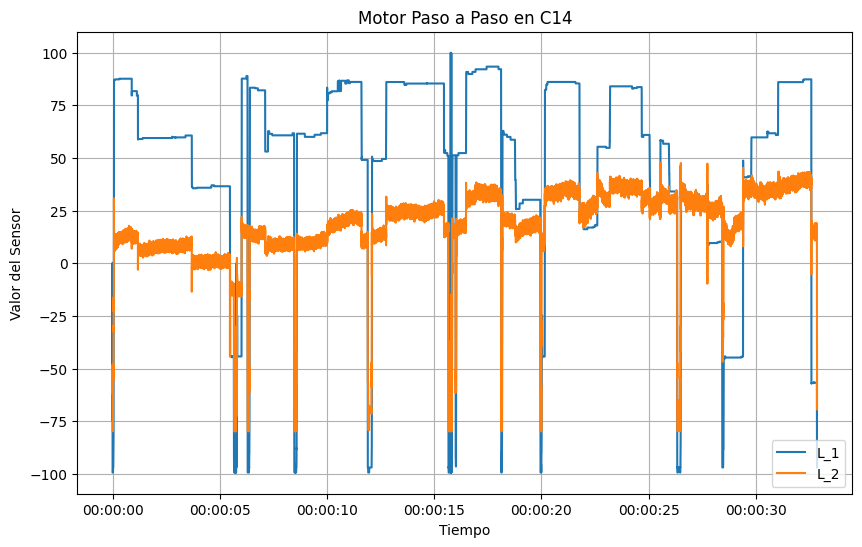

  Graficando componente: Torque y Vibración


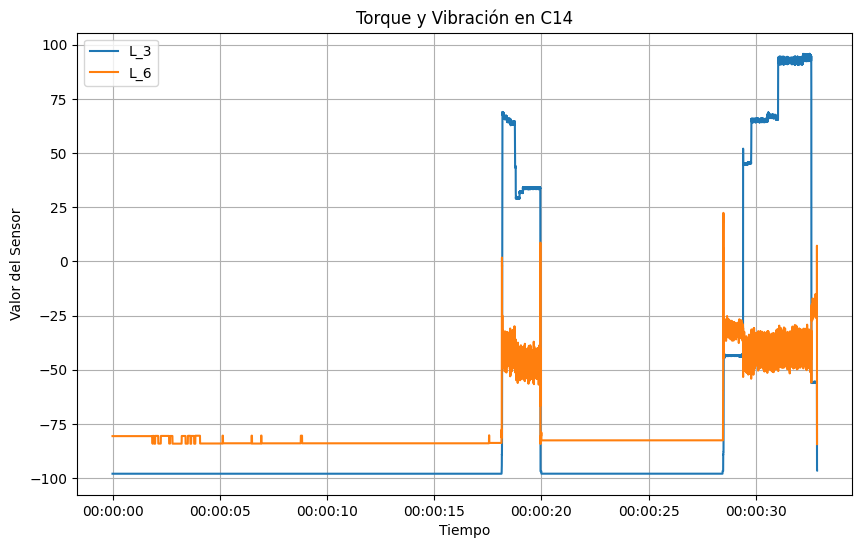

  Graficando componente: Gestión Térmica


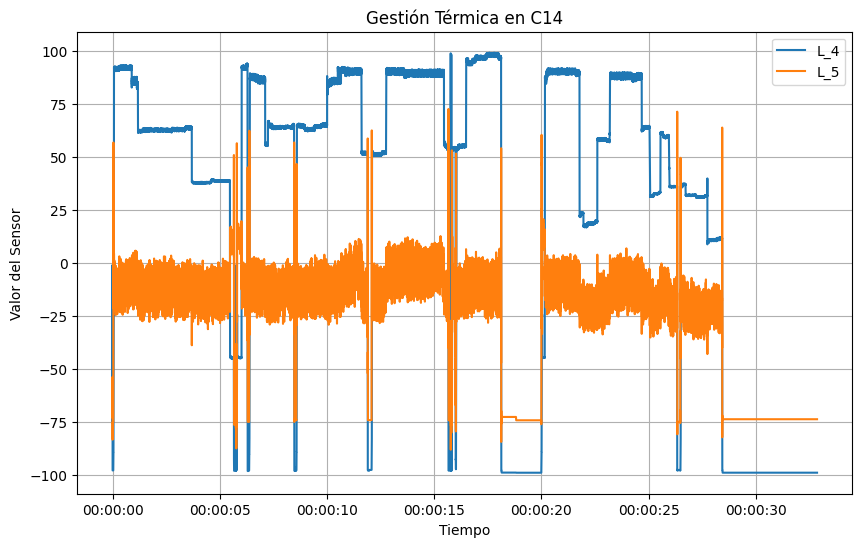

  Graficando componente: Electrónica de Control


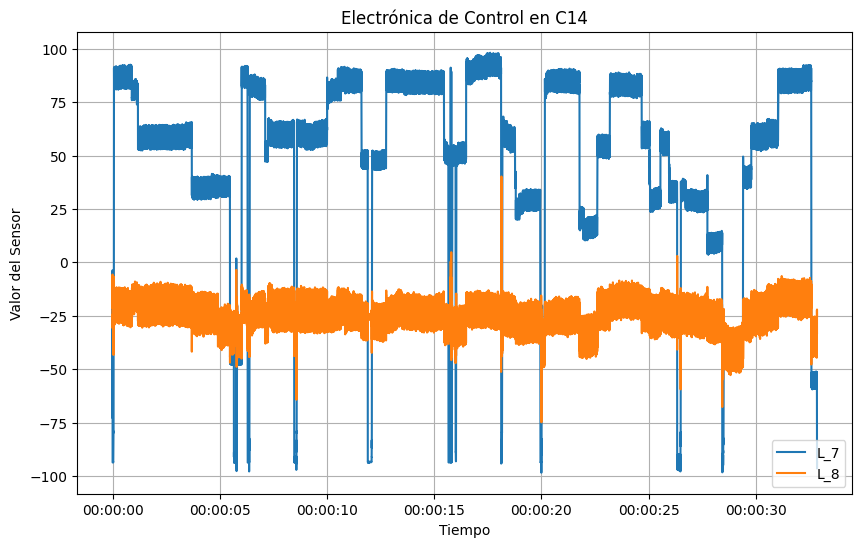

  Graficando componente: Lubricación y Desgaste


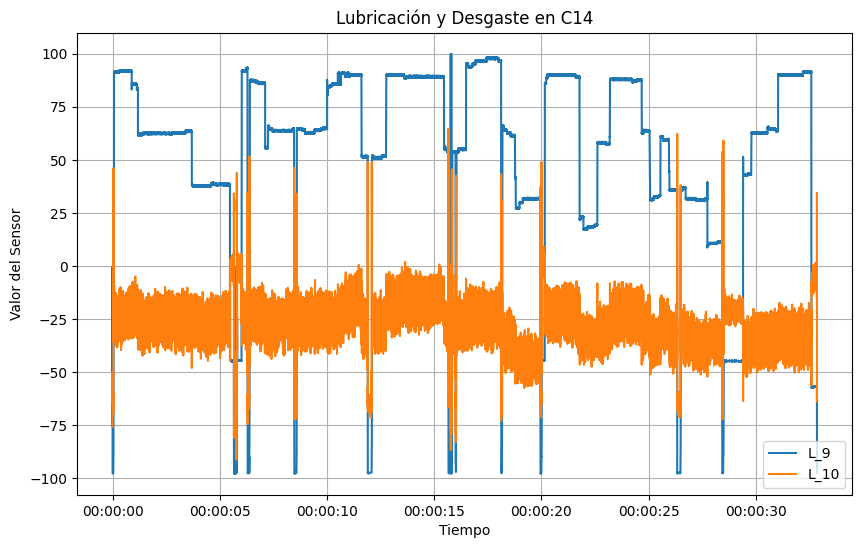

Procesando experiment: C15
  Graficando componente: Motor Paso a Paso


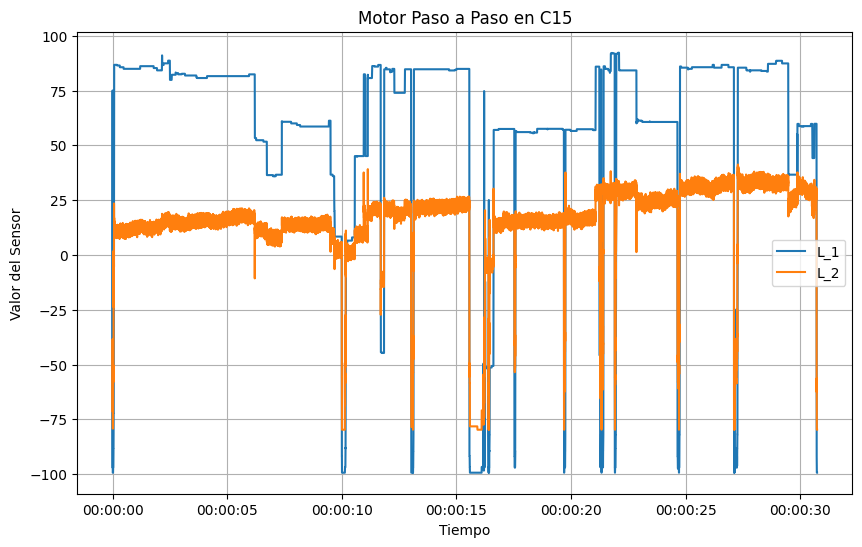

  Graficando componente: Torque y Vibración


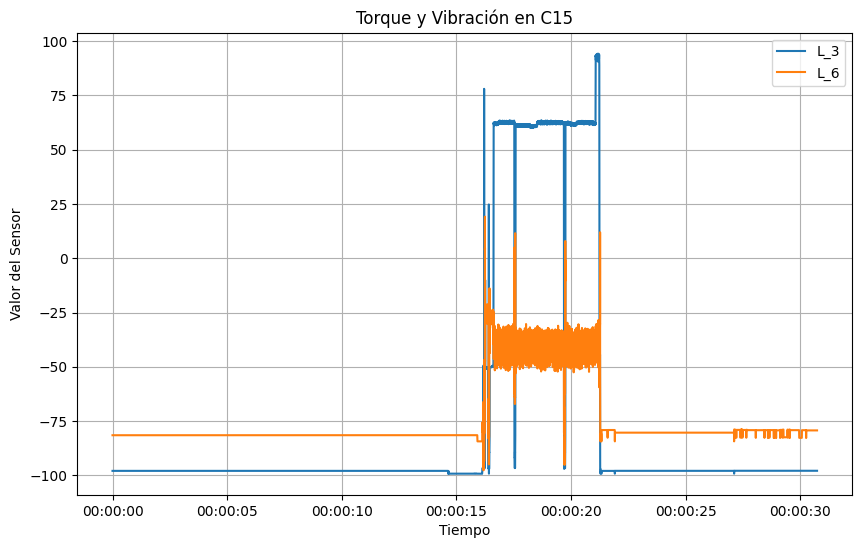

  Graficando componente: Gestión Térmica


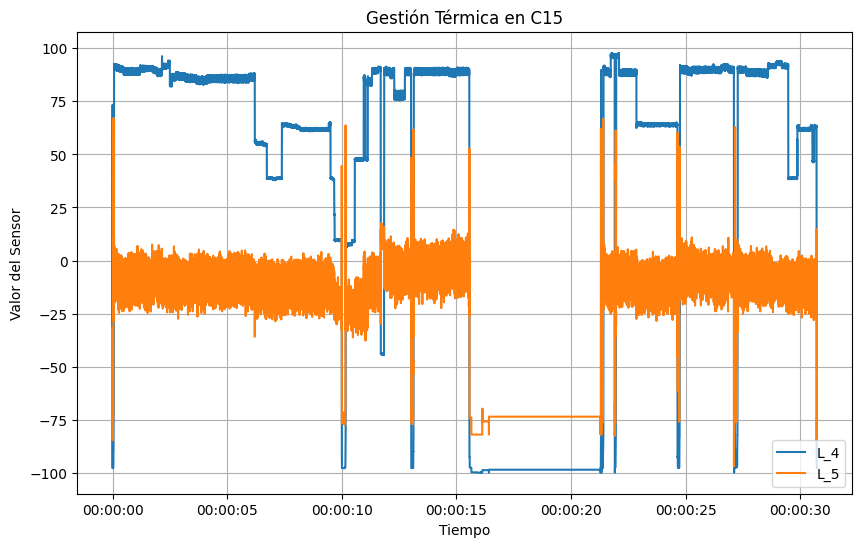

  Graficando componente: Electrónica de Control


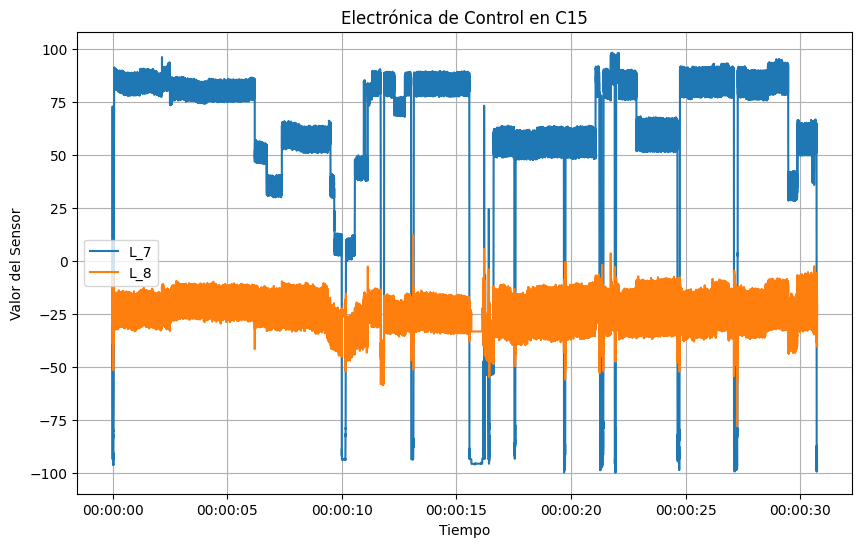

  Graficando componente: Lubricación y Desgaste


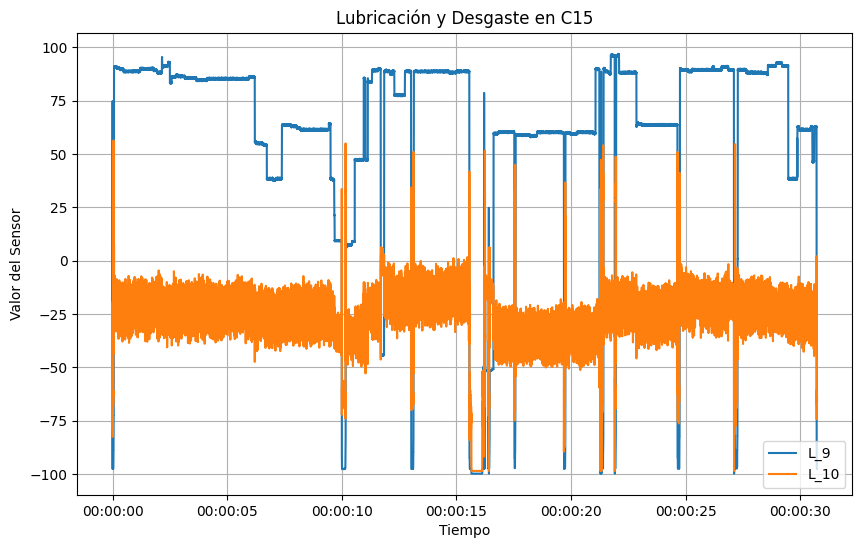

Procesando experiment: C16
  Graficando componente: Motor Paso a Paso


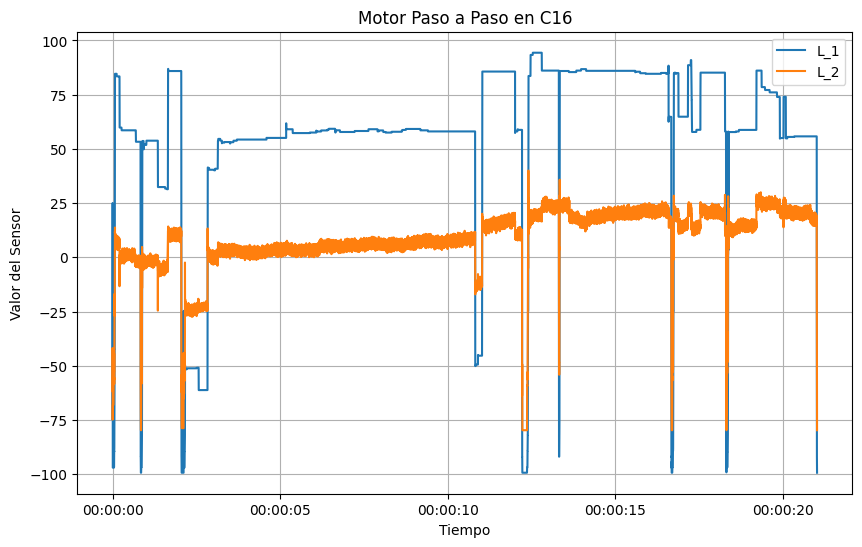

  Graficando componente: Torque y Vibración


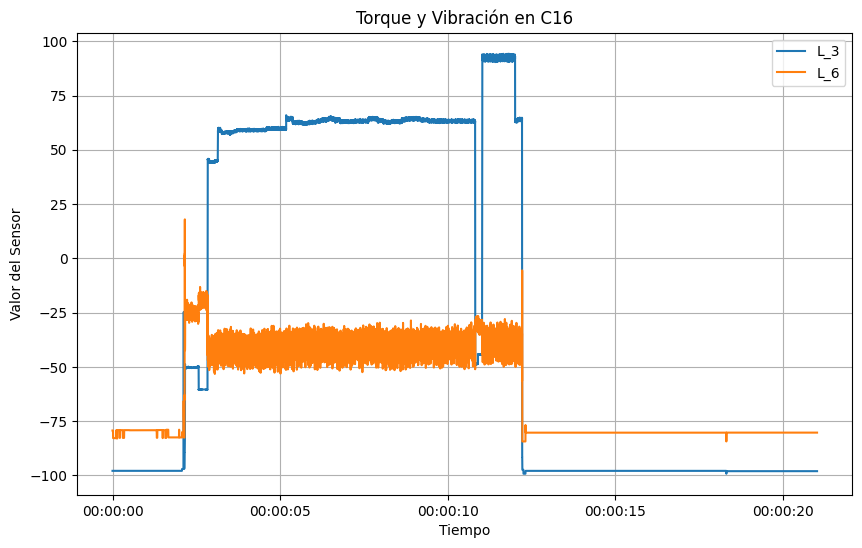

  Graficando componente: Gestión Térmica


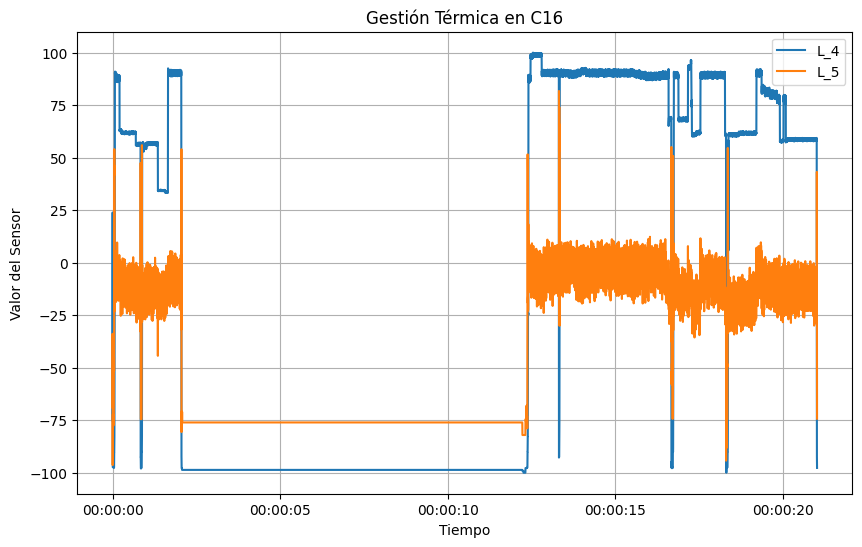

  Graficando componente: Electrónica de Control


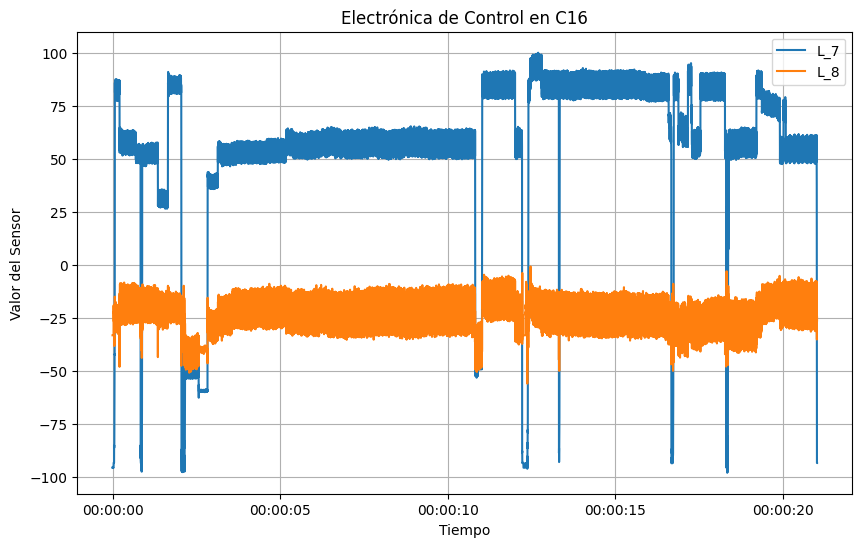

  Graficando componente: Lubricación y Desgaste


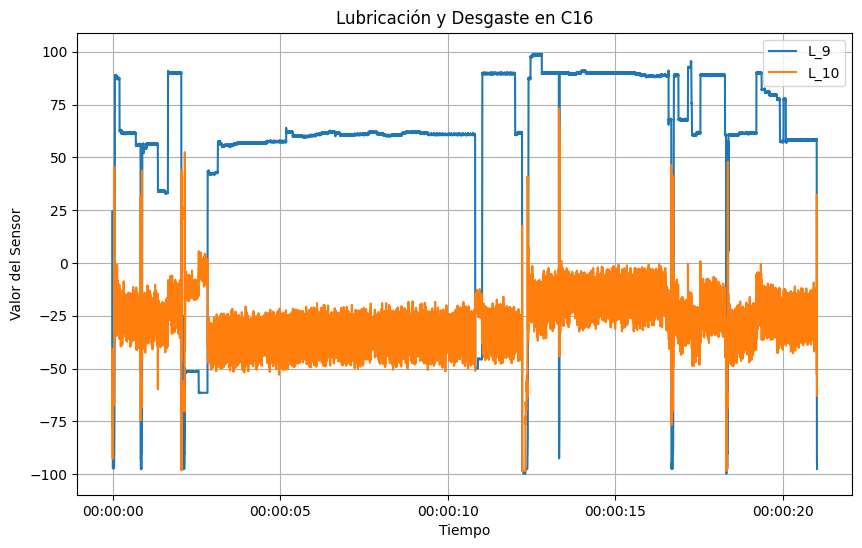

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_component_two_sensors(df, experiment, component_name, sensor_list, time_col="Timestamp"):
    """
    Filtra y ordena los datos para un experimento concreto,
    y crea un gráfico de líneas con ambos sensores (asumiendo que sensor_list contiene 2 elementos) en el mismo gráfico.
    """
    # Filtrar datos para el experimento
    df_exp = df[df["experiment_ID"] == experiment].copy()
    df_exp.sort_values(by=time_col, inplace=True)

    if df_exp.empty:
        print(f"No se encontraron datos para el experimento {experiment} y componente {component_name}.")
        return

    plt.figure(figsize=(10, 6))

    # Iterar sobre la lista de sensores y plotear cada uno
    for sensor in sensor_list:
        if sensor in df_exp.columns:
            plt.plot(df_exp[time_col], df_exp[sensor], label=sensor)
        else:
            print(f"El sensor {sensor} no se encontró en el experimento {experiment}.")

    plt.title(f"{component_name} en {experiment}")
    plt.xlabel("Tiempo")
    plt.ylabel("Valor del Sensor")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_all_two_sensors(df, experiment_list, componentes, time_col="Timestamp"):
    """
    Itera sobre todos los experimentos y para cada componente que tenga exactamente dos sensores,
    llama a plot_component_two_sensors para generar el gráfico.
    """
    for experiment in experiment_list:
        print(f"Procesando experiment: {experiment}")
        for component_name, sensor_list in componentes.items():
            if len(sensor_list) == 2:  # Solo para componentes con 2 sensores
                print(f"  Graficando componente: {component_name}")
                plot_component_two_sensors(df, experiment, component_name, sensor_list, time_col)

# Ejemplo de uso:
# Se asume que 'df_monitoring' tiene una columna 'experiment_ID' y 'Timestamp' ya configurada,
# y que 'experimentos' y 'componentes' ya están definidos globalmente.
plot_all_two_sensors(df_monitoring, experimentos, componentes, time_col="Timestamp")


* **Para componentes con más de dos sensores crear por cada experimento gráficos multivariados (en subplots) para cada sensor**

Procesando experimento: C7
  Graficando componente: Sistema Hidráulico


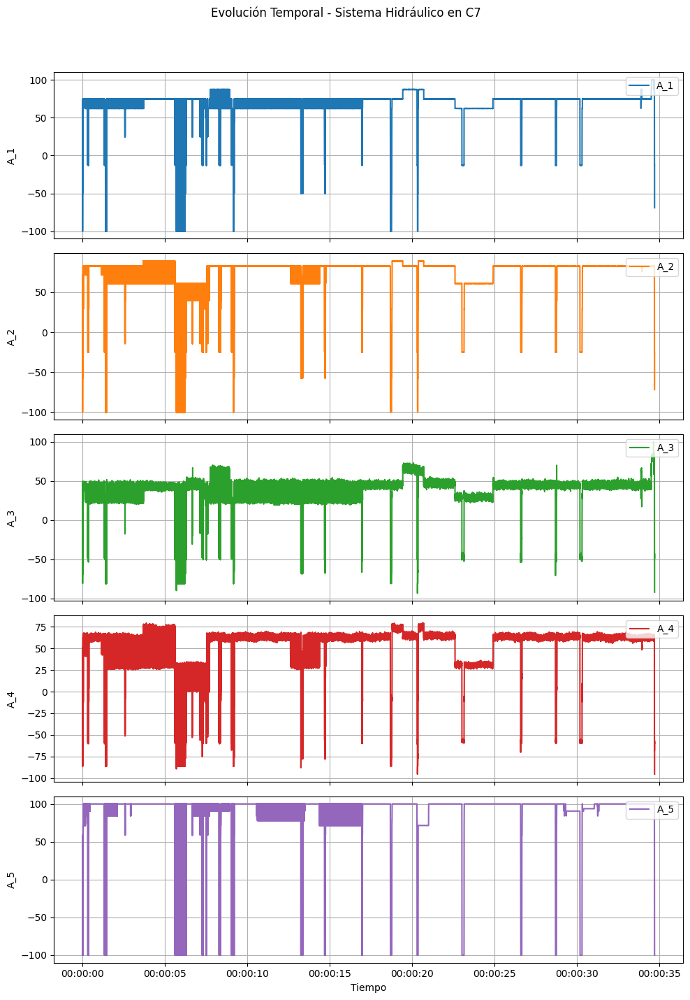

  Graficando componente: Integridad Estructural


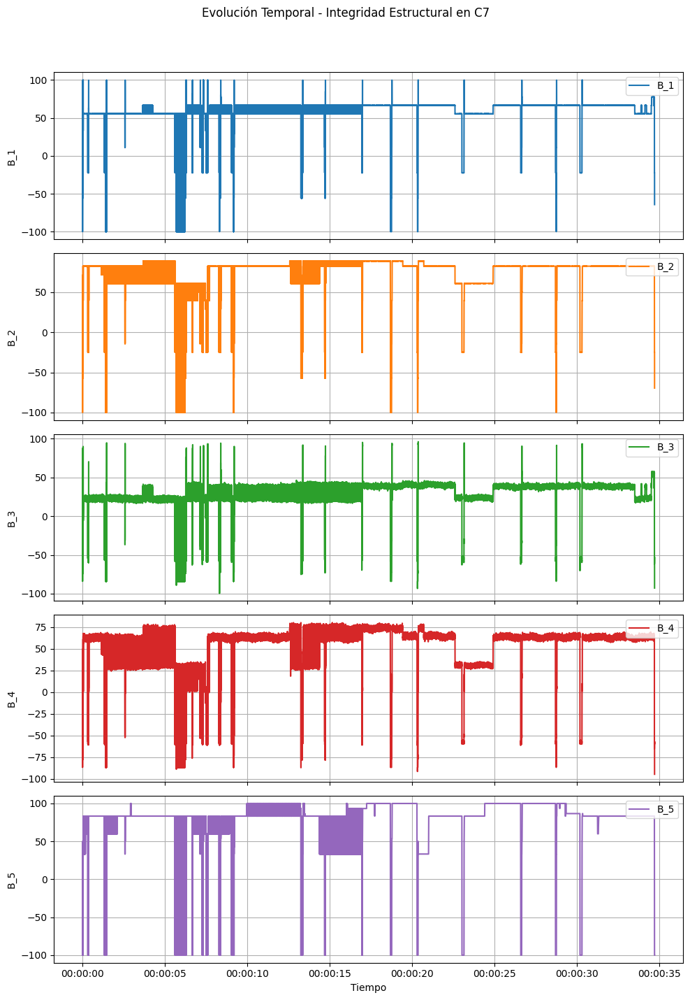

  Graficando componente: Condiciones Ambientales


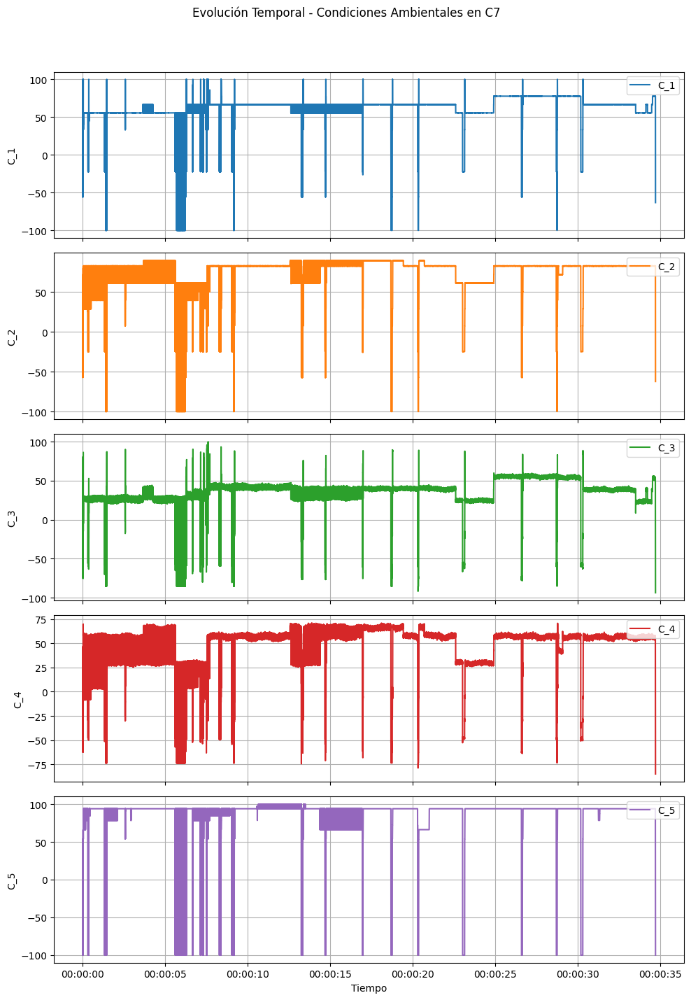

Procesando experimento: C8
  Graficando componente: Sistema Hidráulico


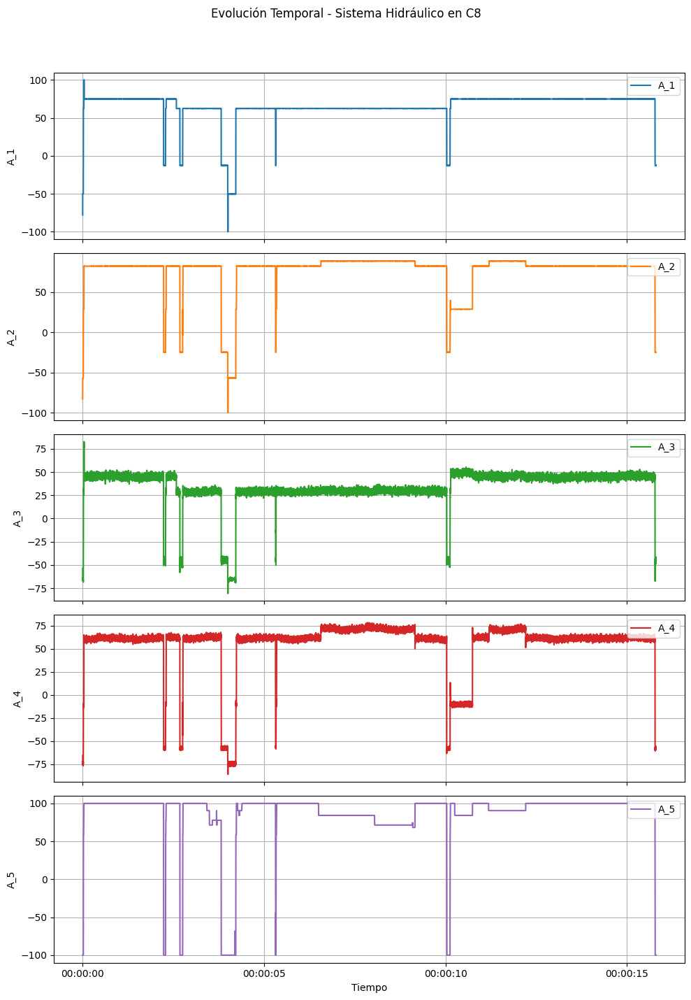

  Graficando componente: Integridad Estructural


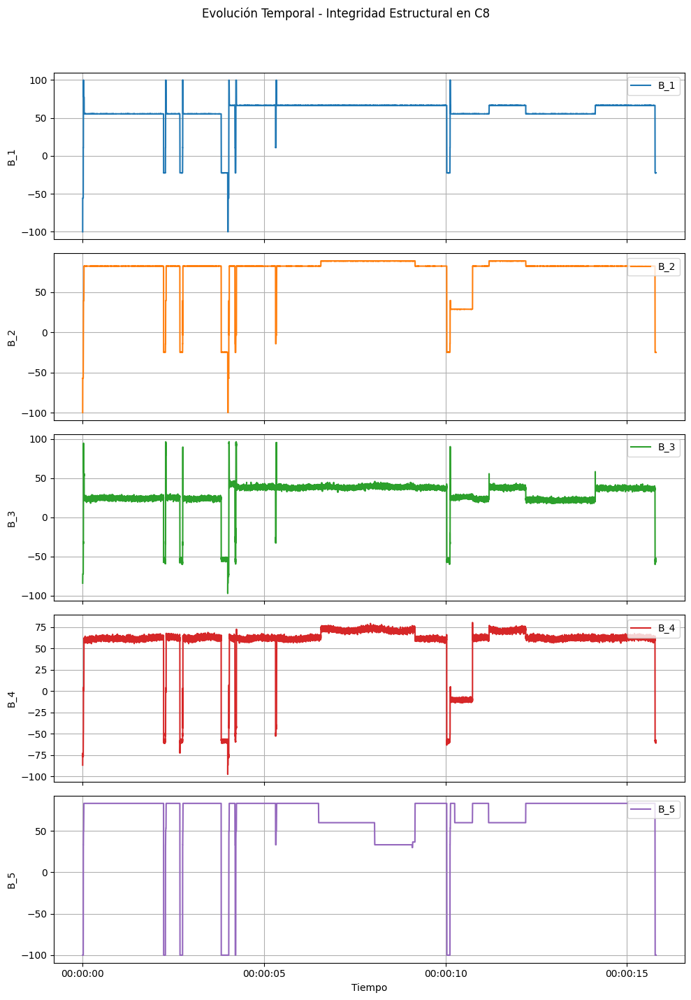

  Graficando componente: Condiciones Ambientales


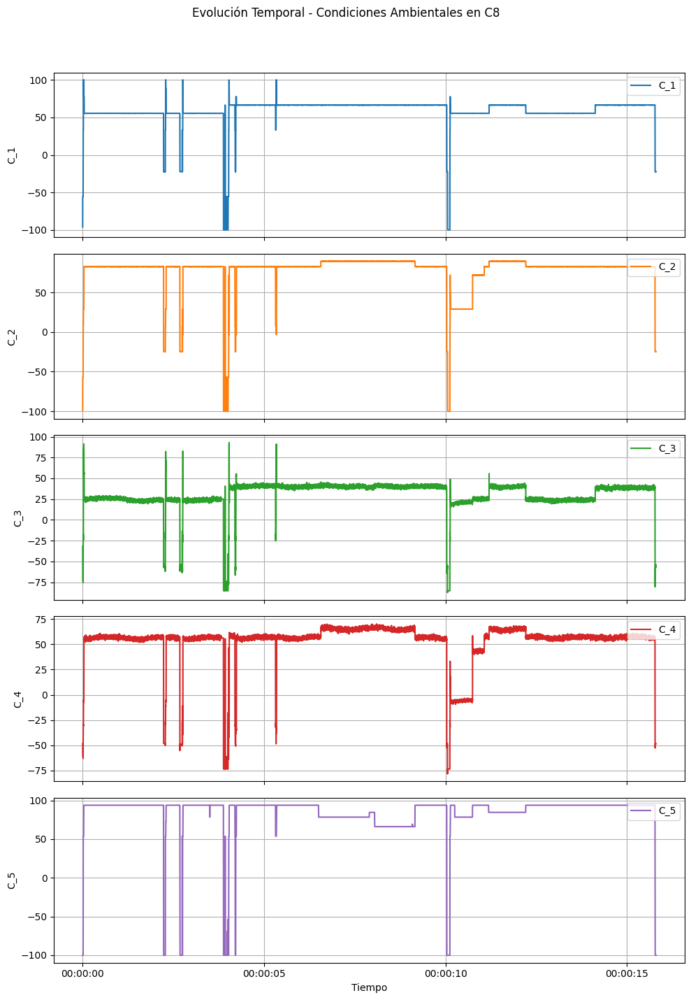

Procesando experimento: C9
  Graficando componente: Sistema Hidráulico


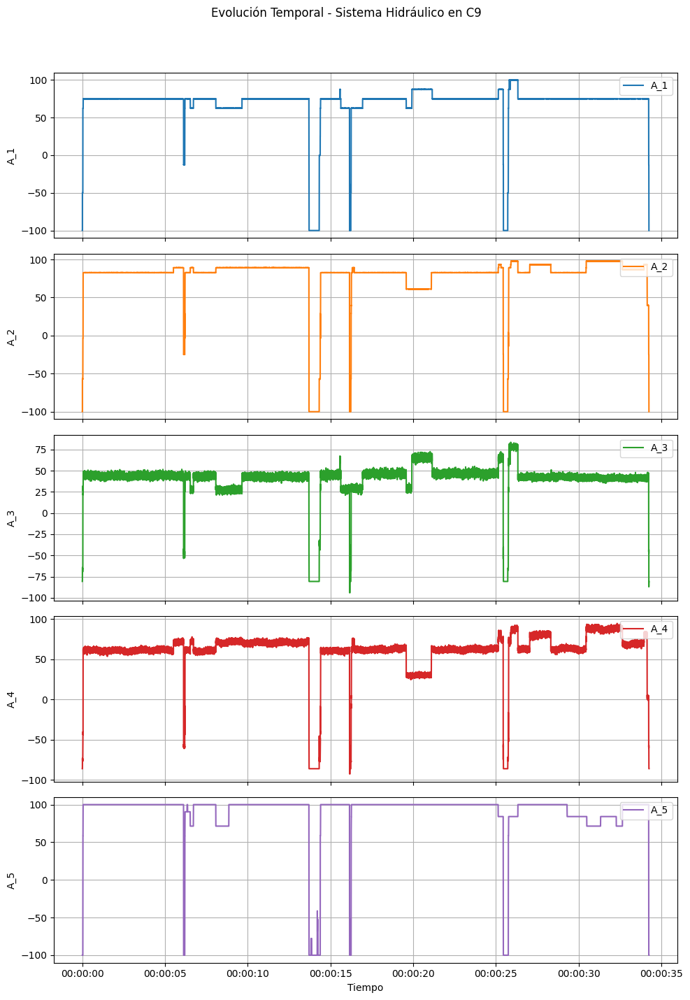

  Graficando componente: Integridad Estructural


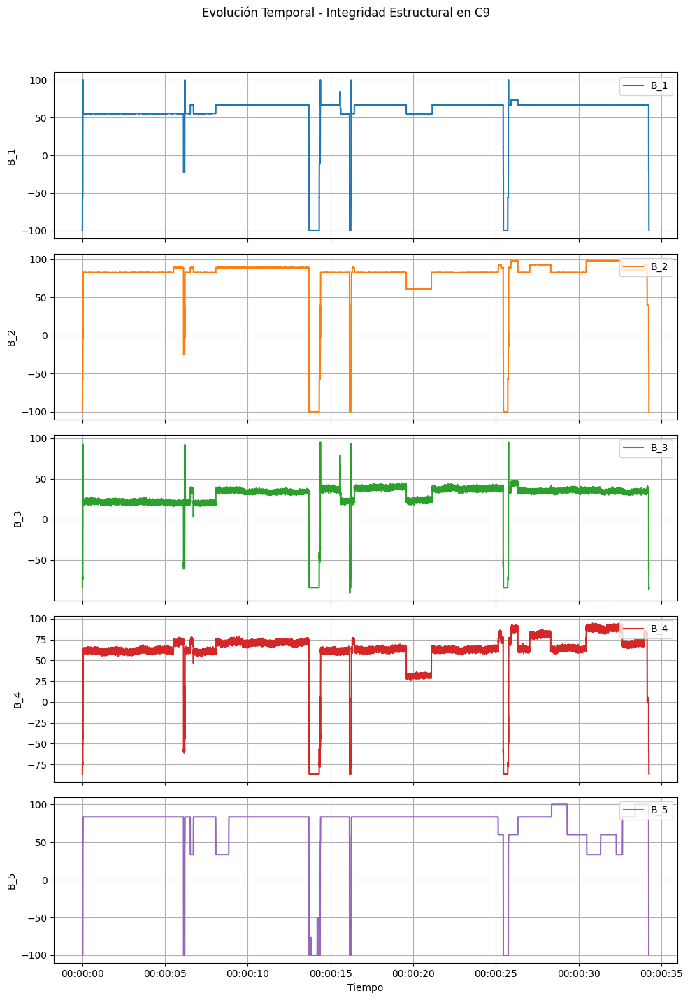

  Graficando componente: Condiciones Ambientales


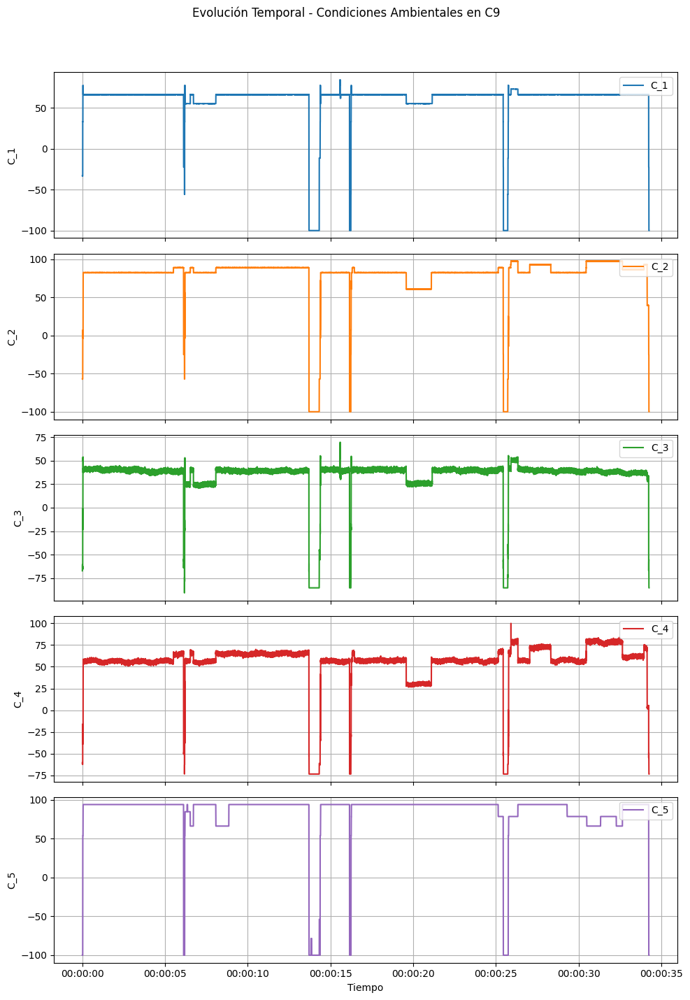

Procesando experimento: C11
  Graficando componente: Sistema Hidráulico


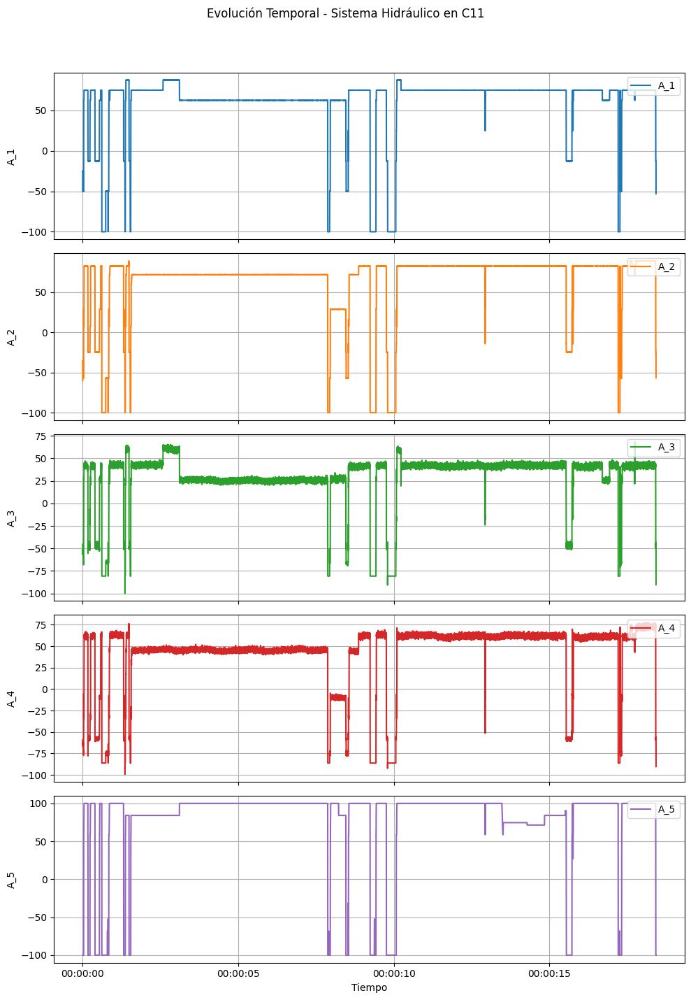

  Graficando componente: Integridad Estructural


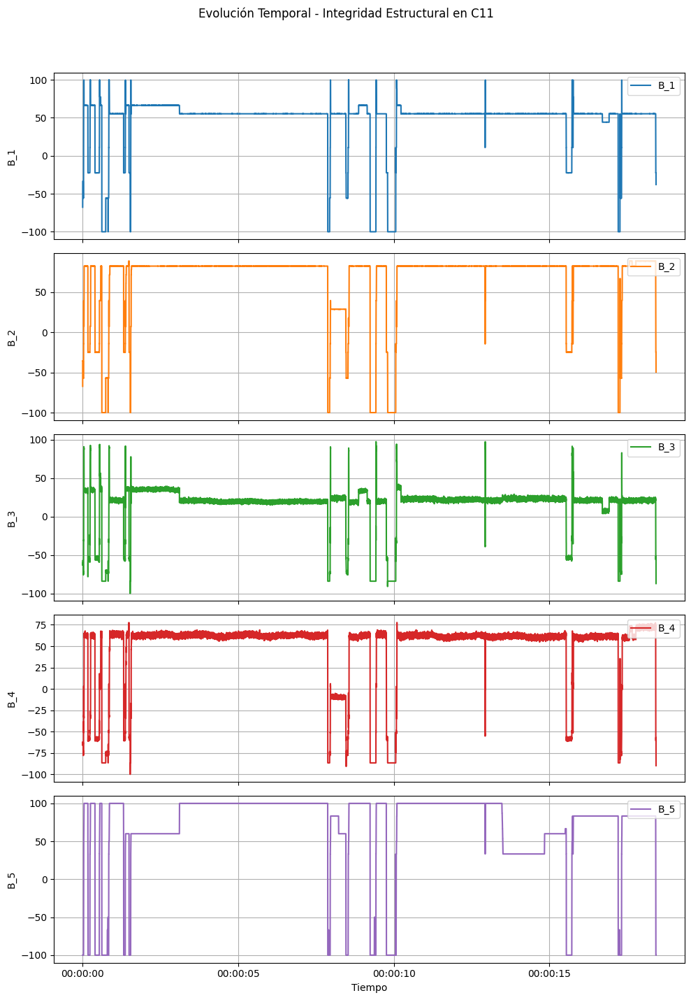

  Graficando componente: Condiciones Ambientales


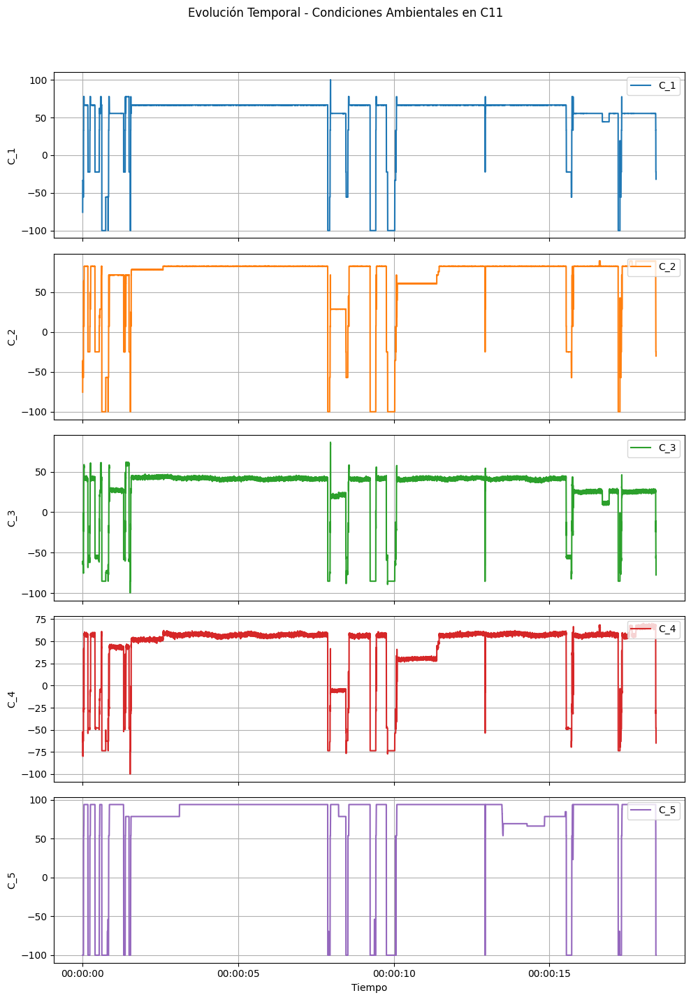

Procesando experimento: C13
  Graficando componente: Sistema Hidráulico


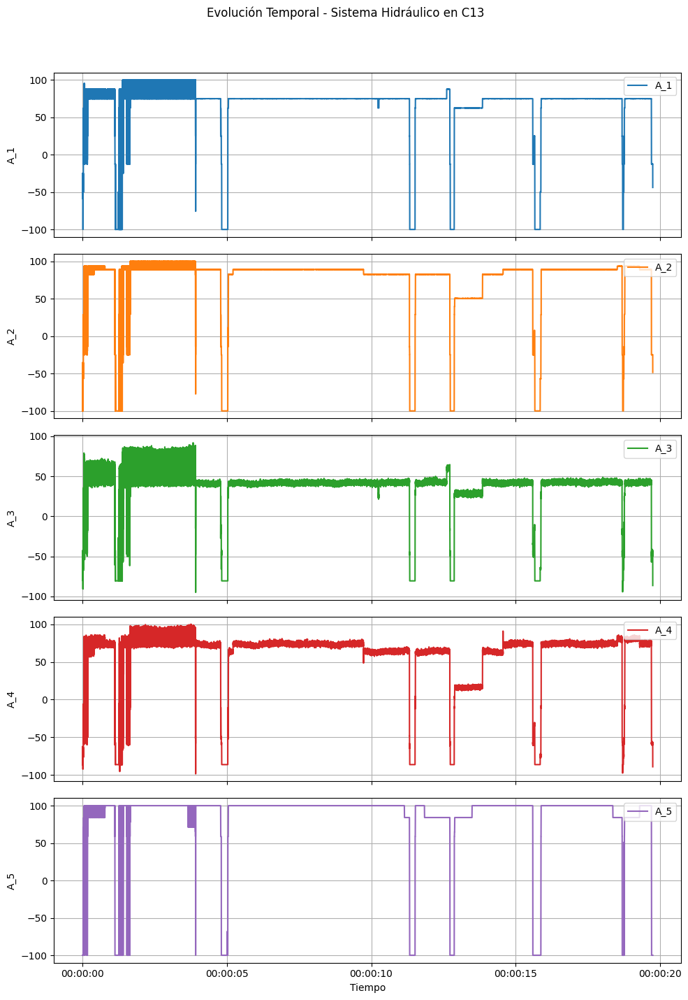

  Graficando componente: Integridad Estructural


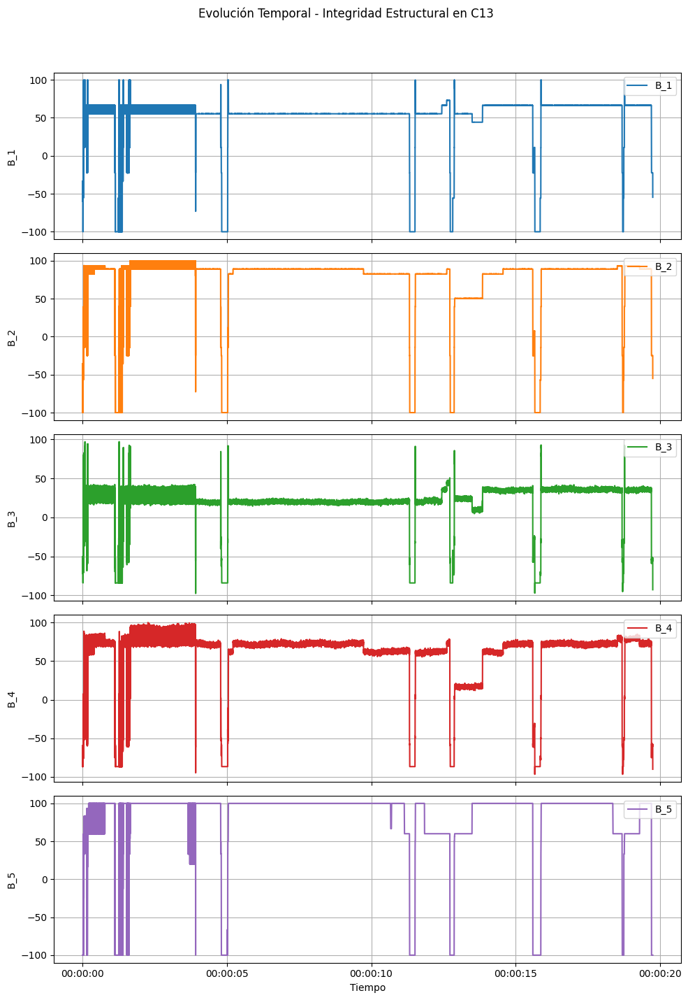

  Graficando componente: Condiciones Ambientales


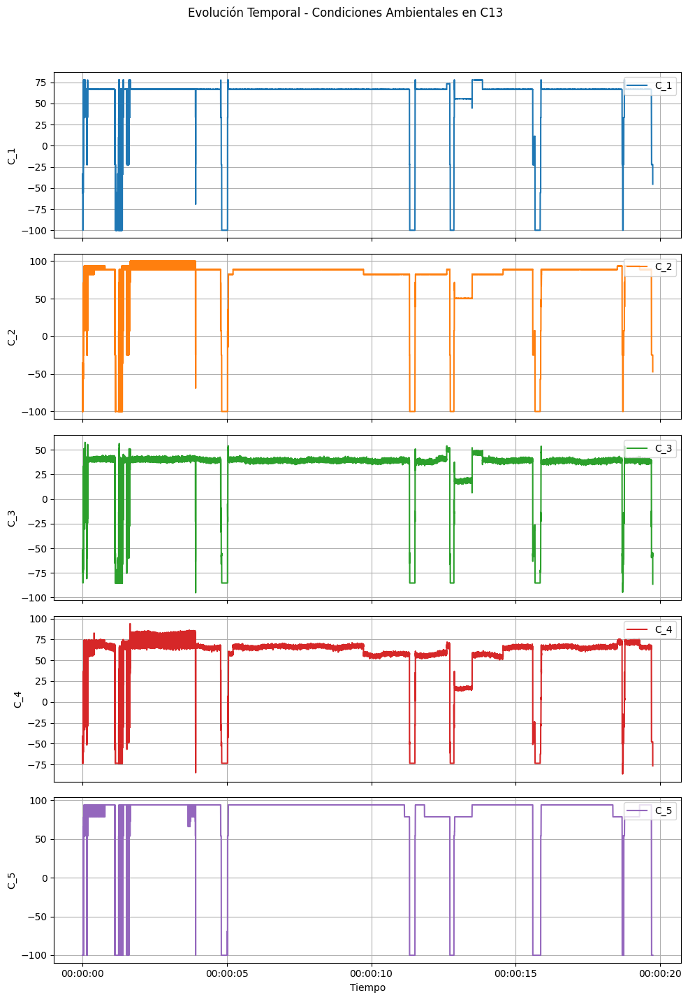

Procesando experimento: C14
  Graficando componente: Sistema Hidráulico


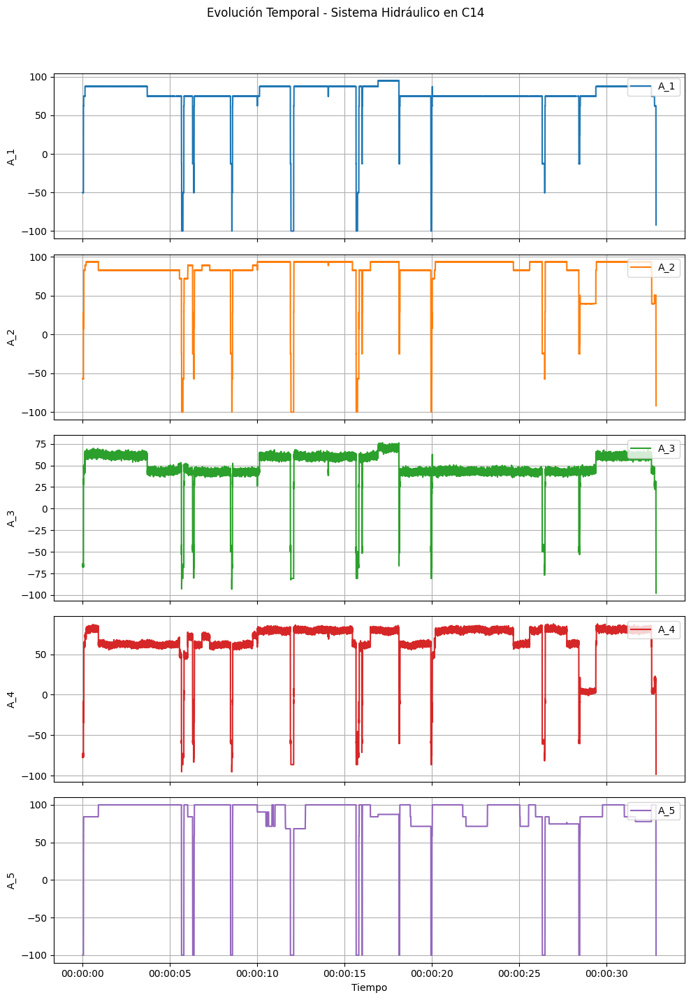

  Graficando componente: Integridad Estructural


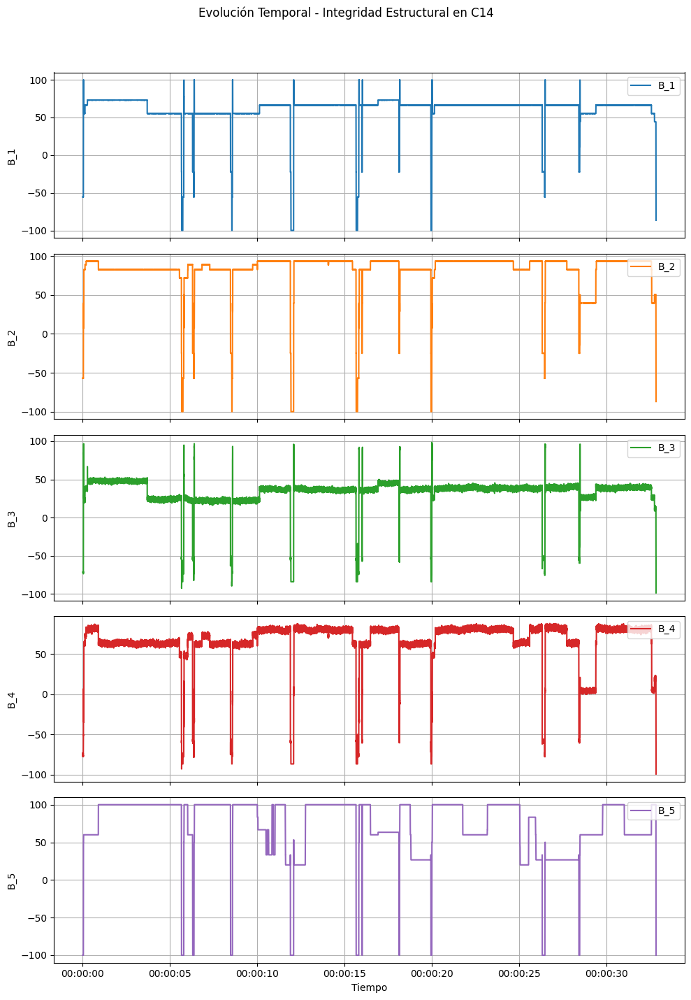

  Graficando componente: Condiciones Ambientales


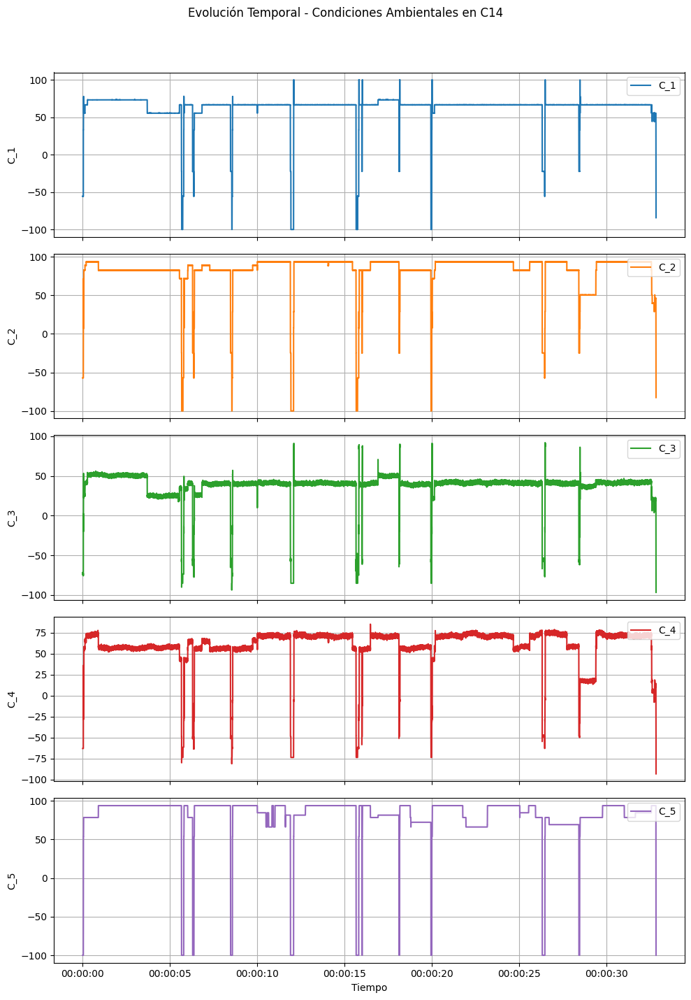

Procesando experimento: C15
  Graficando componente: Sistema Hidráulico


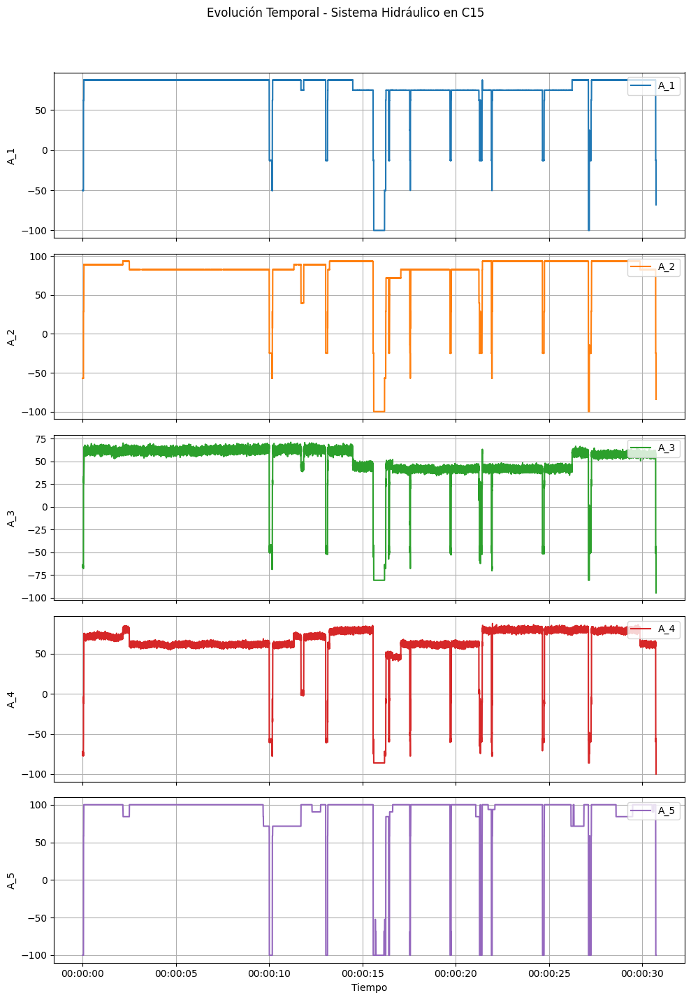

  Graficando componente: Integridad Estructural


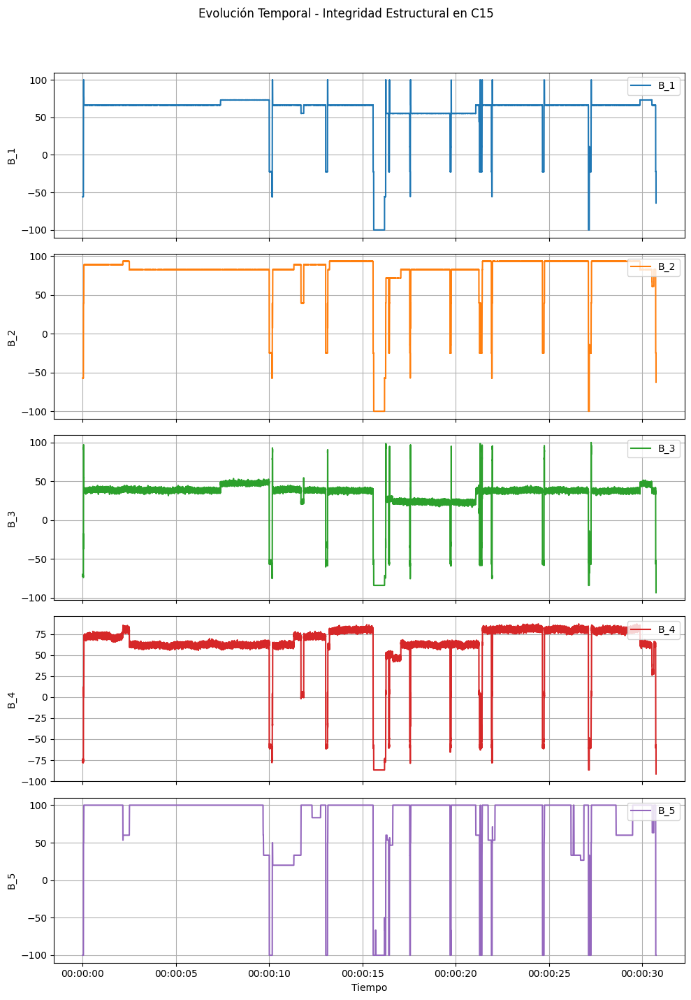

  Graficando componente: Condiciones Ambientales


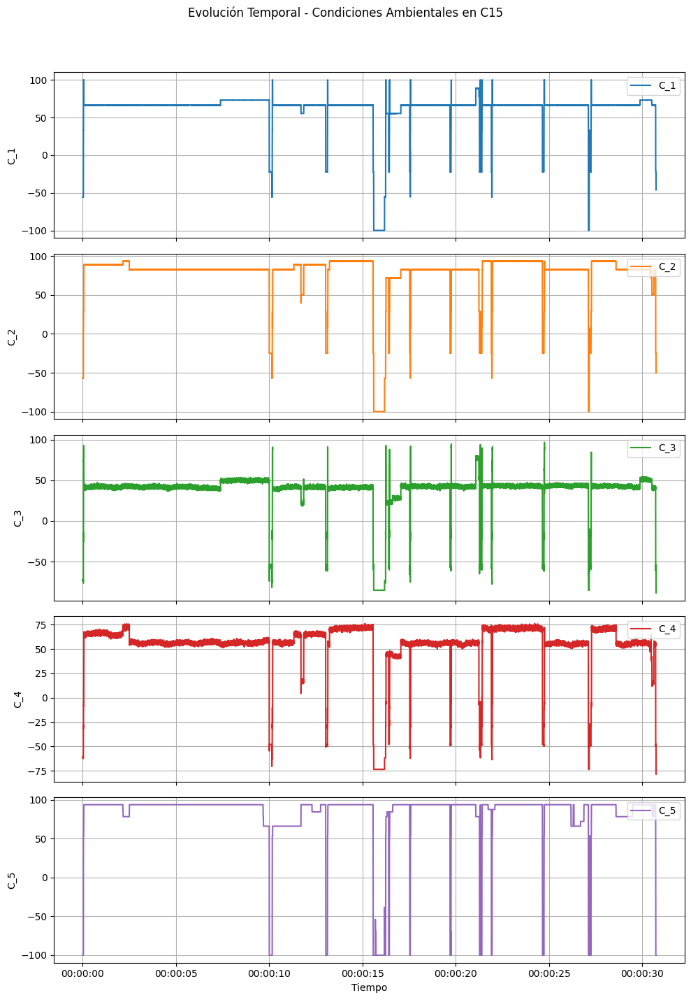

Procesando experimento: C16
  Graficando componente: Sistema Hidráulico


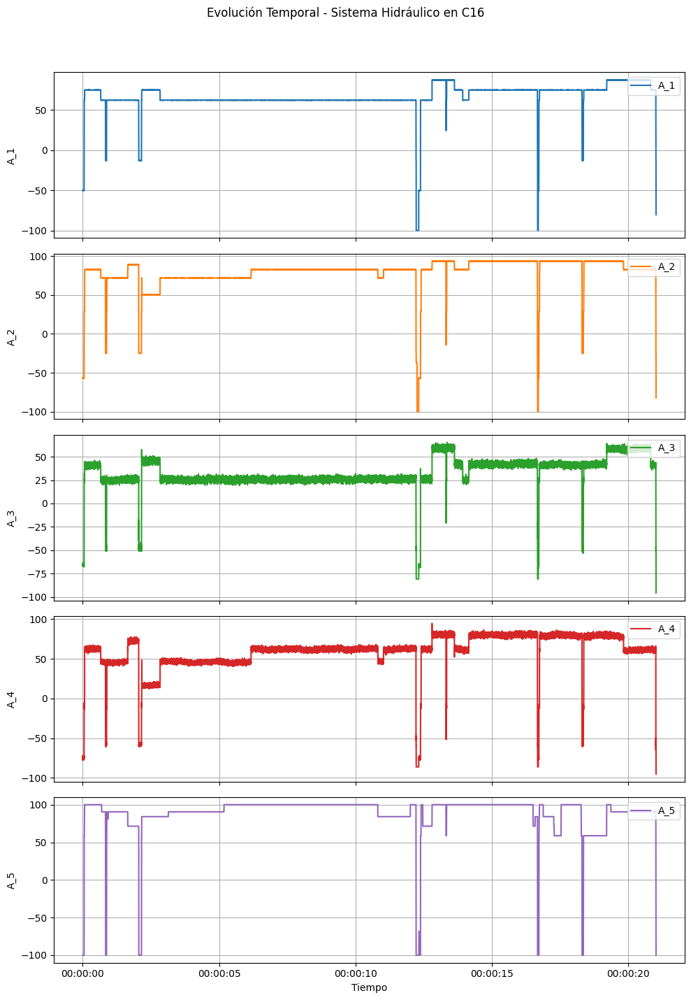

  Graficando componente: Integridad Estructural


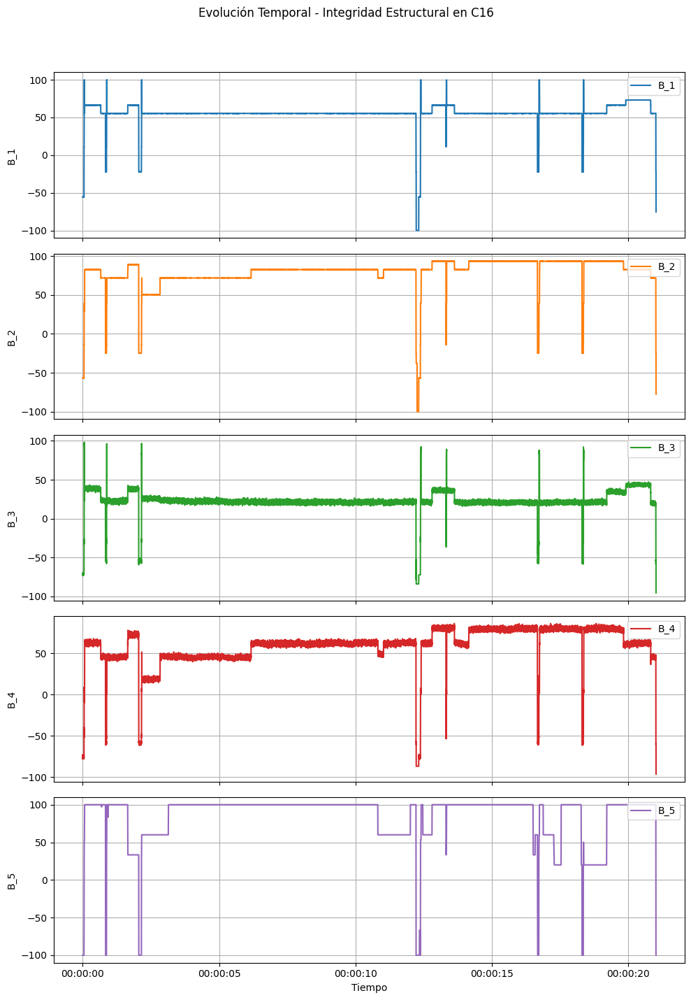

  Graficando componente: Condiciones Ambientales


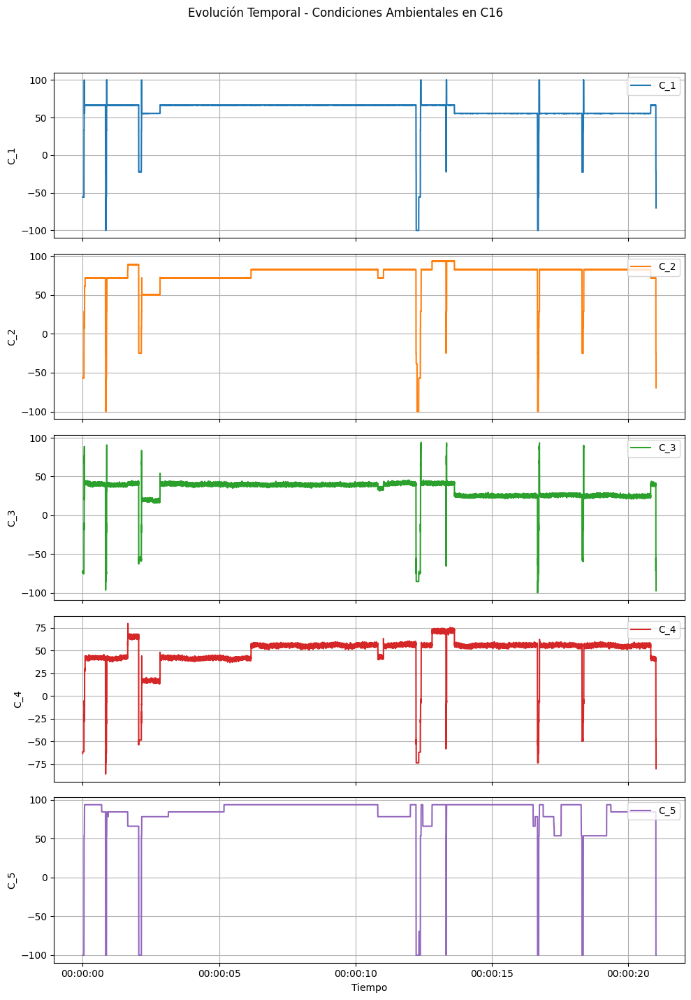

In [ ]:
import matplotlib.pyplot as plt

def plot_component_five_sensors(df, experiment, component_name, sensor_list, time_col="Timestamp"):
    """
    Filtra y ordena los datos para un experimento concreto y crea subplots para cada uno de los 5 sensores del componente.

    Parámetros:
      df            : DataFrame completo (df_monitoring)
      experiment    : Identificador del experimento (por ejemplo, "C7")
      component_name: Nombre del componente (por ejemplo, "Sistema Hidráulico")
      sensor_list   : Lista de sensores asociada al componente (debe tener 5 elementos)
      time_col      : Nombre de la columna de tiempo (por defecto "Timestamp")
    """
    # Filtrar datos para el experimento y ordenarlos por tiempo
    df_exp = df[df["experiment_ID"] == experiment].copy()
    df_exp.sort_values(by=time_col, inplace=True)

    if df_exp.empty:
        print(f"Sin datos para el experimento {experiment} en el componente {component_name}.")
        return

    # Número de sensores (esperado que sea 5)
    n_sensors = len(sensor_list)

    # Crear manera vertical (subplots) para cada sensor
    fig, axes = plt.subplots(nrows=n_sensors, ncols=1, figsize=(10, 3 * n_sensors), sharex=True)

    for i, sensor in enumerate(sensor_list):
        if sensor in df_exp.columns:
            axes[i].plot(df_exp[time_col], df_exp[sensor], label=sensor, color=f"C{i}")
            axes[i].set_ylabel(sensor)
            axes[i].grid(True)
            axes[i].legend(loc="upper right")
        else:
            print(f"Sensor {sensor} no encontrado en el experimento {experiment}.")

    plt.xlabel("Tiempo")
    plt.suptitle(f"Evolución Temporal - {component_name} en {experiment}")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_all_five_sensors(df, experiment_list, componentes, time_col="Timestamp"):
    """
    Itera sobre cada experimento y, para cada componente que tenga exactamente 5 sensores,
    genera los gráficos llamando a plot_component_five_sensors.

    Parámetros:
      df             : DataFrame completo (df_monitoring)
      experiment_list: Lista (o pd.Series) de experimentos (por ejemplo, ["C7", "C8", ...])
      componentes    : Diccionario de componentes, donde cada valor es una lista de sensores.
      time_col       : Nombre de la columna de tiempo.
    """
    for experiment in experiment_list:
        print(f"Procesando experimento: {experiment}")
        for component_name, sensor_list in componentes.items():
            if len(sensor_list) == 5:  # Solo para componentes con 5 sensores
                print(f"  Graficando componente: {component_name}")
                plot_component_five_sensors(df, experiment, component_name, sensor_list, time_col)

# Ejemplo de uso:
# Se asume que 'df_monitoring' tiene una columna 'experiment_ID' y 'Timestamp',
# 'experimentos' es una pd.Series(['C7', 'C8', 'C9', 'C11', 'C13', 'C14', 'C15', 'C16'])
# y 'componentes' es el diccionario definido previamente.
plot_all_five_sensors(df_monitoring, experimentos, componentes, time_col="Timestamp")


**Conclusiones de la Fase 2**

---

**Interpretación Visual y Limitaciones**

Las representaciones visuales (scatter plots y análisis de outliers) permiten observar tendencias generales y detectar anomalías. No obstante, su interpretación es limitada por:
- **Variabilidad y sobreposición:** La densidad de datos oculta correlaciones sutiles.
- **Subjetividad:** La detección de patrones depende de la percepción del analista.
- **Escalabilidad:** Con numerosos sensores, es difícil identificar qué variables son críticas.

**Estrategia Objetiva Adoptada**

Para superar estas limitaciones se opta por entrenar un RandomForestRegressor utilizando el feature "*elapsed_seconds*" (calculado de forma independiente por experimento). Y posteriormente evaluar la importancia de cada sensor empleando:
- **Permutation Importance:** Mide el deterioro del rendimiento al mezclar los valores de cada variable.
- **SHAP:** Proporciona explicaciones tanto globales como locales sobre la contribución de cada sensor.

Esta aproximación cuantitativa elimina la subjetividad del análisis visual y fundamenta de forma reproducible la selección de características clave para futuros modelos predictivos.

# **Fase 3: Visualización Avanzada y Preparación de la Data para Modelado**


**Modelo base de regresión** "***RandomForestRegressor***" **con division estratificada del dataset**

---
* Lo que se pretende ahora es realizar el ***análisis de importancia***.

* Para lo cual, el objetivo de este modelo es entender el impacto de cada sensor sobre la predicción de `elapsed_seconds`, sin más pretensiones.

* **Se utiliza para el parámetro `stratify=estratify_col` experiment_ID  como criterio de estratificación** para que cada experimento tenga representación, y evitar sesgos debido a una distribución desbalanceada porque uno de ellos se sobre-represente (por ejemplo, aquellos con mayor cantidad de observaciones).



In [ ]:
# Definir las columnas a excluir (datos temporales y de identificación)
exclude_cols = ['Timestamp', 'experiment_ID', 'elapsed_seconds', 'year', 'month', 'day', 'hour', 'minute', 'second', 'day_of_week']

# Preservar la columna de estratificación (aquí, 'experiment_ID')
stratify_col = df_monitoring['experiment_ID']

# Seleccionar las columnas de características (features) descartando las de 'exclude_cols'
feature_cols = [col for col in df_monitoring.columns if col not in exclude_cols]
X = df_monitoring[feature_cols]
y = df_monitoring['elapsed_seconds']

# Dividir el dataset en entrenamiento (80%) y prueba (20%) de forma estratificada
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=stratify_col  # Esto garantiza la misma distribución de experimentos en ambos conjuntos
)

# Verificar la distribución de 'experiment_ID' en los conjuntos resultantes
print("Distribución de experiment_ID en el conjunto de entrenamiento:")
print(df_monitoring.loc[X_train.index, 'experiment_ID'].value_counts())

print("\nDistribución de experiment_ID en el conjunto de prueba:")
print(df_monitoring.loc[X_test.index, 'experiment_ID'].value_counts())

# Crear y entrenar el modelo RandomForestRegressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Hacer predicciones y evaluar el modelo
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("\nError cuadrático medio (MSE):", mse)


Distribución de experiment_ID en el conjunto de entrenamiento:
experiment_ID
C7     41334
C9     27396
C14    26275
C15    24586
C13    18936
C16    16817
C11    14743
C8     12642
Name: count, dtype: int64

Distribución de experiment_ID en el conjunto de prueba:
experiment_ID
C7     10333
C9      6849
C14     6569
C15     6147
C13     4734
C16     4204
C11     3686
C8      3161
Name: count, dtype: int64

Error cuadrático medio (MSE): 0.3810362321788139


> Se obtiene un error cuadrático medio (MSE) de 0.38967 muy bajo, lo que sugiere que, en promedio, las predicciones del modelo se desvían en menos de 0.39 unidades respecto a los valores reales de elapsed_seconds. Esto indica que el RandomForestRegressor está capturando eficazmente las relaciones entre las señales de los sensores y la evolución temporal relativa en cada experimento.



**Análisis de importancia. "Permutation Importance" y "SHAP"**

---

* *Permutation Importance*

  Para evaluar la importancia de cada característica en este modelo, se usa Permutation Importance, que mide cuánto cambia el error del modelo cuando se altera aleatoriamente *-10 veces-* una a una todas las características sin alterar el resto.

  Se hacen predicciones con el dataset modificado, obteniendo un nuevo error.

  La diferencia entre el error original y el error tras permutación indica cuán importante es la característica para el modelo.

  > La gráfica de Permutation Importance muestra que al permutar variables como **L_2_modified, L_1_modified, L_6_modified, L_3_modified** y **L_5_modified** se produce un incremento notable en el error del modelo. Esto evidencia que dichas variables son clave para la toma de decisiones predictivas.

<ipython-input-44-241e28d738dc>:10: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(result.importances[sorted_idx].T,


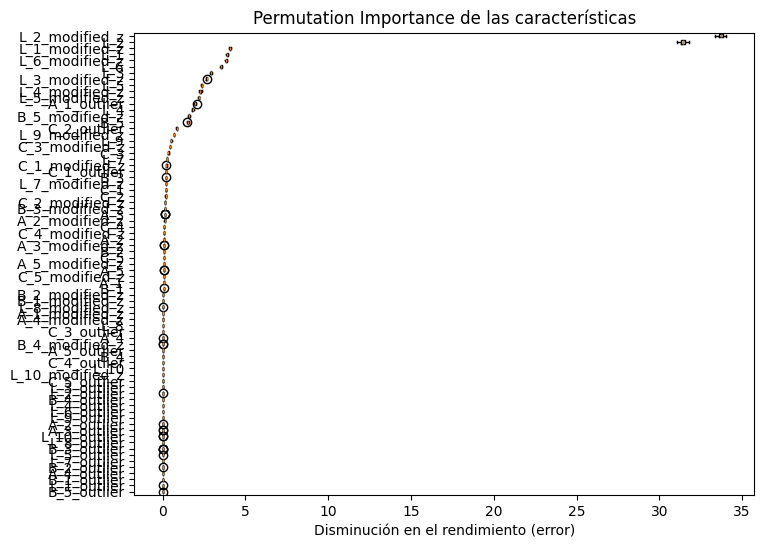

In [ ]:
# Calculamos la Permutation Importance en el conjunto de prueba
result = permutation_importance(rf_model, X_test, y_test,
                                n_repeats=10, random_state=42, scoring='neg_mean_squared_error')

# Ordenamos las características según la importancia media
sorted_idx = result.importances_mean.argsort()

# Graficamos la distribución de la importancia de cada sensor
plt.figure(figsize=(8, 6))
plt.boxplot(result.importances[sorted_idx].T,
            vert=False, labels=X_test.columns[sorted_idx])
plt.title("Permutation Importance de las características")
plt.xlabel("Disminución en el rendimiento (error)")
plt.show()


* *SHAP*

  >***Destacamos el empleo de la función*** **`sample_experiment_phases`** ***con el propósito de obtener una muestra representativa estratificada por experimento y fases temporales para aplicar SHAP.*** De forma que se asegura que la interpretación del modelo (mediante SHAP) respete la diversidad temporal de cada experimento y que las explicaciones sean coherentes en función de cómo evolucionan los datos durante el ciclo run‑to‑failure.

  >Para lo que se dividen los datos de cada experimento en fases temporales (por ejemplo, tres fases) basándose en la columna 'Timestamp'. Se asignan pesos a cada fase (en este caso, [0.2, 0.3, 0.5]) ***para asegurar que se muestreen de forma proporcional y se capture la evolución del experimento a lo largo del tiempo***.

  >Aplicar la función definida a cada grupo de experimentos para ***obtener una muestra representativa de cada uno, respetando la distribución temporal***. En nuestro caso 125 muestras limitados por los recursos computacionales. Esto garantiza que la interpretación (con SHAP) se base en datos ***que reflejan correctamente las distintas fases del experimento***.

<ipython-input-47-d829a0cf058b>:39: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for exp_id, df_exp in X_test_with_meta.groupby("experiment_ID"):


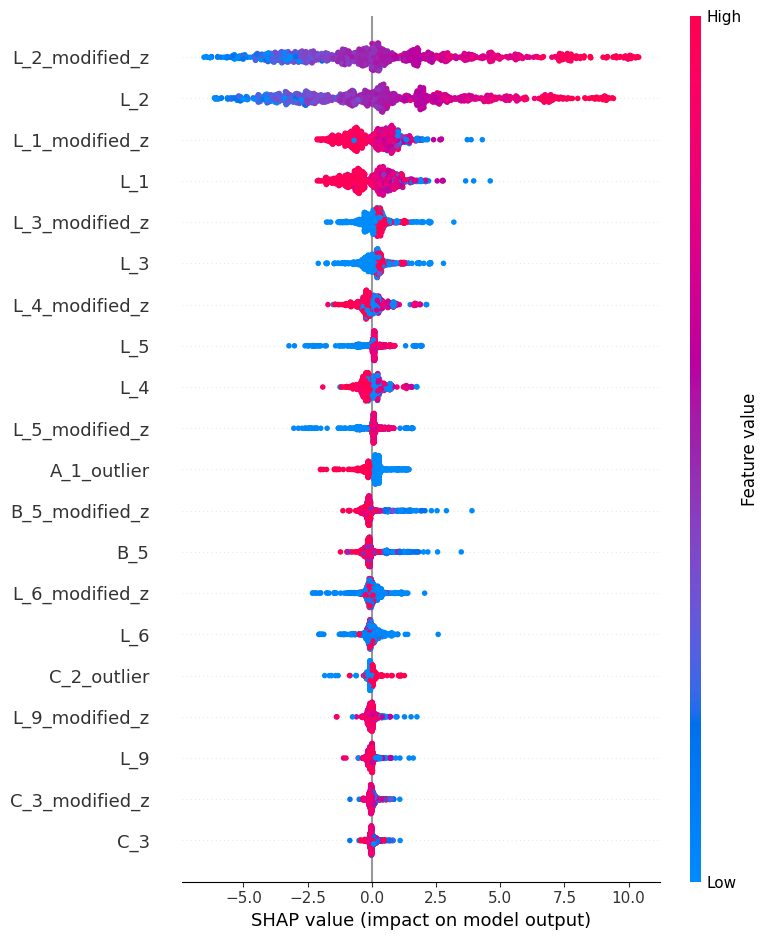

In [ ]:
# - df_monitoring: DataFrame original con todas las columnas, incluyendo 'experiment_ID' y 'Timestamp'
# - X_test: el conjunto de features utilizado para entrenar el modelo (sin 'experiment_ID', etc.)
# - rf_model: el modelo RandomForestRegressor entrenado

# Paso 1: Crear una copia de X_test que conserve las columnas meta para el muestreo.
X_test_with_meta = df_monitoring.loc[X_test.index].copy()

# Paso 2: Función para muestreo estratificado de cada experimento según fases temporales.
def sample_experiment_phases(df, total_samples, time_col="Timestamp", phases=3, weights=[0.2, 0.3, 0.5], random_state=42):
    # Ordenar el DataFrame por la columna temporal
    df_sorted = df.sort_values(by=time_col).copy()

    # Calcular los cuantiles para dividir el experimento en fases
    quantiles = [i / phases for i in range(phases + 1)]
    boundaries = df_sorted[time_col].quantile(quantiles).values

    # Asignar a cada registro una etiqueta de fase
    df_sorted["phase"] = pd.cut(df_sorted[time_col],
                                bins=boundaries,
                                labels=False,
                                include_lowest=True)

    sampled_df = pd.DataFrame()
    # Muestrear cada fase según los pesos indicados
    for phase in range(phases):
        phase_data = df_sorted[df_sorted["phase"] == phase]
        n_phase = int(round(total_samples * weights[phase]))
        n_phase = min(n_phase, len(phase_data))  # Evitamos pedir más muestras de las disponibles
        sampled_phase = phase_data.sample(n=n_phase, random_state=random_state)
        sampled_df = pd.concat([sampled_df, sampled_phase])

    return sampled_df

# Paso 3: Aplicar el muestreo estratificado a cada experimento.
samples_list = []
samples_por_experimento = 125  # Por ejemplo, 125 muestras por experimento

for exp_id, df_exp in X_test_with_meta.groupby("experiment_ID"):
    sample_exp = sample_experiment_phases(df_exp,
                                          total_samples=samples_por_experimento,
                                          time_col="Timestamp",
                                          phases=3,
                                          weights=[0.2, 0.3, 0.5],
                                          random_state=42)
    samples_list.append(sample_exp)

# Combinar las muestras de todos los experimentos
X_test_sample_strat = pd.concat(samples_list)

# Paso 4: Extraer las mismas columnas/features que utilizaste para entrenar el modelo.
# De este modo se elimina 'experiment_ID', 'Timestamp', etc.
X_test_sample_final = X_test_sample_strat[X_test.columns]

# Paso 5: Ejecutar SHAP con el DataFrame final.
import shap
explainer = shap.TreeExplainer(rf_model)
shap_values = explainer.shap_values(X_test_sample_final)
shap.summary_plot(shap_values, X_test_sample_final)



Resultados obtenidos de la gráfica SHAP:

- **Identificación de Variables Críticas:**  
  La gráfica SHAP revela cuáles son los sensores que tienen mayor impacto en las predicciones del modelo. Se observa que ciertas variables (por ejemplo, aquellas transformadas con “modified_z”) destacan por su contribución elevada, lo que las identifica como factores clave para la predicción del fallo.

- **Contribución Direccional y Magnitud:**  
  Cada punto en la gráfica indica el efecto (positivo o negativo) de la variable sobre la predicción. Los sensores críticos muestran valores SHAP de magnitud elevada, permitiendo inferir si un aumento en el valor del sensor empuja la predicción hacia condiciones más o menos riesgosas.

**Conclusiones de la Fase 3**

---

Resultados obtenidos de relacionar ambas gráficas:

- **Validación de la Relevancia de los Sensores Críticos:**  
  Tanto la **gráfica de Permutation Importance** como la **gráfica SHAP** coinciden en señalar que ciertos sensores (en especial aquellos con transformaciones indicadas por el sufijo _modified_) son determinantes para la predicción del fallo. Lo cual confirma las técnicas utilizadas.

- **Complementariedad entre la Interpretación Global y Local:**  
  - La gráfica de Permutation Importance ofrece una visión global: al permutar cada característica se cuantifica el impacto en el rendimiento del modelo, lo que permite identificar de forma directa cuáles son las variables cuya alteración degrada más la predicción.  
  - La gráfica SHAP, en cambio, muestra a nivel individual cómo cada sensor influye en la predicción, evidenciando además cambios en la dirección y la magnitud de su efecto a lo largo de las diferentes fases (temprana, intermedia y final). Juntas, estas técnicas aseguran que la importancia de los features es consistente tanto en la media como a nivel de instancia.

- **Confirmación del Preprocesamiento Efectivo:**  
  El hecho de observar una alta relevancia de los sensores transformados en ambas herramientas confirma que las técnicas de limpieza y normalización (por ejemplo, la utilización de modified Z-score) han contribuido a resaltar la señal útil para el modelo.

- **Orientación para la Optimización del Pipeline:**  
  La convergencia en ambos métodos respalda la selección final del set de features y orienta los pasos siguientes:
  - Afinar el entrenamiento del modelo optimizando algoritmos e hiperparámetros.
  - Posible reducción de la dimensionalidad descartando variables de bajo impacto.
  - Consolidar estrategias de interpretabilidad que permitan comprender no solo la relevancia global, sino también su variación según la fase del experimento.

# Fase 4: Definición de Objetivos del ML y Selección de Modelos

En esta fase se prepara y transforma el dataset para facilitar el análisis de agrupamiento. Concretamente, se busca:

- **Preprocesamiento:**  
  Se excluyen columnas irrelevantes (datos temporales, identificadores, flags de outliers) y se escalan las variables relevantes mediante *StandardScaler*, garantizando que todas tengan la misma escala.

- **Visualización de Agrupaciones:**  
  Se aplica PCA únicamente con el objetivo de visualizar en dos dimensiones—sin usarse para el modelo—para confirmar la formación de tres grupos bien definidos.

- **Evaluación de Clustering:**  
  Se implementa K-Means (por ejemplo, con \( k=3 \)) en el dataset escalado y en el reducido para determinar el número óptimo de clusters (usando el método del codo) y evaluar la calidad de los grupos mediante métricas como Silhouette, Davies-Bouldin y Calinski-Harabasz.  
  Asimismo, se utiliza validación cruzada (con KFold y GroupKFold) para asegurar que la división respete la trazabilidad de cada experimento.

**ENFOQUE B (MODELO GLOBAL INTEGRADO)**

---
---

**Estandarización**

---



In [ ]:
# Las columnas que no se desean escalar, como 'Timestamp', se excluyen.
excluded_cols = ['Timestamp',
                 'experiment_ID',
                 'L_1_outlier','L_2_outlier','L_3_outlier','L_4_outlier','L_5_outlier','L_6_outlier','L_7_outlier','L_8_outlier','L_9_outlier','L_10_outlier',
                 'A_1_outlier','A_2_outlier','A_3_outlier','A_4_outlier','A_5_outlier',
                 'B_1_outlier','B_2_outlier','B_3_outlier','B_4_outlier','B_5_outlier',
                 'C_1_outlier','C_2_outlier','C_3_outlier','C_4_outlier','C_5_outlier']

features_to_scale = [col for col in df_monitoring.columns
                     if col not in excluded_cols]

# Creamos una instancia del StandardScaler
scaler = StandardScaler()

# Ajustamos y transformamos el conjunto de datos con las variables seleccionadas
scaled_features = scaler.fit_transform(df_monitoring[features_to_scale])

# Convertimos el resultado a DataFrame para mantener la estructura y el etiquetado de las columnas
df_scaled = pd.DataFrame(scaled_features, columns=features_to_scale)

# Unimos el DataFrame escalado con las columnas excluidas
df_final_scaled = pd.concat([df_scaled, df_monitoring[excluded_cols].reset_index(drop=True)], axis=1)

# Mostramos las primeras filas para verificar que todo esté correcto
print(df_final_scaled.head())


        L_1       L_2       A_1       A_2       B_1       B_2       C_1  \
0 -3.630155 -3.862731 -4.001224 -4.027403 -4.154447 -4.093291 -4.236323   
1 -3.630155 -3.862731 -4.004297 -4.027403 -4.152440 -4.091685 -4.230343   
2 -3.555613 -3.519937 -4.005321 -4.030580 -4.151938 -4.096902 -4.231838   
3 -3.385940 -3.045103 -4.004809 -4.027403 -4.154447 -4.092087 -4.233831   
4 -2.874084 -2.660666 -4.006345 -4.030978 -4.151437 -4.094495 -4.236821   

        C_2       A_3       A_4  ...  B_1_outlier  B_2_outlier  B_3_outlier  \
0 -4.100051 -4.101385 -4.018842  ...         True         True         True   
1 -4.101668 -4.101385 -4.079044  ...         True         True         True   
2 -4.100456 -4.101385 -3.960568  ...         True         True         True   
3 -4.100051 -4.101385 -3.956715  ...         True         True         True   
4 -4.100051 -4.101385 -4.061706  ...         True         True         True   

   B_4_outlier  B_5_outlier  C_1_outlier  C_2_outlier  C_3_outlier  \
0   

**PCA**

---


* *Número mínimo de componentes necesarios para explicar el 95% de la varianza*

In [ ]:
# Inicializamos PCA para preservar el 95% de la varianza
pca = PCA(n_components=0.95)

# Ajustamos PCA y transformamos los datos escalados
pca_result = pca.fit_transform(df_final_scaled[features_to_scale])

# Obtenemos el número de componentes seleccionados
n_components = pca.n_components_
print("Número de componentes seleccionados:", n_components)


Número de componentes seleccionados: 7


* *DATAFRAME CON REDUCCION DE DIMENSIONALIDAD*

  Aplicamos PCA a **`df_final_scaled`** y obtenemos **`df_pca_final`** para mantener sin modificar **`df_final_scaled`**. No queremos perder información para entrenar el modelo. Pero `df_pca_final` nos representará de manera más clara los cluster que con el original.

In [ ]:
# Creamos un DataFrame con los componentes principales obtenidos.
df_pca = pd.DataFrame(pca_result, columns=[f'pca{i+1}' for i in range(n_components)])

# Unimos las columnas excluidas al DataFrame resultante de PCA (para mantener la trazabilidad)
df_pca_final = pd.concat([df_pca, df_final_scaled[excluded_cols].reset_index(drop=True)], axis=1)

# Mostramos los DataFrames para verificar
print('Datos originales escalados:')
print(df_final_scaled.head())
print('\nDatos después del PCA:')
print(df_pca_final.head())

Datos originales escalados:
        L_1       L_2       A_1       A_2       B_1       B_2       C_1  \
0 -3.630155 -3.862731 -4.001224 -4.027403 -4.154447 -4.093291 -4.236323   
1 -3.630155 -3.862731 -4.004297 -4.027403 -4.152440 -4.091685 -4.230343   
2 -3.555613 -3.519937 -4.005321 -4.030580 -4.151938 -4.096902 -4.231838   
3 -3.385940 -3.045103 -4.004809 -4.027403 -4.154447 -4.092087 -4.233831   
4 -2.874084 -2.660666 -4.006345 -4.030978 -4.151437 -4.094495 -4.236821   

        C_2       A_3       A_4  ...  B_1_outlier  B_2_outlier  B_3_outlier  \
0 -4.100051 -4.101385 -4.018842  ...         True         True         True   
1 -4.101668 -4.101385 -4.079044  ...         True         True         True   
2 -4.100456 -4.101385 -3.960568  ...         True         True         True   
3 -4.100051 -4.101385 -3.956715  ...         True         True         True   
4 -4.100051 -4.101385 -4.061706  ...         True         True         True   

   B_4_outlier  B_5_outlier  C_1_outlier  C_2_

**k-means**

---

* *WCSS - Curva del Codo*

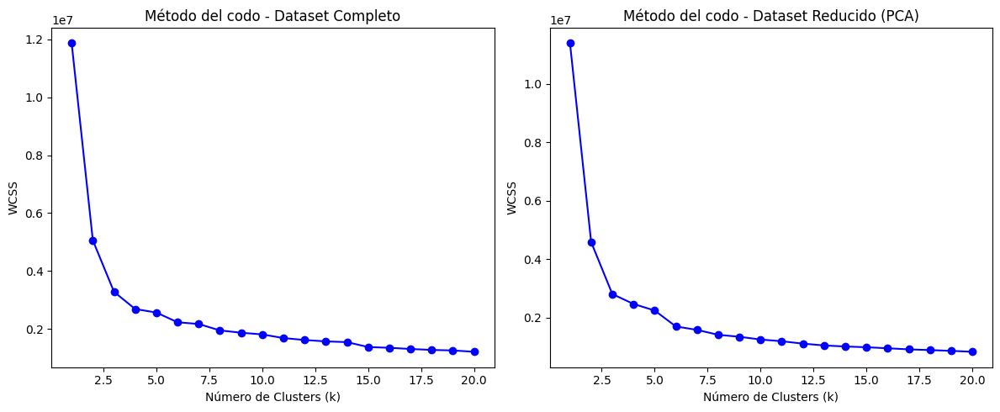

In [ ]:
# Definimos un rango de clusters a probar, por ejemplo, de 1 a 10
K = range(1, 21)

# Listas para almacenar la WCSS para cada valor de k
wcss_complete = []
wcss_reduced = []

# Asumimos que:
# - En el dataset completo usaremos las columnas 'features_to_scale' (las variables escaladas).
# - En el dataset reducido usaremos solo las columnas de los componentes PCA (por ejemplo, las que comienzan con "pca").
pca_columns = [col for col in df_pca_final.columns if col.startswith('pca')]

# Calculamos la WCSS para cada valor de k en ambos datasets.
for k in K:
    # Para el Dataset Completo
    kmeans_complete = KMeans(n_clusters=k, random_state=42)
    kmeans_complete.fit(df_final_scaled[features_to_scale])
    wcss_complete.append(kmeans_complete.inertia_)

    # Para el Dataset Reducido
    kmeans_reduced = KMeans(n_clusters=k, random_state=42)
    kmeans_reduced.fit(df_pca_final[pca_columns])
    wcss_reduced.append(kmeans_reduced.inertia_)

# Graficamos la curva del 'codo' para el Dataset Completo y para el Dataset Reducido
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(K, wcss_complete, 'bo-')
plt.title('Método del codo - Dataset Completo')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('WCSS')

plt.subplot(1, 2, 2)
plt.plot(K, wcss_reduced, 'bo-')
plt.title('Método del codo - Dataset Reducido (PCA)')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('WCSS')

plt.tight_layout()
plt.show()


**Clustering - K-means**

---

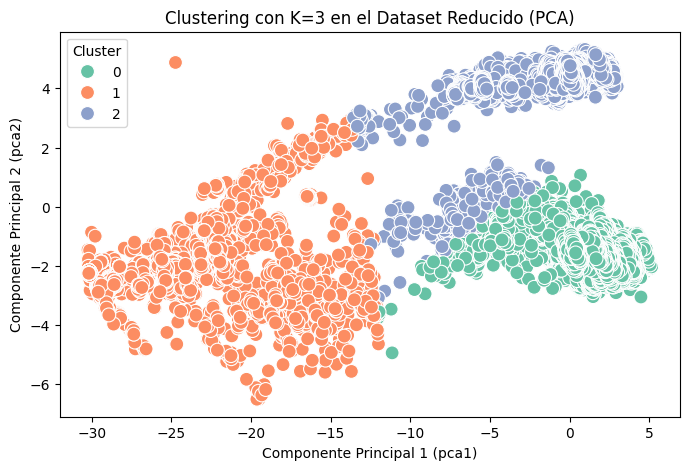

In [ ]:
# Definir número de clusters
k = 3

# 1. Clustering en el Dataset Completo (df_final_scaled):
kmeans_full = KMeans(n_clusters=k, random_state=42)
clusters_full = kmeans_full.fit_predict(df_final_scaled[features_to_scale])
# Guardamos la etiqueta de cluster en el dataset completo
df_final_scaled['Cluster'] = clusters_full

# 2. Clustering en el Dataset Reducido (df_pca_final):
# Suponiendo que las columnas de los componentes principales se nombran como pca1, pca2, ...
pca_columns = [col for col in df_pca_final.columns if col.startswith('pca')]
kmeans_pca = KMeans(n_clusters=k, random_state=42)
clusters_pca = kmeans_pca.fit_predict(df_pca_final[pca_columns])
# Guardamos la etiqueta de cluster en el dataset reducido
df_pca_final['Cluster'] = clusters_pca

# 3. Visualización para el Dataset Reducido utilizando los dos primeros componentes (pca1 y pca2)
plt.figure(figsize=(8, 5))
sns.scatterplot(data=df_pca_final, x='pca1', y='pca2', hue='Cluster', palette='Set2', s=100)
plt.title('Clustering con K=3 en el Dataset Reducido (PCA)')
plt.xlabel('Componente Principal 1 (pca1)')
plt.ylabel('Componente Principal 2 (pca2)')
plt.show()


La gráfica se ve bastante clara y, a primera vista, parece respaldar la elección de k=3 para el dataset reducido. En el espacio definido por los componentes pca1 y pca2, se aprecian tres agrupaciones que parecen estar bien diferenciadas, lo que indica que, tras la reducción con PCA, la estructura subyacente de los datos se conserva de forma que los clusters resultantes tienen sentido visualmente.

Esta representación facilita la interpretación y validación de la segmentación, ya que permite observar de forma directa cómo se distribuyen las observaciones y si existe una separación marcada entre los clusters. Dicho esto, es recomendable, además, evaluar métricas complementarias (por ejemplo, el coeficiente de silueta) para confirmar la consistencia interna de los clusters.

En resumen, la gráfica para el dataset reducido, basada en pca1 y pca2 tras aplicar K-means con k=3, es muy informativa y sugiere que la elección de 3 clusters es adecuada para capturar la estructura de los datos en el espacio reducido.

>**Conclusiones:**
>
> El modelo de clustering (K-means) está agrupando correctamente las observaciones en el espacio original. La reducción dimensional mediante PCA, que conserva el 95% de la varianza, permite visualizar en dos componentes (pca1 y pca2) que efectivamente se generan tres grupos bien definidos. Esto indica que, aunque la visualización 2D del dataset completo no muestre las separaciones de forma evidente, el agrupamiento subyacente es consistente y se aprecia de manera clara en el espacio reducido.

**Evaluar y validar el modelo**

---


Evalucacion y validación del modelo

Se utilizarán las métricas:
* Silhouette Score
* Davies-Bouldin Index
* Calinski-Harabasz Index

Permitirá comparar cómo varían estas métricas en función de
𝑘
 y validar si la elección de
𝑘
=
3
 (o algún otro valor) es coherente en ambos datasets.

Métricas para Dataset Completo:
    k  silhouette  davies_bouldin  calinski_harabasz
0   2    0.776955        0.400514      307717.500658
1   3    0.450882        0.825161      299262.784629
2   4    0.458049        0.782623      260481.484532
3   5    0.386106        1.038506      207292.186919
4   6    0.257042        1.297838      197797.106965
5   7    0.252860        1.297549      170391.566707
6   8    0.223140        1.414096      166406.443228
7   9    0.223278        1.447386      152999.876390
8  10    0.219172        1.432151      141302.459204

Métricas para Dataset Reducido:
    k  silhouette  davies_bouldin  calinski_harabasz
0   2    0.787956        0.369623      339807.280408
1   3    0.484814        0.753901      350262.269083
2   4    0.319059        1.089623      276212.079383
3   5    0.304848        1.155267      233661.229714
4   6    0.331643        1.083715      261930.586915
5   7    0.278119        1.183440      237367.386630
6   8    0.271910        1.158881 

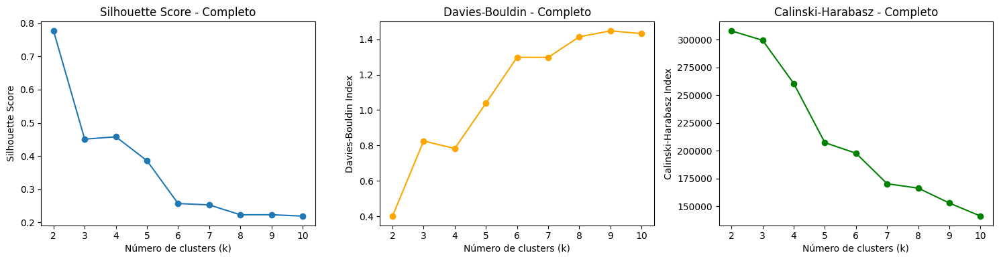

In [ ]:
# Definir un rango de k para evaluar (por ejemplo, de 2 a 10, ya que k=1 no tiene sentido para estas métricas)
range_n_clusters = range(2, 11)

# Inicializamos contenedores para guardar las métricas en cada dataset
metrics_complete = {'k': [], 'silhouette': [], 'davies_bouldin': [], 'calinski_harabasz': []}
metrics_reduced = {'k': [], 'silhouette': [], 'davies_bouldin': [], 'calinski_harabasz': []}

# 'features_to_scale' define las columnas del dataset completo escalado y
# 'pca_columns' contiene los nombres de las columnas de los componentes principales en df_pca_final.
pca_columns = [col for col in df_pca_final.columns if col.startswith('pca')]

for k in range_n_clusters:
    # --- Evaluación en el Dataset Completo ---
    kmeans_complete = KMeans(n_clusters=k, random_state=42)
    labels_complete = kmeans_complete.fit_predict(df_final_scaled[features_to_scale])

    silhouette_val = silhouette_score(df_final_scaled[features_to_scale], labels_complete)
    davies_val = davies_bouldin_score(df_final_scaled[features_to_scale], labels_complete)
    calinski_val = calinski_harabasz_score(df_final_scaled[features_to_scale], labels_complete)

    metrics_complete['k'].append(k)
    metrics_complete['silhouette'].append(silhouette_val)
    metrics_complete['davies_bouldin'].append(davies_val)
    metrics_complete['calinski_harabasz'].append(calinski_val)

    # --- Evaluación en el Dataset Reducido ---
    kmeans_reduced = KMeans(n_clusters=k, random_state=42)
    labels_reduced = kmeans_reduced.fit_predict(df_pca_final[pca_columns])

    silhouette_val_r = silhouette_score(df_pca_final[pca_columns], labels_reduced)
    davies_val_r = davies_bouldin_score(df_pca_final[pca_columns], labels_reduced)
    calinski_val_r = calinski_harabasz_score(df_pca_final[pca_columns], labels_reduced)

    metrics_reduced['k'].append(k)
    metrics_reduced['silhouette'].append(silhouette_val_r)
    metrics_reduced['davies_bouldin'].append(davies_val_r)
    metrics_reduced['calinski_harabasz'].append(calinski_val_r)

# Convertimos las métricas a DataFrames para facilitar su visualización:
df_metrics_complete = pd.DataFrame(metrics_complete)
df_metrics_reduced = pd.DataFrame(metrics_reduced)

print("Métricas para Dataset Completo:")
print(df_metrics_complete)

print("\nMétricas para Dataset Reducido:")
print(df_metrics_reduced)

# Opcional: Graficar las métricas para ver su comportamiento según k.
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.plot(df_metrics_complete['k'], df_metrics_complete['silhouette'], marker='o')
plt.title('Silhouette Score - Completo')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Silhouette Score')

plt.subplot(1, 3, 2)
plt.plot(df_metrics_complete['k'], df_metrics_complete['davies_bouldin'], marker='o', color='orange')
plt.title('Davies-Bouldin - Completo')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Davies-Bouldin Index')

plt.subplot(1, 3, 3)
plt.plot(df_metrics_complete['k'], df_metrics_complete['calinski_harabasz'], marker='o', color='green')
plt.title('Calinski-Harabasz - Completo')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Calinski-Harabasz Index')

plt.tight_layout()
plt.show()


> **Conclusiones**

>**Elección de K = 3**  
Tras evaluar las métricas (Silhouette, Davies-Bouldin y Calinski-Harabasz) y analizar el diagrama de dispersión del dataset reducido, se observa que:
> - Aunque las métricas de Silhouette y Davies-Bouldin apuntan a una posible optimización en K = 2, el índice de Calinski-Harabasz y la visualización en el espacio reducido muestran claramente la presencia de tres grupos diferenciados.
> - La representación en pca1 y pca2 evidencia que, pese a una leve fragmentación interna en uno de los clusters, la estructura general del agrupamiento es coherente con tres clusters.
>
> Por ello, se decide adoptar K = 3 para capturar de forma más detallada las variaciones y subestructuras intrínsecas de los datos, garantizando una segmentación que, si bien puede resultar menos compacta en algunas métricas globales, ofrece una mayor capacidad interpretativa y operativa para el análisis posterior.



**Cross Validation**

---


La validación cruzada en clustering difiere de la que se usa para entrenar modelos predictivos supervisados. Aquí el objetivo no es "entrenar" el modelo en sí, sino evaluar la estabilidad de la segmentación (agrupamiento) a través de diferentes particiones del dataset.

En modelos de predicción supervisada, la validación cruzada se utiliza para entrenar y ajustar parámetros en conjuntos de entrenamiento y para evaluar el desempeño en los conjuntos de validación (por ejemplo, midiendo error, precisión, etc.). En cambio, en el contexto de clustering, no contamos con una variable objetivo para entrenar, por lo que lo que hacemos es:  

- *Dividir el dataset completo en varias particiones (folds).*
- *Aplicar K-means (con k = 3 en este caso) a cada partición para obtener una segmentación.*
- *Calcular métricas de calidad de agrupamiento (como silhouette, Calinski-Harabasz y Davies-Bouldin) en cada fold.*

Esto nos permite determinar si la segmentación obtenida es consistente a lo largo de distintas divisiones de los datos, lo que ayuda a confirmar la elección de k y la calidad general del modelo de clustering.

In [ ]:
# Suponiendo que df_final_scaled es el dataset completo y features_to_scale son las columnas escaladas.
X = df_final_scaled[features_to_scale].values

# Configuramos KFold: 5 particiones con shuffle.
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Contenedores para las métricas en cada fold.
silhouette_scores = []
calinski_scores = []
davies_scores = []

for train_index, test_index in kf.split(X):
    # Usamos la partición de test para evaluar, ya que nos interesa que sea independiente.
    X_fold = X[test_index]

    # Aplicar K-means con k=3.
    kmeans = KMeans(n_clusters=3, random_state=42)
    cluster_labels = kmeans.fit_predict(X_fold)

    # Calcular las métricas para este fold.
    silhouette_scores.append(silhouette_score(X_fold, cluster_labels))
    calinski_scores.append(calinski_harabasz_score(X_fold, cluster_labels))
    davies_scores.append(davies_bouldin_score(X_fold, cluster_labels))

# Promediar las métricas.
avg_silhouette = np.mean(silhouette_scores)
avg_calinski = np.mean(calinski_scores)
avg_davies = np.mean(davies_scores)

print("Promedio Silhouette Score: ", avg_silhouette)
print("Promedio Calinski-Harabasz Score: ", avg_calinski)
print("Promedio Davies-Bouldin Score: ", avg_davies)


Promedio Silhouette Score:  0.45085488563002774
Promedio Calinski-Harabasz Score:  59855.29902544858
Promedio Davies-Bouldin Score:  0.8250205180176214


>**Conclusiones**

>**Conclusión de la Validación Cruzada y Justificación de la Validación Agrupada**

>* Los resultados globales obtenidos mediante la validación cruzada (KFold) han demostrado que el modelo de clustering con k = 3 es consistente en el conjunto de datos estandarizado, alcanzando en promedio un Silhouette Score de 0.451, un Calinski-Harabasz Score de 59,855.30 y un Davies-Bouldin Score de 0.825. Estos valores indican que, a nivel global, la segmentación es razonable, con clusters que están adecuadamente separados y presentan cohesión interna.

>* Sin embargo, **dado que el dataset se compone de registros provenientes de 8 experimentos diferenciados**, resulta crucial evaluar la estabilidad del clustering en el contexto específico de cada experimento. Por ello, **se justifica aplicar también la validación cruzada agrupada (GroupKFold)**: este enfoque preserva la integridad de cada experimento al evitar mezclar registros entre ellos, lo que permite detectar con mayor precisión si existen variaciones en la estructura de clusters en distintos experimentos.

**Validación Cruzada Agrupada (GroupKfold)**

---


**Justificación para la Aplicación de Validación Cruzada Agrupada (GroupKFold):**

1. **Mantenimiento de la Integridad del Dataset:**  
   Al utilizar GroupKFold, se aseguran que los registros de cada uno de los 8 experimentos permanezcan unidos en cada partición, preservando la identidad y las particularidades de cada experimento sin mezclar patrones.

2. **Evaluación de la Consistencia del Clustering:**  
   Esta estrategia permite comprobar que la segmentación mediante K-means (con \(k = 3\)) se comporta de manera estable en cada experimento, reflejando con precisión las diferencias inherentes entre ellos.

3. **Reducción de Sesgos y Prevención de Contaminación:**  
   Al evitar que datos del mismo experimento se distribuyan entre entrenamiento y prueba, se obtienen métricas de evaluación más fidedignas, eliminando la posibilidad de influencias cruzadas indeseadas.

4. **Detección Específica de Anomalías:**  
   El enfoque agrupado facilita la identificación puntual de posibles subestructuras o comportamientos atípicos en ciertos experimentos, lo que resulta clave para el análisis temprano de fallos y para explorar, de ser necesario, métodos alternativos (por ejemplo, DBSCAN).




In [ ]:
# Para X extraemos las características, dejando solo las escaladas.
# Y utilizamos "groups" para agrupar según las etiquetas de experiment_ID y mantener los grupos (etiquetas de experimento)

X = df_final_scaled[features_to_scale].values
groups = df_final_scaled['experiment_ID'].values  # Es importante que esta columna exista y tenga las etiquetas correctas



In [ ]:
# Configuramos GroupKFold para 5 particiones
gkf = GroupKFold(n_splits=5)

# Listas para almacenar las métricas en cada fold.
silhouette_scores = []
calinski_scores = []
davies_scores = []

# Iteramos sobre cada partición generada por GroupKFold.
for train_index, test_index in gkf.split(X, groups=groups):
    # Utilizamos el conjunto de test (fold) para evaluar
    X_fold = X[test_index]

    # Aplicamos K-means con k = 3
    kmeans = KMeans(n_clusters=3, random_state=42)
    cluster_labels = kmeans.fit_predict(X_fold)

    # Calculamos las métricas para este fold
    silhouette_scores.append(silhouette_score(X_fold, cluster_labels))
    calinski_scores.append(calinski_harabasz_score(X_fold, cluster_labels))
    davies_scores.append(davies_bouldin_score(X_fold, cluster_labels))

# Promediamos las métricas para obtener una evaluación global
avg_silhouette = np.mean(silhouette_scores)
avg_calinski = np.mean(calinski_scores)
avg_davies   = np.mean(davies_scores)

print("Promedio Silhouette Score: ", avg_silhouette)
print("Promedio Calinski-Harabasz Score: ", avg_calinski)
print("Promedio Davies-Bouldin Score: ", avg_davies)


Promedio Silhouette Score:  0.45980528129664383
Promedio Calinski-Harabasz Score:  72431.87723006694
Promedio Davies-Bouldin Score:  0.7819172640682137


>**Conclusiones**

>**Conclusión de la Validación Cruzada Agrupada**

>Los resultados obtenidos con GroupKFold para k = 3 (Silhouette Score promedio de 0.460, Calinski-Harabasz de 72431.88 y Davies-Bouldin de 0.782) evidencian una ligera mejora respecto a la validación estándar. Esto indica que, al preservar la integridad de cada experimento, los clusters resultan más compactos y mejor diferenciados. Dichos índices confirman la fiabilidad y consistencia del modelo en el contexto de la detección de fallos críticos, reforzando la fiabilidad del análisis en cada grupo experimental.


**ENFOQUE A (MODELO MODELOS INDIVIDUALES POR EXPERIMENTO**

---
---

**Resumen de Justificación: Omisión del Enfoque A en Favor del Enfoque B**

- **Integración de la idiosincrasia experimental:**  
  El Enfoque B (modelo global) se ha diseñado considerando de manera explícita la diversidad de los 8 experimentos. La incorporación de la variable _experiment_ID_ y la aplicación de validación cruzada agrupada (GroupKFold) garantizan que la particularidad de cada experimento se preserve en el análisis.

- **Consistencia en la segmentación:**  
  Mediante técnicas como K-means, junto con evaluaciones tanto estandarizadas (KFold) como agrupadas, se han obtenido métricas fiables (Silhouette ~0.46, Calinski-Harabasz ~72432, Davies-Bouldin ~0.78) que confirman que el modelo global captura con éxito los patrones subyacentes en los datos.

- **Eficiencia metodológica:**  
  Al trabajar con un único modelo que abarca todas las instancias y que, a través de la estratificación por experimentos, incorpora la heterogeneidad inherente, se evita la duplicación de esfuerzos que implicaría entrenar modelos individuales (Enfoque A) para cada experimento. Así, se optimiza el análisis sin sacrificar la capacidad de discernir diferencias específicas entre los experimentos.

En conclusión, dado que el Enfoque B integra las particularidades que se esperarían abordar en modelos individuales (Enfoque A) mediante un tratamiento agrupado, se considera que resulta suficiente para el análisis global del dataset. Esto justifica la elección de un modelo global sin perder de vista las características críticas de cada experimento.


**Conclusiones de la Fase 4**

---

Se ha definido un enfoque global de clustering mediante K-means con \(k=3\), basado en un riguroso preprocesamiento y escalado de las variables relevantes. Aunque algunos indicadores sugerían \(k=2\), la visualización en dos dimensiones (a través de PCA) y el índice de Calinski-Harabasz confirmaron la existencia de tres grupos bien diferenciados.

La evaluación del modelo, tanto con validación estándar (KFold) como con validación agrupada (GroupKFold) —que preserva la integridad de cada uno de los 8 experimentos— arrojó métricas consistentes: un Silhouette Score de aproximadamente 0.46, un Calinski-Harabasz Score de alrededor de 72,432 y un Davies-Bouldin Score de circa 0.78.

Estos hallazgos demuestran que el modelo captura de forma satisfactoria las estructuras y subestructuras del dataset, proporcionando una base sólida para posteriores análisis predictivos de fallos críticos.

# **Fase 5: Optimización del modelo**

En esta fase se optimiza el clustering usando k-means++ para inicializar de forma inteligente los centros—minimizando malas semillas y garantizando consistencia—y se evalúa el modelo con distintas inicializaciones (n_init) junto a validación cruzada agrupada (GroupKFold) que respeta la estructura experimental. Esto asegura que la segmentación sea estable, reproducible e interpretable para detectar patrones críticos en el TFM.

**k-means++**

---


Inicializar los centros de los cluster de forma "inteligente" y no aleatoriamente.

In [ ]:
# Definimos k=3, ya que se ha decidido con base en análisis previo
k = 3

# Probar distintos valores para n_init
n_init_values = [10, 50, 100]
sil_scores = {}

for n in n_init_values:
    # Ajuste de K-means con diferentes valores de n_init
    kmeans = KMeans(
        n_clusters=k,
        init='k-means++',
        n_init=n,          # Número de inicializaciones
        max_iter=300,      # Máximo de iteraciones, se puede ajustar si es necesario
        random_state=42    # Semilla para reproducibilidad
    )

    labels = kmeans.fit_predict(df_final_scaled[features_to_scale])
    sil = silhouette_score(df_final_scaled[features_to_scale], labels)
    sil_scores[n] = sil
    print(f"n_init = {n}: Silhouette Score = {sil:.3f}")

# Puedes revisar cuál de los valores de n_init ofrece el mejor rendimiento.
print("Resultados:", sil_scores)


n_init = 10: Silhouette Score = 0.451
n_init = 50: Silhouette Score = 0.451
n_init = 100: Silhouette Score = 0.451
Resultados: {10: np.float64(0.4508822992000268), 50: np.float64(0.4508822992000268), 100: np.float64(0.4508822992000268)}


* **Conclusiones**

  **Conclusión sobre K-means vs. K-means++**

  - **Resultados y Métricas:**
    - *K-means (inicialización aleatoria)*:  
      - Promedio Silhouette Score: 0.4598  
      - Promedio Calinski-Harabasz: 72431.88  
      - Promedio Davies-Bouldin: 0.7819
    - *K-means++*:  
      - Silhouette Score constante de aproximadamente 0.451 con n_init = 10, 50 y 100

  **Consideraciones Clave:**
    - La diferencia en el Silhouette Score es mínima (alrededor de 0.009), lo que podría atribuirse a la variabilidad inherente a la inicialización aleatoria.
    - K-means++ ofrece una mayor estabilidad y reproducibilidad, generando resultados consistentes independientemente del número de inicializaciones.

  **Justificación para la Elección:**
    - **Fiabilidad:** K-means++ selecciona estratégicamente los centros de los clusters, lo que reduce la probabilidad de iniciar con elecciones inadecuadas y evita que el algoritmo se estanque en soluciones poco eficaces.
    - **Reproducibilidad:** La consistencia demostrada con diferentes valores de n_init garantiza que el análisis sea sólido y se pueda replicar en validaciones cruzadas (KFold y GroupKFold).
    - **Buenas Prácticas:** La literatura y la experiencia en machine learning respaldan el uso de K-means++ para obtener particiones estables y confiables, lo que resulta crucial para la toma de decisiones basada en el clustering.

  Aunque K-means con inicialización aleatoria muestra métricas ligeramente superiores, la ventaja en estabilidad y reproducibilidad de K-means++ justifica mantenerlo como la opción preferida.



**Validación Cruzada Agrupada (GroupKfold)**

---


In [ ]:
# 'experiment_ID' es la columna que identifica cada experimento
groups = df_final_scaled['experiment_ID']

# Configuramos GroupKFold: por ejemplo, 4 pliegues
gkf = GroupKFold(n_splits=4)

silhouette_scores = []

for fold, (train_idx, test_idx) in enumerate(gkf.split(df_final_scaled, groups=groups), start=1):
    # Dividimos el conjunto: En este ejemplo, ajustamos el modelo sólo en 'train'
    df_train = df_final_scaled.iloc[train_idx]
    df_test  = df_final_scaled.iloc[test_idx]

    # Ajuste de K-means++ en los datos de entrenamiento
    kmeans = KMeans(
        n_clusters=3,
        init='k-means++',
        n_init=10,
        max_iter=300,
        random_state=42
    )

    # Ajustamos el modelo a las características
    kmeans.fit(df_train[features_to_scale])

    # Predicción en el conjunto de validación (test)
    test_labels = kmeans.predict(df_test[features_to_scale])

    # Es importante que en el pliegue de validación haya por lo menos 2 clusters
    sil_score = silhouette_score(df_test[features_to_scale], test_labels)
    silhouette_scores.append(sil_score)

    print(f"Fold {fold}: Silhouette Score = {sil_score:.3f}")

# Promedio de la métrica en todos los pliegues
print("Average Silhouette Score:", np.mean(silhouette_scores))


Fold 1: Silhouette Score = 0.441
Fold 2: Silhouette Score = 0.540
Fold 3: Silhouette Score = 0.438
Fold 4: Silhouette Score = 0.514
Average Silhouette Score: 0.48312724922819755


>**Conclusiones**

>Con puntuaciones de Silhouette que varían entre aproximadamente 0.438 y 0.540, y un promedio de 0.483, se evidencia que, pese a las diferencias inherentes entre los experimentos, el algoritmo identifica clusters con cohesión interna y separación aceptable. Esto refuerza la fiabilidad del modelo para detectar patrones críticos de forma consistente en distintos subconjuntos del dataset.

**Conclusiones de la Fase 5**

---

**Optimización del Modelo K-means++**

- **Estabilidad Global:**  
  - Con distintos valores de `n_init` (10, 50, 100) se obtiene un Silhouette Score constante (~0.451), lo que confirma la reproducibilidad del modelo.

- **Validación Cruzada Agrupada (GroupKFold):**  
  - Al respetar la variable `experiment_ID`, los scores por fold muestran variaciones (0.441, 0.540, 0.438, 0.514) con un promedio de ~0.483.  
  - Estas variaciones reflejan diferencias inherentes entre los experimentos, pero mantienen una calidad razonable en la segmentación.

- **Conclusión y Relevancia para el TFM:**  
  - La consistencia global y la validación cruzada agrupada aportan evidencia de la solidez del modelo K-means++ para capturar la estructura de los datos.  
  - Esto respalda su elección, frente a otros métodos, al asegurar resultados reproducibles y coherentes en diferentes particiones de los datos.



# **Fase 6 : Estrategia Mixta**

- **Objetivo:**  
  Desarrollar un pipeline de clustering para mantenimiento predictivo en un entorno con recursos limitados.

- **Estrategia Mixta Propuesta:**  
  1. **Selección de Características:**  
     Extraer las variables preprocesadas (por ejemplo, *_modified_z) que representan los 25 sensores (ya escalados en `df_final_scaled`).
  2. **Clustering con K‑Means++:**  
     Aplicar K‑Means++ con 3 clusters y con max_iter=300, para capturar agrupaciones basadas en centroides.
  3. **Clustering con OPTICS frente a DBSCAN:**  
     *Optics* se elige porque:
     
     -  Dado que el dataset tiene un número moderado de columnas (alrededor de 25 variables de sensores) y un volumen sustancial de registros (varios miles por experimento, con datos de 8 experimentos run‐to‐failure), y considerando que en este TFM busca capturar transiciones críticas en el comportamiento de la máquina (donde la densidad de los datos puede variar entre el funcionamiento normal y las condiciones anómalas), **OPTICS** es método más indicado.

    - Razonamiento:
    
      A. **Variabilidad de Densidades:**  
   En un problema de mantenimiento predictivo, los estados operativos de la máquina pueden tener densidades muy diferentes. Mientras que durante la operación normal los datos pueden agruparse de forma muy densa, en las condiciones de fallo o transición la densidad puede disminuir. OPTICS es especialmente adecuado para detectar clusters con densidades variables sin necesidad de definir un parámetro global "eps" como en DBSCAN.

      B. **Menor Necesidad de Grid Search Extensivo:**  
   Con DBSCAN, para ajustarlo correctamente en presencia de variaciones de densidad, a menudo se requiere un grid search que puede ser costoso en tiempo y recursos. OPTICS, en cambio, es menos dependiente de un único parámetro eps, lo que puede ayudar a evitar un proceso de tuning tan exhaustivo y, por tanto, ahorrar tiempo de cómputo, algo crítico en el presente entorno disponiendo d recursos limitados.

      C. **Capacidad para Capturar Transiciones:**  
   La capacidad de OPTICS para generar un gráfico de "reachability" que ayuda a visualizar cómo varía la densidad a lo largo de la muestra puede ser muy valiosa para interpretar los diferentes estados operativos del sistema, lo que encaja muy bien con el objetivo de este TFM.

  4. **Clustering con GMM:**  
     Aplicar Gaussian Mixture Model con un número fijo de componentes (`k`) para obtener asignación probabilística y captar áreas de solapamiento.

  5. **Ensemble Clustering:**  
     Combinar las etiquetas de los tres métodos mediante una matriz de coasociación para obtener un resultado sólido.

- **Con Decisión de Recursos Limitados:**  
  La elección de OPTICS, en lugar de la opción DBSCAN, permite un procesamiento más eficiente y flexible, aprovechando mejor capacidades limitadas de cálculo computacional sin sacrificar la calidad del clustering.

**Muestra del dataset**

---
---

Debido a los tiempos necesaros para ejecutar el código sobre el dataset completo de estudio, que podrína a llegar hasta 7 - 8 días para crear una matriz de coasociación, se opta por:

* Usar una muestra representativa y, lo más importante, **estratificada** por experimento para el tuning de parámetros. De este modo, se conservará la diversidad e identidad de cada experimento dentro del subconjunto de datos **(tomando un 10 % de cada grupo)** y, al mismo tiempo, reducir drásticamente el tiempo de cálculo.

Con esta estrategia:
- **Se obtendrán insights confiables:** Al tener una muestra que respeta la proporción de registros de cada experimento, los parámetros ajustados serán aplicables a todo el dataset.
- **Reducir el tiempo de ejecución:** Al trabajar con el 10 % de los datos, se minimiza el coste computacional del grid search, facilitando iteraciones más rápidas y permitiéndote explorar de manera más ágil diferentes combinaciones.
- **Mantener la diversidad:** La toma de una muestra del 10% no se puede realizar de manera completamente aleatoria. Los datos dentro de cada experimento están ordenados temporalmente, es necesario evitar que se concentren más observaciones de una parte del experimento que de otra. Lo que podría provocar que si hay fases muy distintas (inicio, medio y fin del experimento), la muestra aleatoria termine sobrerepresentando una de estas fases y no capture adecuadamente la variabilidad temporal de todo el experimento

**Mantener la diversidad de la muestra**

---

Para ello se utilizará la función **`sample_experiment_phases`** empleada anteriormente para el análisis de importancia mediante SHAP, ya que:

* **Divide cada experimento en fases temporales** a partir del campo `Timestamp`, utilizando cuantiles para determinar los límites (por ejemplo, dividiéndolo en tres fases: inicio, medio y fin).

* **Asigna a cada registro una etiqueta de fase** mediante pd.cut(), lo que permite identificar de forma explícita a qué parte del experimento pertenece cada muestra.

* **Realiza un muestreo proporcional en cada fase** usando unos pesos específicos (en el ejemplo se usan [0.2, 0.3, 0.5]) para conseguir que el muestreo refleje la variabilidad a lo largo de todo el experimento.

Para obtener una muestra del 10% del dataset —asegurándo que cada experimento aporte una muestra representativa a través de sus fases— hay que adaptar el parámetro que indica el total de muestras a extraer en cada grupo.

In [ ]:
# ===============================================================
# Función de muestreo estratificado por fases (definida de forma externa)
# ===============================================================
def sample_experiment_phases(df, fraction=0.1, time_col="Timestamp", phases=3, weights=None, random_state=42):
    """
    Toma una muestra estratificada del DataFrame de un experimento,
    preservando la variabilidad temporal al dividirlo en 'phases'.

    Parámetros:
      - df: DataFrame del experimento.
      - fraction: Fracción de registros a muestrear (ej. 0.1 para el 10%).
      - time_col: Nombre de la columna temporal.
      - phases: Número de fases en que se divide el experimento (p.ej. 3: inicio, medio y fin).
      - weights: Lista de pesos para cada fase (debe sumar 1). Si es None, se distribuye uniformemente.
      - random_state: Semilla para reproducibilidad.

    Retorna:
      - DataFrame con la muestra estratificada.
    """


    # Si no se proporcionan pesos, se asignan iguales a cada fase.
    if weights is None:
        weights = [1.0 / phases] * phases

    # Ordenar el DataFrame por la columna temporal
    df_sorted = df.sort_values(by=time_col).copy()
    n_total = len(df_sorted)
    total_samples = int(n_total * fraction)

    # Calcular los cuantiles para dividir el experimento en "phases"
    quantiles = [i / phases for i in range(phases + 1)]
    boundaries = df_sorted[time_col].quantile(quantiles).values

    # Asignar a cada registro una etiqueta de fase usando pd.cut
    df_sorted["phase"] = pd.cut(df_sorted[time_col],
                                bins=boundaries,
                                labels=False,
                                include_lowest=True)

    sampled_df = pd.DataFrame()
    # Muestrear cada fase con el peso especificado
    for phase in range(phases):
        phase_data = df_sorted[df_sorted["phase"] == phase]
        n_phase = int(round(total_samples * weights[phase]))
        n_phase = min(n_phase, len(phase_data))  # Evitar solicitar más muestras de las disponibles
        sampled_phase = phase_data.sample(n=n_phase, random_state=random_state)
        sampled_df = pd.concat([sampled_df, sampled_phase])

    return sampled_df

# ===============================================================
# Código final: Aplicar el muestreo estratificado al dataset de muestra
# ===============================================================
import pandas as pd

# df_monitoring es el DataFrame original que contiene, entre otras columnas, "experiment_ID" y "Timestamp".
# Aseguramos que la columna "experiment_ID" esté presente para poder agrupar correctamente.
samples_list = []
for exp_id, df_exp in df_monitoring.groupby("experiment_ID"):
    # Aplicamos la función para tomar el 10% de los registros de cada experimento,
    # distribuidos en 3 fases (por ejemplo, con pesos 0.2, 0.3 y 0.5 para inicio, medio y fin).
    sample_exp = sample_experiment_phases(df_exp,
                                          fraction=0.1,
                                          time_col="Timestamp",
                                          phases=3,
                                          weights=[0.2, 0.3, 0.5],
                                          random_state=42)
    samples_list.append(sample_exp)

# Combinar las muestras de todos los experimentos en un único DataFrame
df_sample_strat = pd.concat(samples_list).reset_index(drop=True)

# (Opcional) Eliminar la columna temporal 'phase' ya que solo se usó para el muestreo
df_sample_strat = df_sample_strat.drop(columns=["phase"])

# Visualizar las dimensiones del dataset original y de la muestra estratificada
print("Dimensión original:", df_monitoring.shape)
print("Dimensión de la muestra estratificada (10%):", df_sample_strat.shape)

df_sample_strat.to_csv("df_sample_strat.csv", index=False)



<ipython-input-41-9f8c8432205d>:60: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for exp_id, df_exp in df_monitoring.groupby("experiment_ID"):


Dimensión original: (228424, 85)
Dimensión de la muestra estratificada (10%): (22839, 85)


**Estandarización**

---
---

Se ha tenido presente que la muestra se ha tamado del dataset df_monitoring, **preprocesado con Modified Z-Score**. Pero aun está sin estandarizar esta muestra. Luego hay que volver a aplicar StandarScaler.

In [ ]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

# ---------------------------------------------------------
# Definir las columnas que no se desean escalar
# ---------------------------------------------------------
excluded_cols = [
    'Timestamp',
    'experiment_ID',
    'L_1_outlier','L_2_outlier','L_3_outlier','L_4_outlier','L_5_outlier',
    'L_6_outlier','L_7_outlier','L_8_outlier','L_9_outlier','L_10_outlier',
    'A_1_outlier','A_2_outlier','A_3_outlier','A_4_outlier','A_5_outlier',
    'B_1_outlier','B_2_outlier','B_3_outlier','B_4_outlier','B_5_outlier',
    'C_1_outlier','C_2_outlier','C_3_outlier','C_4_outlier','C_5_outlier'
]

# ---------------------------------------------------------
# Seleccionar las columnas a escalar en df_sample_strat
# ---------------------------------------------------------
features_to_scale = [col for col in df_sample_strat.columns if col not in excluded_cols]

# ---------------------------------------------------------
# Crear e instanciar el StandardScaler, ajustar y transformar
# ---------------------------------------------------------
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df_sample_strat[features_to_scale])

# Convertir el resultado a DataFrame, conservando el index y nombres de columna
df_sample_scaled = pd.DataFrame(scaled_features, columns=features_to_scale, index=df_sample_strat.index)

# ---------------------------------------------------------
# Unir el DataFrame escalado con las columnas excluidas
# ---------------------------------------------------------
df_sample_final_scaled = pd.concat([df_sample_scaled, df_sample_strat[excluded_cols]], axis=1)

# ---------------------------------------------------------
# Visualizar las primeras filas para verificar la estandarización
# ---------------------------------------------------------
print(df_sample_final_scaled.head())


        L_1       L_2       A_1       A_2       B_1       B_2       C_1  \
0  0.696422 -0.393865  0.176636 -0.173467  0.349014  0.150961  0.244119   
1 -0.019844 -0.505212 -0.265620 -0.173880 -0.083189  0.153053  0.241492   
2 -3.583493 -3.958460 -2.902516 -3.217488 -3.104403 -3.278255 -3.201424   
3 -0.019844 -0.639028 -0.263473 -0.173467 -0.081083  0.148869  0.240967   
4 -0.019844 -0.595587 -0.265620 -0.171816 -0.086874  0.151798  0.241492   

        C_2       A_3       A_4  ...  B_1_outlier  B_2_outlier  B_3_outlier  \
0  0.034160  0.075016 -0.446233  ...        False        False        False   
1  0.178002 -0.579754 -0.366496  ...        False        False        False   
2 -3.311228 -3.421555 -3.614929  ...         True         True         True   
3  0.177576 -0.656973 -0.422461  ...        False        False        False   
4  0.173321 -0.536358 -0.428404  ...        False        False        False   

   B_4_outlier  B_5_outlier  C_1_outlier  C_2_outlier  C_3_outlier  \
0   

**Ensemble Clustering**

---
---

1. **Parte 1:**  

>---

   - Ejecutar la selección de características y aplicas K-Means, OPTICS (con grid search) y GMM.  
   - Una vez terminados estos pasos, almacenar los resultados intermedios (la matriz \(X\) y los clusterings obtenidos) en un archivo.



In [ ]:
# ------------------------------------------------------------------------------
# 1. Selección de Características
# ------------------------------------------------------------------------------
# Se asume que 'df_sample_final_scaled' es el DataFrame de la muestra escalado previamente.
sensor_features = [col for col in df_sample_final_scaled.columns if '_modified_z' in col]
X = df_sample_final_scaled[sensor_features].values
print("Dimensión de X:", X.shape)

# ------------------------------------------------------------------------------
# 2. K-Means++ (con max_iter=300)
# ------------------------------------------------------------------------------
k = 3  # Número de clusters deseado
kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=300, random_state=42)
labels_kmeans = kmeans.fit_predict(X)
print("K-Means++ - Número de clusters:", np.unique(labels_kmeans).size)

# ------------------------------------------------------------------------------
# 3. OPTICS: Grid Search con tqdm
# ------------------------------------------------------------------------------
def tune_optics(X, min_samples_range, xi_range):
    best_score = -1
    best_params = None
    best_labels = None

    for min_samples in tqdm(min_samples_range, desc="Min Samples Loop"):
        for xi in tqdm(xi_range, leave=False, desc="Xi Loop"):
            optics = OPTICS(min_samples=min_samples, xi=xi, cluster_method='xi')
            labels = optics.fit_predict(X)
            # Excluir ruido (-1) y verificar que se encuentren al menos 2 clusters
            unique_clusters = np.unique(labels[labels != -1])
            if len(unique_clusters) < 2:
                continue
            try:
                score = silhouette_score(X, labels)
            except Exception:
                score = -1
            if score > best_score:
                best_score = score
                best_params = (min_samples, xi)
                best_labels = labels
    return best_params, best_score, best_labels

min_samples_range = range(3, 10)          # de 3 a 9
xi_range = np.linspace(0.01, 0.1, 10)       # 10 valores entre 0.01 y 0.1

best_params_optics, best_score_optics, best_labels_optics = tune_optics(X, min_samples_range, xi_range)
print("OPTICS tuning - Mejores parámetros encontrados:")
print("min_samples =", best_params_optics[0], "xi =", best_params_optics[1])
print("OPTICS - Mejor Silhouette Score:", best_score_optics)
print("OPTICS - Número de clusters (excluyendo ruido):", np.unique(best_labels_optics[best_labels_optics != -1]).size)
labels_optics = best_labels_optics  # Etiquetas óptimas de OPTICS

# ------------------------------------------------------------------------------
# 4. Gaussian Mixture Model (GMM)
# ------------------------------------------------------------------------------
gmm = GaussianMixture(n_components=k, random_state=42)
labels_gmm = gmm.fit_predict(X)
print("GMM - Número de clusters:", np.unique(labels_gmm).size)

# Almacenar resultados intermedios para no volver a ejecutar estos pasos
with open('clustering_intermediate_results.pkl', 'wb') as f:
    pickle.dump({'X': X,
                 'labels_kmeans': labels_kmeans,
                 'labels_optics': labels_optics,
                 'labels_gmm': labels_gmm}, f)


Dimensión de X: (22838, 25)
K-Means++ - Número de clusters: 3


Xi Loop:   0%|          | 0/10 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  10%|█         | 1/10 [01:01<09:12, 61.40s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  20%|██        | 2/10 [02:02<08:07, 60.96s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  30%|███       | 3/10 [03:02<07:04, 60.58s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  40%|████      | 4/10 [04:01<06:00, 60.07s/

OPTICS tuning - Mejores parámetros encontrados:
min_samples = 8 xi = 0.1
OPTICS - Mejor Silhouette Score: -0.23312816317033405
OPTICS - Número de clusters (excluyendo ruido): 154
GMM - Número de clusters: 3


2. **Parte 2:**  

>---

  - Cargar los resultados intermedios y ejecutar el ensemble clustering basado en la matriz de coasociación, seguido de la evaluación y la visualización final.

  - Esta división permite ahorrar tiempo y recursos, ya que si se necesita modificar o reejecutar la parte de ensemble o visualización, no se tiene que repetir todo el procesamiento anterior.


Ensemble Clustering - Número de clusters: 3

Evaluación del Ensemble:
Silhouette Score: 0.4337703081805765
Calinski-Harabasz Score: 10573.213316288713
Davies-Bouldin Score: 1.1435086793743119


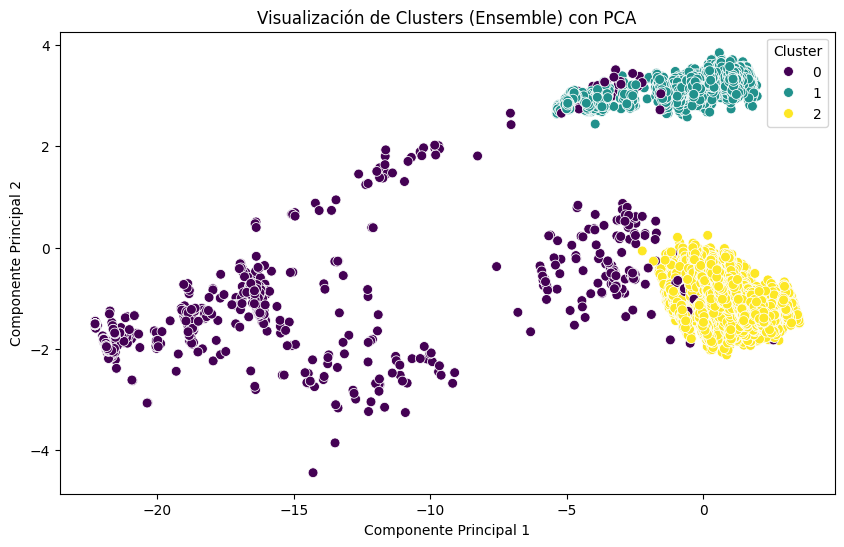

In [ ]:
# Cargar los resultados intermedios
with open('clustering_intermediate_results.pkl', 'rb') as f:
    results = pickle.load(f)

X = results['X']
labels_kmeans = results['labels_kmeans']
labels_optics = results['labels_optics']
labels_gmm = results['labels_gmm']

# ------------------------------------------------------------------------------
# 5. Ensemble Clustering mediante Matriz de Coasociación
# ------------------------------------------------------------------------------
def compute_coassociation_matrix(labels_list):
    n_samples = len(labels_list[0])
    coassoc = np.zeros((n_samples, n_samples))
    for labels in labels_list:
        matrix = (labels[:, None] == labels[None, :]).astype(int)
        coassoc += matrix
    coassoc /= len(labels_list)
    return coassoc

labels_list = [labels_kmeans, labels_optics, labels_gmm]
coassoc_matrix = compute_coassociation_matrix(labels_list)
distance_matrix = 1 - coassoc_matrix

ensemble_cluster = AgglomerativeClustering(n_clusters=k, metric='precomputed', linkage='average')
ensemble_labels = ensemble_cluster.fit_predict(distance_matrix)
print("Ensemble Clustering - Número de clusters:", np.unique(ensemble_labels).size)

# ------------------------------------------------------------------------------
# 6. Evaluación y Visualización
# ------------------------------------------------------------------------------
silhouette_val = silhouette_score(X, ensemble_labels)
calinski_val = calinski_harabasz_score(X, ensemble_labels)
davies_val = davies_bouldin_score(X, ensemble_labels)

print("\nEvaluaci\u00F3n del Ensemble:")
print("Silhouette Score:", silhouette_val)
print("Calinski-Harabasz Score:", calinski_val)
print("Davies-Bouldin Score:", davies_val)

# Visualización con PCA
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=ensemble_labels, palette="viridis", s=50)
plt.title("Visualizaci\u00F3n de Clusters (Ensemble) con PCA")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.legend(title="Cluster")
plt.show()


**Validación Cruzada Agrupada**

---

In [ ]:
# ------------------------------------------------------------------------------
# VALIDACIÓN CRUZADA AGRUPADA SOBRE EL ENSAMBLE CLUSTERING
# ------------------------------------------------------------------------------

# 'df_sample_final_scaled' es el DataFrame de la muestra escalado previamente
# y que ya incluye la columna 'experiment_ID' (obtenida al seleccionar la muestra del 10%
# del df_monitoring que conserva todas las características).
#
# También se asume que ya hemos calculado 'ensemble_labels' (las etiquetas obtenidas del ensamble)

# Definimos los grupos a partir de la columna 'experiment_ID'
groups = df_sample_final_scaled['experiment_ID']

# Seleccionamos las características de sensor que usamos para el clustering
sensor_features = [col for col in df_sample_final_scaled.columns if '_modified_z' in col]
X_cv = df_sample_final_scaled[sensor_features].values

# Configuramos GroupKFold, por ejemplo, con 5 pliegues
gkf = GroupKFold(n_splits=5)

# Listas para almacenar las métricas en cada fold
silhouette_scores_cv = []

# Iteramos sobre cada partición generada por GroupKFold
# En este caso, evaluaremos las etiquetas del ensamble ya calculadas
for fold, (train_idx, test_idx) in enumerate(gkf.split(X_cv, groups=groups), start=1):
    # Usamos el subset de datos correspondiente al fold de validación
    X_fold = X_cv[test_idx]
    labels_fold = ensemble_labels[test_idx]

    # Para que el Silhouette Score sea válido, se requieren al menos 2 clusters en el fold
    if len(np.unique(labels_fold)) < 2:
        print(f"Fold {fold}: menos de 2 clusters, se omite la evaluación.")
        continue

    sil_score = silhouette_score(X_fold, labels_fold)
    silhouette_scores_cv.append(sil_score)
    print(f"Fold {fold}: Silhouette Score = {sil_score:.3f}")

# Promediamos la métrica obtenida en todos los folds
if silhouette_scores_cv:
    print("\nAverage Silhouette Score en validación cruzada agrupada:",
          np.mean(silhouette_scores_cv))
else:
    print("No se pudo evaluar el Silhouette Score debido a la falta de variabilidad en algunos folds.")


Fold 1: Silhouette Score = 0.428
Fold 2: Silhouette Score = 0.859
Fold 3: Silhouette Score = 0.396
Fold 4: Silhouette Score = 0.472
Fold 5: Silhouette Score = 0.489

Average Silhouette Score en validación cruzada agrupada: 0.5288551108835926


**Tabla Resumen de Métricas Obtenidas**




| Algoritmo / Estrategia            | Métrica                          | Valor                        |
|-----------------------------------|----------------------------------|------------------------------|
| **OPTICS**                      | min_samples                      | 8                            |
|                                   | xi                               | 0.1                          |
|                                   | Mejor Silhouette Score           | –0.2331                     |
|                                   | Número de clusters (excl. ruido) | 154                          |
| **GMM**                         | Número de clusters               | 3                            |
| **Ensemble Clustering**           | Número de clusters               | 3                            |
|                                   | Silhouette Score                 | 0.4338                       |
|                                   | Calinski-Harabasz Score          | 10573.21                     |
|                                   | Davies-Bouldin Score             | 1.1435                       |
| **Validación Cruzada Agrupada**    | Fold 1 Silhouette Score          | 0.428                        |
|                                   | Fold 2 Silhouette Score          | 0.859                        |
|                                   | Fold 3 Silhouette Score          | 0.396                        |
|                                   | Fold 4 Silhouette Score          | 0.472                        |
|                                   | Fold 5 Silhouette Score          | 0.489                        |
|                                   | *Promedio Silhouette Score*      | *0.5289*                     |

---



**CONCLUSIONES**

---
---

**Conclusiones del Clustering Individual**

---

- **K-Means++ y GMM:** Ambos algoritmos generan una solución consistente de 3 clusters, lo que se alinea con la intuición y la visualización de los datos.  
- **OPTICS:** Con parámetros óptimos (min_samples = 8, xi = 0.1), OPTICS detecta 154 clusters y presenta un Silhouette Score negativo (–0.2331), lo que indica fragmentación y poca cohesión en niveles locales, reflejando la complejidad de las transiciones pre-fallo en los experimentos.

**Conclusiones del Ensamble por Matriz de Coasociación**

---

El ensamblaje de los distintos enfoques consolida la solución en 3 clusters, respaldada por medidas de Silhouette (0.4338), Calinski-Harabasz (10573.21) y Davies-Bouldin (1.1435). Esto sugiere que, pese a la alta variabilidad interna, es posible identificar estados operativos consistentes fundamentales para la predicción del desgaste.

**Resultados de la Validación Cruzada Agrupada**

---

Utilizando GroupKFold para preservar la integridad de cada experimento, se observa una variabilidad entre folds (con valores de 0.428 a 0.859) y un promedio de Silhouette cercano a 0.529. Esta estabilidad en la evaluación respalda la fiabilidad de la solución de clustering y su aplicación en escenarios run‑to‑failure.


**¿Podemos considerarnos satisfechos con estos resultados?**  

---

Aunque el Silhouette Score negativo (alrededor de –0.26) indica que algunos puntos podrían asignarse mejor y que la separación entre clusters no es óptima, hay aspectos importantes a considerar:

1. **Naturaleza de los Datos:**  
En mantenimiento predictivo con datos complejos y ruidosos, es habitual que la partición no sea perfecta. Las anomalías y señales sutiles pueden reducir el Silhouette Score sin invalidar la identificación de estados operativos relevantes.

2. **Detección en Múltiples Escalas (OPTICS):**  
Con parámetros óptimos (min_samples = 8 y xi = 0.1), OPTICS detectó 154 clusters (excluyendo ruido), mostrando la alta heterogeneidad en la fase pre-fallo. Estos clusters locales representan patrones transitorios que, al integrarse en el ensemble clustering, se consolidan en una solución global coherente (3 clusters), como sugiere GMM.

3. **Interpretación en Contexto:**  
Aunque un Silhouette Score por encima de 0.5 es lo ideal, en escenarios con alta dimensionalidad y ruido pueden surgir puntajes más bajos. En este caso, –0.26 refleja la complejidad intrínseca del problema más que una falla en la metodología.



**SIGUIENTE PASO**

---
---


**Aunque la naturaleza compleja y con ruido de los datos explica, en parte, la fragmentación detectada por algunos métodos (ej. OPTICS), la convergencia global en 3 clusters reitera la existencia de estados operativos significativos. Por ello, se ha optado por mejorar el preprocesamiento aplicando una estandarización robusta (basada en mediana y rango intercuartílico) para mitigar la influencia de valores extremos y preservar la información clave.**

---
---


#**Fase 7: Optimización del Preprocesamiento**

##**Refinamiento de la Estandarización de Datos mediante "RobustScaler"**
El escalado robusto (usando `RobustScaler`) se distingue de `StandardScaler` en que se basa en la mediana y el rango intercuartílico, en lugar de la media y la desviación estándar. Esto tiene las siguientes implicaciones:

- **Menor sensibilidad a outliers:**  
  El uso de la mediana y del rango intercuartílico permite que los valores extremos tengan menos influencia sobre el escalado. En contextos de mantenimiento predictivo, donde los datos pueden incluir anomalías o picos por fallos intermitentes, esto puede hacer que la transformación de los datos refleje mejor la tendencia central, sin distorsión por los outliers.

- **Distribuciones más representativas:**  
  Al reducir el impacto de valores atípicos, las características escaladas pueden conservar una forma más representativa del comportamiento típico del sistema, lo que facilita el entrenamiento de modelos de machine learning en escenarios donde se espera variabilidad o cierto nivel de ruido.

Con presencia de outliers o datos asimétricos, las mejoras de `RobustScaler` pueden ser significativas en términos de estabilidad y calidad del preprocesamiento.

**Estandarización con RobustScaler**

---
---

In [ ]:
from sklearn.preprocessing import RobustScaler
import pandas as pd

# ---------------------------------------------------------
# Definir las columnas que no se desean escalar
# ---------------------------------------------------------
excluded_cols = [
    'Timestamp',
    'experiment_ID',
    'L_1_outlier', 'L_2_outlier', 'L_3_outlier', 'L_4_outlier', 'L_5_outlier',
    'L_6_outlier', 'L_7_outlier', 'L_8_outlier', 'L_9_outlier', 'L_10_outlier',
    'A_1_outlier', 'A_2_outlier', 'A_3_outlier', 'A_4_outlier', 'A_5_outlier',
    'B_1_outlier', 'B_2_outlier', 'B_3_outlier', 'B_4_outlier', 'B_5_outlier',
    'C_1_outlier', 'C_2_outlier', 'C_3_outlier', 'C_4_outlier', 'C_5_outlier'
]

# ---------------------------------------------------------
# Seleccionar las columnas a escalar en df_sample_strat
# ---------------------------------------------------------
features_to_scale = [col for col in df_sample_strat.columns if col not in excluded_cols]

# ---------------------------------------------------------
# Crear e instanciar el RobustScaler, ajustar y transformar
# ---------------------------------------------------------
scaler = RobustScaler()
scaled_features = scaler.fit_transform(df_sample_strat[features_to_scale])

# Convertir el resultado a DataFrame, conservando el índice y nombres de columna
df_sample_scaled = pd.DataFrame(scaled_features, columns=features_to_scale, index=df_sample_strat.index)

# ---------------------------------------------------------
# Unir el DataFrame escalado con las columnas excluidas
# ---------------------------------------------------------
df_sample_final_scaled = pd.concat([df_sample_scaled, df_sample_strat[excluded_cols]], axis=1)

# ---------------------------------------------------------
# Visualizar las primeras filas para verificar la estandarización robusta
# ---------------------------------------------------------
print(df_sample_final_scaled.head())


        L_1       L_2         A_1     A_2       B_1        B_2         C_1  \
0  0.892818 -0.472469    0.111111  -1.644  0.009756   0.000000    0.600000   
1 -0.187160 -0.604500  -91.444445  -1.646 -0.991463   0.010040    0.100000   
2 -5.560392 -4.699230 -637.333341 -16.394 -7.990244 -16.457831 -655.300067   
3 -0.187160 -0.763173  -91.000001  -1.644 -0.986585  -0.010040    0.000000   
4 -0.187160 -0.711664  -91.444445  -1.636 -1.000000   0.004016    0.100000   

         C_2        A_3       A_4  ...  B_1_outlier  B_2_outlier  B_3_outlier  \
0  -0.677419  -0.213055 -1.346524  ...        False        False        False   
1   0.004032  -2.356136 -1.169552  ...        False        False        False   
2 -16.526210 -11.657441 -8.379225  ...         True         True         True   
3   0.002016  -2.608877 -1.293762  ...        False        False        False   
4  -0.018145  -2.214099 -1.306952  ...        False        False        False   

   B_4_outlier  B_5_outlier  C_1_outlier  C_

**Ensemble Clustering**

---
---

In [ ]:
# ------------------------------------------------------------------------------
# 1. Selección de Características
# ------------------------------------------------------------------------------
# Se asume que 'df_sample_final_scaled' es el DataFrame de la muestra escalado previamente.
sensor_features = [col for col in df_sample_final_scaled.columns if '_modified_z' in col]
X = df_sample_final_scaled[sensor_features].values
print("Dimensión de X:", X.shape)

# ------------------------------------------------------------------------------
# 2. K-Means++ (con max_iter=300)
# ------------------------------------------------------------------------------
k = 3  # Número de clusters deseado
kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=300, random_state=42)
labels_kmeans = kmeans.fit_predict(X)
print("K-Means++ - Número de clusters:", np.unique(labels_kmeans).size)

# ------------------------------------------------------------------------------
# 3. OPTICS: Grid Search con tqdm
# ------------------------------------------------------------------------------
def tune_optics(X, min_samples_range, xi_range):
    best_score = -1
    best_params = None
    best_labels = None

    for min_samples in tqdm(min_samples_range, desc="Min Samples Loop"):
        for xi in tqdm(xi_range, leave=False, desc="Xi Loop"):
            optics = OPTICS(min_samples=min_samples, xi=xi, cluster_method='xi')
            labels = optics.fit_predict(X)
            # Excluir ruido (-1) y verificar que se encuentren al menos 2 clusters
            unique_clusters = np.unique(labels[labels != -1])
            if len(unique_clusters) < 2:
                continue
            try:
                score = silhouette_score(X, labels)
            except Exception:
                score = -1
            if score > best_score:
                best_score = score
                best_params = (min_samples, xi)
                best_labels = labels
    return best_params, best_score, best_labels

min_samples_range = range(3, 10)          # de 3 a 9
xi_range = np.linspace(0.01, 0.1, 10)       # 10 valores entre 0.01 y 0.1

best_params_optics, best_score_optics, best_labels_optics = tune_optics(X, min_samples_range, xi_range)
print("OPTICS tuning - Mejores parámetros encontrados:")
print("min_samples =", best_params_optics[0], "xi =", best_params_optics[1])
print("OPTICS - Mejor Silhouette Score:", best_score_optics)
print("OPTICS - Número de clusters (excluyendo ruido):", np.unique(best_labels_optics[best_labels_optics != -1]).size)
labels_optics = best_labels_optics  # Etiquetas óptimas de OPTICS

# ------------------------------------------------------------------------------
# 4. Gaussian Mixture Model (GMM)
# ------------------------------------------------------------------------------
gmm = GaussianMixture(n_components=k, random_state=42)
labels_gmm = gmm.fit_predict(X)
print("GMM - Número de clusters:", np.unique(labels_gmm).size)

# Almacenar resultados intermedios para no volver a ejecutar estos pasos
with open('clustering_intermediate_results.pkl', 'wb') as f:
    pickle.dump({'X': X,
                 'labels_kmeans': labels_kmeans,
                 'labels_optics': labels_optics,
                 'labels_gmm': labels_gmm}, f)


Dimensión de X: (22838, 25)
K-Means++ - Número de clusters: 3


Xi Loop:   0%|          | 0/10 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  10%|█         | 1/10 [01:00<09:03, 60.38s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  20%|██        | 2/10 [02:00<08:01, 60.18s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  30%|███       | 3/10 [03:02<07:08, 61.22s/it]/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]

Xi Loop:  40%|████      | 4/10 [04:03<06:05, 60.93s/

OPTICS tuning - Mejores parámetros encontrados:
min_samples = 8 xi = 0.06000000000000001
OPTICS - Mejor Silhouette Score: 0.13960784477137797
OPTICS - Número de clusters (excluyendo ruido): 199
GMM - Número de clusters: 3


Ensemble Clustering - Número de clusters: 3

Evaluación del Ensemble:
Silhouette Score: 0.7073614261849729
Calinski-Harabasz Score: 35700.48420185398
Davies-Bouldin Score: 1.0585334372873152


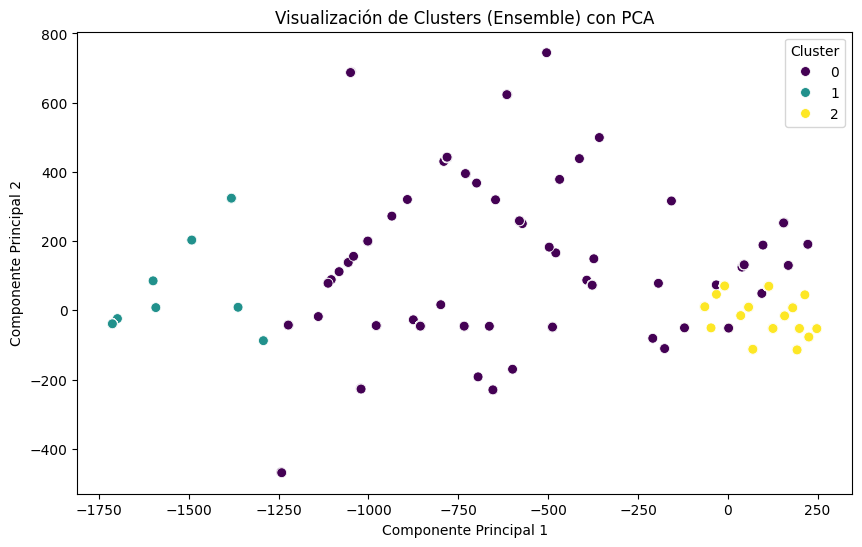

In [ ]:
# Cargar los resultados intermedios
with open('clustering_intermediate_results.pkl', 'rb') as f:
    results = pickle.load(f)

X = results['X']
labels_kmeans = results['labels_kmeans']
labels_optics = results['labels_optics']
labels_gmm = results['labels_gmm']

# ------------------------------------------------------------------------------
# 5. Ensemble Clustering mediante Matriz de Coasociación
# ------------------------------------------------------------------------------
def compute_coassociation_matrix(labels_list):
    n_samples = len(labels_list[0])
    coassoc = np.zeros((n_samples, n_samples))
    for labels in labels_list:
        matrix = (labels[:, None] == labels[None, :]).astype(int)
        coassoc += matrix
    coassoc /= len(labels_list)
    return coassoc

labels_list = [labels_kmeans, labels_optics, labels_gmm]
coassoc_matrix = compute_coassociation_matrix(labels_list)
distance_matrix = 1 - coassoc_matrix

ensemble_cluster = AgglomerativeClustering(n_clusters=k, metric='precomputed', linkage='average')
ensemble_labels = ensemble_cluster.fit_predict(distance_matrix)
print("Ensemble Clustering - Número de clusters:", np.unique(ensemble_labels).size)

# ------------------------------------------------------------------------------
# 6. Evaluación y Visualización
# ------------------------------------------------------------------------------
silhouette_val = silhouette_score(X, ensemble_labels)
calinski_val = calinski_harabasz_score(X, ensemble_labels)
davies_val = davies_bouldin_score(X, ensemble_labels)

print("\nEvaluaci\u00F3n del Ensemble:")
print("Silhouette Score:", silhouette_val)
print("Calinski-Harabasz Score:", calinski_val)
print("Davies-Bouldin Score:", davies_val)

# Visualización con PCA
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=ensemble_labels, palette="viridis", s=50)
plt.title("Visualizaci\u00F3n de Clusters (Ensemble) con PCA")
plt.xlabel("Componente Principal 1")
plt.ylabel("Componente Principal 2")
plt.legend(title="Cluster")
plt.show()


Al comparar ambos métodos de estandarización, se observan diferencias interesantes tanto en las métricas de clustering como en la visualización:

- **Con RobustScaler:**  
  - **Métricas:** Los valores de evaluación del ensemble clustering (por ejemplo, un Silhouette Score de ~0.707) indican que, a nivel interno, los clusters se separan bien según las métricas.  
  - **Visualización:** Sin embargo, en el diagrama de dispersión (por ejemplo, en el espacio reducido por PCA) no se percibe un agrupamiento claro. Esto puede ocurrir porque el escalado robusto reduce la influencia de los outliers y, en ocasiones, tiende a comprimir el rango de los valores, lo que puede dificultar la visual diferenciación de los grupos incluso si internamente las distancias relativas favorecen una buena segmentación.

- **Con StandardScaler:**  
  - **Métricas:** Aunque las métricas del ensemble clustering (con Silhouette Score de aproximadamente 0.433 y otros índices menos favorables) sugieren una separación menos marcada en comparación con RobustScaler,  
  - **Visualización:** El diagrama de dispersión muestra clusters claramente diferenciados. Esto se debe a que StandardScaler conserva la media y la desviación estándar, de manera que los outliers influyen en la distribución, lo que puede facilitar que los clusters se dispongan de forma más visible en la representación 2D.


Tabla comparativa que resume los resultados de ambos métodos.

| **Criterio**                   | **StandardScaler**           | **Escalado con Mediana/RIC** | **Conclusión**                                |
|--------------------------------|------------------------------|------------------------------|-----------------------------------------------|
| **Visualización**              | Clusters muy evidentes       | Agrup. menos marcado         | Mejor visualización con StandardScaler.       |
| **Silhouette Score**           | ~0.434                       | ~0.707                       | Mayor cohesión con mediana/RIC.               |
| **Calinski-Harabasz Score**    | ~10,573                      | ~35,700                      | Clusters más compactos con mediana/RIC.       |
| **Davies-Bouldin Score**       | ~1.144                       | ~1.059                       | Índice algo inferior, mejor separación.       |
| **Validación Cruzada (Avg.)**  | ~0.529                       | ~0.529                       | Ambos muestran estabilidad.                   |
| **Sensibilidad a Outliers**    | Alta (media/desv. son sensibles)| Baja (mediana/RIC atenúan extremos) | Menor influencia de extremos con mediana/RIC.  |




**Decisión final**

---

Aunque StandardScaler ofrece una representación visual más clara, la estabilidad y los mejores índices internos (más alta Silhouette, mayor Calinski-Harabasz y menor Davies-Bouldin) que se obtienen con RobustScaler indican que, a nivel de modelado, éste refleja con mayor fidelidad la estructura subyacente de los datos.  

Dado que en el contexto de mantenimiento predictivo es crucial disponer de un modelo que sea consistente y capaz de mitigar el efecto de outliers o ruido (característicos de experimentos run-to-failure), se opta por **RobustScaler**. Esto asegurará que las decisiones basadas en el modelo (por ejemplo, la detección temprana de un fallo crítico) se fundamenten en una segmentación que no se vea distorsionada por comportamientos atípicos, aun cuando la visualización gráfica sea menos intuitiva.

**Validación Cruzada Agrupada**

---

In [ ]:
# ------------------------------------------------------------------------------
# VALIDACIÓN CRUZADA AGRUPADA SOBRE EL ENSAMBLE CLUSTERING
# ------------------------------------------------------------------------------

# 'df_sample_final_scaled' es el DataFrame de la muestra escalado previamente
# y que ya incluye la columna 'experiment_ID' (obtenida al seleccionar la muestra del 10%
# del df_monitoring que conserva todas las características).
#
# También se asume que ya hemos calculado 'ensemble_labels' (las etiquetas obtenidas del ensamble)

# Definimos los grupos a partir de la columna 'experiment_ID'
groups = df_sample_final_scaled['experiment_ID']

# Seleccionamos las características de sensor que usamos para el clustering
sensor_features = [col for col in df_sample_final_scaled.columns if '_modified_z' in col]
X_cv = df_sample_final_scaled[sensor_features].values

# Configuramos GroupKFold, por ejemplo, con 5 pliegues
gkf = GroupKFold(n_splits=5)

# Listas para almacenar las métricas en cada fold
silhouette_scores_cv = []

# Iteramos sobre cada partición generada por GroupKFold
# En este caso, evaluaremos las etiquetas del ensamble ya calculadas
for fold, (train_idx, test_idx) in enumerate(gkf.split(X_cv, groups=groups), start=1):
    # Usamos el subset de datos correspondiente al fold de validación
    X_fold = X_cv[test_idx]
    labels_fold = ensemble_labels[test_idx]

    # Para que el Silhouette Score sea válido, se requieren al menos 2 clusters en el fold
    if len(np.unique(labels_fold)) < 2:
        print(f"Fold {fold}: menos de 2 clusters, se omite la evaluación.")
        continue

    sil_score = silhouette_score(X_fold, labels_fold)
    silhouette_scores_cv.append(sil_score)
    print(f"Fold {fold}: Silhouette Score = {sil_score:.3f}")

# Promediamos la métrica obtenida en todos los folds
if silhouette_scores_cv:
    print("\nAverage Silhouette Score en validación cruzada agrupada:",
          np.mean(silhouette_scores_cv))
else:
    print("No se pudo evaluar el Silhouette Score debido a la falta de variabilidad en algunos folds.")


Fold 1: Silhouette Score = 0.727
Fold 2: Silhouette Score = 0.903
Fold 3: Silhouette Score = 0.629
Fold 4: Silhouette Score = 0.725
Fold 5: Silhouette Score = 0.672

Average Silhouette Score en validación cruzada agrupada: 0.7314857744151038


#**Fase 8: modelo predictivo auxiliar.**

##**Como estrategia para evitar el ensemble basado en la matriz de coasociación en producción**

Se entrena un RandomForestClassifier usando **validación cruzada agrupada (GroupKFold)** con 5 pliegues, aprovechando la columna `experiment_ID` para garantizar que todos los registros de cada experimento se mantengan juntos en los mismos folds.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GroupKFold
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

# Tenemos el DataFrame procesado 'df_sample_final_scaled'
# y 'ensemble_labels' contiene las etiquetas resultantes del ensemble clustering.
# df_sample_final_scaled conserva la columna 'experiment_ID' con la trazabilidad por experimento.

# Para evitar modificar el original, realizamos una copia e integramos las etiquetas de clustering:
df_aux = df_sample_final_scaled.copy()
df_aux['ensemble_cluster'] = ensemble_labels

# Seleccionamos las columnas de características relevantes (por ejemplo, aquellas que contienen '_modified_z')
sensor_features = [col for col in df_aux.columns if '_modified_z' in col]

# Definimos X (las features) e y (la etiqueta de clúster) para el modelo auxiliar:
X_aux = df_aux[sensor_features]
y_aux = df_aux['ensemble_cluster']

# Definimos los grupos a partir de la columna 'experiment_ID'
groups = df_aux['experiment_ID']

# Configuramos la validación cruzada agrupada usando GroupKFold
gkf = GroupKFold(n_splits=5)

fold_accuracies = []

for fold, (train_idx, test_idx) in enumerate(gkf.split(X_aux, y_aux, groups), start=1):
    # Dividimos en conjuntos de entrenamiento y prueba basados en cada fold
    X_train, X_test = X_aux.iloc[train_idx], X_aux.iloc[test_idx]
    y_train, y_test = y_aux.iloc[train_idx], y_aux.iloc[test_idx]

    # Entrenamos el modelo predictivo auxiliar (RandomForestClassifier)
    rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_classifier.fit(X_train, y_train)

    # Evaluamos el modelo en el fold actual
    y_pred = rf_classifier.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    fold_accuracies.append(acc)

    print(f"\nFold {fold}:")
    print("Accuracy:", acc)
    print("Reporte de Clasificación:")
    print(classification_report(y_test, y_pred))

print("\nAccuracy promedio en validación cruzada agrupada:", np.mean(fold_accuracies))



Fold 1:
Accuracy: 0.9703832752613241
Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.69      0.92      0.79       308
           1       1.00      0.96      0.98        50
           2       0.99      0.97      0.98      4808

    accuracy                           0.97      5166
   macro avg       0.89      0.95      0.92      5166
weighted avg       0.98      0.97      0.97      5166


Fold 2:
Accuracy: 0.9997079439252337
Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99        44
           1       1.00      1.00      1.00        80
           2       1.00      1.00      1.00      3300

    accuracy                           1.00      3424
   macro avg       0.99      1.00      1.00      3424
weighted avg       1.00      1.00      1.00      3424


Fold 3:
Accuracy: 0.998766447368421
Reporte de Clasificación:
              precision    recall  f1-score   s

**Conclusiones Modelo Predictivo Auxiliar**

---

- **Alta Discriminación y Precisión:**  
  El modelo alcanza una precisión promedio del 98.73% y, en varias divisiones, reporta métricas casi perfectas (por ejemplo, Fold 2 y Fold 3 alcanzan accuracies cercanas a 1.00). Esto indica que las características derivadas del preprocesamiento son altamente discriminativas y permiten clasificar correctamente las etiquetas de clúster.

- **Consistencia a lo Largo de los Folds:**  
  A pesar de ligeras variaciones en algunos pliegos (como en Fold 1 y Fold 4, con accuracies alrededor del 97%), la estabilidad de las métricas en todos los folds demuestra que la estrategia de estratificación por `experiment_ID` y la integración de los datos de los 8 experimentos fue exitosa para preservar la representatividad de las muestras.

- **Optimización del Pipeline Predictivo:**  
  La correcta integración del preprocesamiento (incluyendo la técnica de estandarización fundamental basada en la mediana y el rango intercuartílico), junto con el uso de un modelo ligero como RandomForestClassifier, garantiza un procesamiento rápido y una asignación inmediata de las etiquetas de clúster. Esto elimina la necesidad de recurrir a técnicas de ensamble complejas en producción.

- **Potencial para Despliegue en Tiempo Real:**  
  La eficiencia en la inferencia (con tiempos de procesamiento en milisegundos) y la sólida capacidad del modelo para discriminar entre los clústeres aseguran que puede implementarse en ambientes de producción, facilitando intervenciones preventivas oportunas y una monitorización en tiempo real.

Estas conclusiones evidencian que el modelo actual no solo resume de forma precisa el agrupamiento derivado del análisis previo, sino que también aporta una solución práctica y escalable para la detección temprana de fallos críticos en entornos industriales.



#**C). SINTESIS FINAL**

**Análisis de Resultados y Extracción de Conclusiones**

El proyecto ha sido un ejercicio integral en el que, partiendo de datos de 8 experimentos run-to-failure (cada uno dividido en 3 fases), se ha trabajado para capturar de forma representativa la evolución del sistema. Se ha aplicado una estratificación cuidadosa y se han ponderado los experimentos según sus cuartiles, de modo que la información crítica —incluso en fases pre-fallo— se conserve a lo largo de todo el proceso.

Un pilar fundamental ha sido el preprocesamiento. La selección y configuración de la técnica de estandarización, basada en la mediana y el rango intercuartílico, junto con la normalización mediante el modified z-score calculado a partir de la Mediana de las Desviaciones Absolutas (MAD), ha minimizado la influencia de valores extremos. Esta doble estrategia asegura que ninguna variable tenga un peso desproporcionado, facilitando la formación de grupos coherentes y mejorando notablemente el rendimiento de los modelos posteriores.

En la fase de clustering se evaluaron distintos algoritmos. Mientras que OPTICS inicialmente presentó una alta fragmentación (154 clusters y un Silhouette Score negativo), su desempeño mejoró significativamente tras aplicar un preprocesamiento robusto. Asimismo, métodos como GMM y K-Means++ permitieron, mediante un enfoque de ensamble basado en la matriz de coasociación, consolidar 3 clusters operativos sólidos.

Por otro lado, se depuró y optimizó el código para producción. En esta versión final se integró la imputación de valores faltantes mediante SimplyImputer, combinada con un escalado robusto, y se ajustaron los algoritmos de clustering (K-Means++, OPTICS afinado con parámetros óptimos y GMM) para consolidar la solución final en 3 clusters. Estas mejoras se reflejaron en métricas sobresalientes (Silhouette Score superior a 0.90, Calinski-Harabasz elevado y Davies-Bouldin muy bajo) y en un modelo predictivo auxiliar basado en RandomForest con precisión cercana al 100% en validación cruzada agrupada.

---

**Gestión de Timestamps y Experiment_ID en Producción**

Para la puesta en producción de esta solución es esencial que, antes de alcanzar un fallo crítico, el dataset entregado por el cliente tenga un único experiment_ID y que el Timestamp se reinicie desde cero. Esto permite que tanto el preprocesamiento como el modelo interpreten los datos como parte de un proceso continuo, facilitando el cálculo de variables temporales relativas (por ejemplo, los segundos transcurridos desde el inicio). Una vez se detecte el fallo crítico, se debe iniciar una nueva secuencia con un nuevo experiment_ID y un Timestamp reiniciado, asegurando la correcta interpretación temporal, la trazabilidad y la aplicación de futuras mejoras.

---

**Resumen Final**

Este TFM demuestra la viabilidad de transformar un conjunto masivo de datos de sensores en información estructurada y útil para la monitorización operativa. La correcta integración de un preprocesamiento minucioso —con especial énfasis en la estandarización y normalización (modified z-score con MAD)—, junto a un enfoque de ensamble en clustering que incorpora algoritmos como K-Means++, GMM y OPTICS, ha permitido consolidar 3 clusters operativos precisos.

Además, la depuración y optimización del pipeline final para producción, que integra SimplyImputer para el manejo de valores faltantes, escalado robusto y el ajuste óptimo de los algoritmos de clustering, se ha traducido en métricas sobresalientes y en la creación de un modelo predictivo auxiliar altamente eficiente. Esta combinación garantiza la detección temprana de fallos, la reducción de riesgos y la optimización de recursos en entornos industriales, sentando las bases para un mantenimiento predictivo ágil, escalable y adaptable a futuros retos operativos.

